<a href="https://colab.research.google.com/github/YeeunKang99/ITB2022/blob/main/ITB_Project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 여가시간에 "운동 활동"을 하도록 만드는 마케팅 방안 도출
##### <데이터 분석 목적>
최근 한국인의 신체활동과 관련된 논문에 따르면 2020년 우리나라 성인의 신체활동 부족 비율은 54.4%로, 성인의 절반 이상이 신체활동 부족 상태임을 알 수 있다. 이는 즉, 신체활동을 수행할 수 있는 능력인 체력이 저하되고 있다는 것을 의미한다. 따라서 본조는 1. 성인의 체력 측정 데이터를 분석하여 어떤 타겟에게 운동을 장려하는 것이 가장 효과적일지 알아보고, 2. 여가시간 관련 데이터를 분석하여 타겟을 대상으로 여가시간에 "운동 활동"을 하도록 만드는 마케팅 방안을 도출하고자 한다.



# 1. 어떤 집단에게 "운동 활동"이 가장 필요한지 알아보자

## [1] 데이터 분석 배경

### (1) 데이터 분석 목적
여가시간에 "운동 활동"을 하도록 만드는 마케팅 방안을 도출하기 위해서는, 적절한 타겟 설정이 필요하다. 따라서 본조는 먼저 성인의 체력 측정 데이터를 분석하여 어떤 타겟에게 운동을 장려하는 것인 가장 효과적일지 알아보고자 한다.

### (2) 데이터 분석 과정
- 체력 측정 데이터를 군집화한다.
 - 성별에 따라 두 집단으로 나눈다.
- 군집별로 특징을 파악한다.
 - '상장구분’과 ‘나이대’에 따라 나머지 변수들을 분석해본다.


### (3) 사용하고자 하는 데이터
'문화 빅데이터 플랫폼'사이트의 데이터를 이용했다. 사용할 데이터는 **'체력측정 항목별 측정 데이터'**로 2022년1~5월 데이터를 사용한다.
- 데이터 설명
 - 서울올림픽기념 국민체육진흥공단에서 관리하고 있는 국민체력측정데이터의 항목별 측정 정보를 제공하는 데이터이다.
 - 체력측정 센터명, 연령대, 신장, 체중, 윗몸일으키기, BMI, 앉아윗몸앞으로굽히기 등의 체력측정 항목별 결과를 포함한다.


## [2] 데이터 전처리


### (1) 데이터 병합
- 2022년 1월 ~ 5월 데이터 병합

In [ ]:
!pip install mglearn 
!pip install --upgrade joblib==1.1.0

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 540 kB 5.1 MB/s 
  Created wheel for mglearn: filename=mglearn-0.1.9-py2.py3-none-any.whl size=582637 sha256=20af88a2ca789e81e1678a6ed07c368ff5f0cac135d9c1cf236d7d2e57ef4926
  Stored in directory: /root/.cache/pip/wheels/87/75/37/404e66d0c4bad150f101c9a0914b11a8eccc2681559936e7f7
Successfully built mglearn
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 306 kB 2.5 MB/s 
  Attempting uninstall: joblib
    Found existing installation: joblib 1.2.0
    Uninstalling joblib-1.2.0:
      Successfully uninstalled joblib-1.2.0


In [ ]:
'''
#나눔고딕 설치
!apt-get update -qq
!apt-get install fonts-nanum* -qq
'''
!sudo apt-get install -y fonts-nanum
!sudo fc-cache -fv
!rm ~/.cache/matplotlib -rf

Reading package lists... Done
Building dependency tree       
Reading state information... Done
The following package was automatically installed and is no longer required:
  libnvidia-common-460
Use 'sudo apt autoremove' to remove it.
The following NEW packages will be installed:
  fonts-nanum
0 upgraded, 1 newly installed, 0 to remove and 7 not upgraded.
Need to get 9,604 kB of archives.
After this operation, 29.5 MB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu bionic/universe amd64 fonts-nanum all 20170925-1 [9,604 kB]
Fetched 9,604 kB in 0s (23.6 MB/s)
debconf: unable to initialize frontend: Dialog
debconf: (No usable dialog-like program is installed, so the dialog based frontend cannot be used. at /usr/share/perl5/Debconf/FrontEnd/Dialog.pm line 76, <> line 1.)
debconf: falling back to frontend: Readline
debconf: unable to initialize frontend: Readline
debconf: (This frontend requires a controlling tty.)
debconf: falling back to frontend: Teletype


In [ ]:
%matplotlib inline
import matplotlib as mpl                
import matplotlib.font_manager as fm   
import pandas as pd
import seaborn as sns           
import matplotlib.pyplot as plt 
import numpy as np
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import silhouette_samples, silhouette_score 
from sklearn.metrics import davies_bouldin_score
from yellowbrick.cluster import SilhouetteVisualizer
import mglearn


In [ ]:
mpl.rcParams['axes.unicode_minus'] = False  ## 마이너스 부호가 깨지는 것 방지 

path = '/usr/share/fonts/truetype/nanum/NanumBarunGothic.ttf'
font_name = fm.FontProperties(fname=path, size=11).get_name()
print(font_name)

plt.rc('font', family=font_name)

NanumBarunGothic


In [ ]:
print(mpl.rcParams['font.family'])

['NanumBarunGothic']


In [ ]:
# 구글 드라이브 연결
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# 데이터 불러오기
ddf_1 = pd.read_csv("/content/drive/My Drive/Colab Notebooks/ITB_subject/KS_NFA_FTNESS_MESURE_ITEM_MESURE_INFO_202201.csv",  encoding = 'utf-8')
ddf_2 = pd.read_csv("/content/drive/My Drive/Colab Notebooks/ITB_subject/KS_NFA_FTNESS_MESURE_ITEM_MESURE_INFO_202202.csv",  encoding = 'utf-8')
ddf_3 = pd.read_csv("/content/drive/My Drive/Colab Notebooks/ITB_subject/KS_NFA_FTNESS_MESURE_ITEM_MESURE_INFO_202203.csv",  encoding = 'utf-8')
ddf_4 = pd.read_csv("/content/drive/My Drive/Colab Notebooks/ITB_subject/KS_NFA_FTNESS_MESURE_ITEM_MESURE_INFO_202204.csv",  encoding = 'utf-8')
ddf_5 = pd.read_csv("/content/drive/My Drive/Colab Notebooks/ITB_subject/KS_NFA_FTNESS_MESURE_ITEM_MESURE_INFO_202205.csv",  encoding = 'utf-8')

ddf_fit = pd.concat([ddf_1, ddf_2, ddf_3, ddf_4,ddf_5], ignore_index = True)

print(ddf_fit.info())
# print(ddf_fit.isnull().sum()) # 결측치 수


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 109184 entries, 0 to 109183
Data columns (total 50 columns):
 #   Column     Non-Null Count   Dtype  
---  ------     --------------   -----  
 0   TEST_CNT   109184 non-null  int64  
 1   CENTER_NM  109184 non-null  object 
 2   AGE_GBN    109184 non-null  object 
 3   TEST_GBN   109184 non-null  object 
 4   TEST_AGE   109184 non-null  int64  
 5   INPUT_GBN  106733 non-null  object 
 6   CERT_GBN   109184 non-null  object 
 7   TEST_YMD   109184 non-null  int64  
 8   TEST_SEX   109184 non-null  object 
 9   ITEM_F001  109174 non-null  float64
 10  ITEM_F002  109167 non-null  float64
 11  ITEM_F003  94736 non-null   float64
 12  ITEM_F004  59285 non-null   float64
 13  ITEM_F005  105162 non-null  float64
 14  ITEM_F006  105158 non-null  float64
 15  ITEM_F007  108913 non-null  float64
 16  ITEM_F008  108931 non-null  float64
 17  ITEM_F009  36332 non-null   float64
 18  ITEM_F010  28729 non-null   float64
 19  ITEM_F011  0 non-null  

In [ ]:
# 변수명을 한글로 변경
ddf_fit.columns = ['측정회차',
'센터명',
'나이구분',
'측정구분',
'나이',
'입력구분',
'상장구분',
'측정일',
'성별',
'신장',
'체중',
'체지방율',
'허리둘레',
'이완기혈압_최저',
'수축기혈압_최고',
'악력_주손',
'악력_비주손',
'윗몸말아올리기',
'반복점프',
'미정',
'앉아윗몸앞으로굽히기',
'일리노이',
'체공시간',
'협응력시간',
'협응력실수횟수',
'협응력계산결과값',
'BMI',
'교차윗몸일으키기',
'왕복오래달리기',
'10M4회왕복달리기',
'제자리멀리뛰기',
'의자에앉았다일어서기',
'6분걷기',
'2분제자리걷기',
'의자에앉아3M표적돌아오기',
'8자보행',
'상대악력',
'피두부겹합',
'왕복오래달리기_출력',
'트레드밀_안정시',
'트레드밀_3분',
'트레드밀_6분',
'트레드밀_9분',
'트레드밀_출력',
'스텝검사_회복시',
'스텝검사_출력',
'허벅지_좌',
'허벅지_우',
'전신반응',
'체공시간2']

In [ ]:
# 중복된 값 확인
dup = ddf_fit.duplicated()
print(dup.value_counts())
print("--------------------------")

# 중복된 행 제거
ddf_fit1 = ddf_fit.drop_duplicates()

False    109157
True         27
dtype: int64
--------------------------


In [ ]:
# ddf_fit1 확인
ddf_fit1.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 109157 entries, 0 to 109183
Data columns (total 50 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   측정회차           109157 non-null  int64  
 1   센터명            109157 non-null  object 
 2   나이구분           109157 non-null  object 
 3   측정구분           109157 non-null  object 
 4   나이             109157 non-null  int64  
 5   입력구분           106706 non-null  object 
 6   상장구분           109157 non-null  object 
 7   측정일            109157 non-null  int64  
 8   성별             109157 non-null  object 
 9   신장             109147 non-null  float64
 10  체중             109140 non-null  float64
 11  체지방율           94717 non-null   float64
 12  허리둘레           59271 non-null   float64
 13  이완기혈압_최저       105139 non-null  float64
 14  수축기혈압_최고       105135 non-null  float64
 15  악력_주손          108886 non-null  float64
 16  악력_비주손         108904 non-null  float64
 17  윗몸말아올리기        36320 non-null

### (2) 데이터 변수 생성, 결측치 제거, 20-60대 데이터 추출

In [ ]:
# 성별 값 변경
## F -> 0, M -> 1
ddf_fit1['성별'].replace(['F','M'], [0,1],inplace = True)

/usr/local/lib/python3.8/dist-packages/pandas/core/generic.py:6619: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return self._update_inplace(result)


In [ ]:
# 너무 많은 결측지 가지고 있는 변수와 필요없는 변수를 제외한 데이터(최소 3만~10만개 이상의 결측치를 가짐)
ddf_fit2 = ddf_fit1[[
'나이',
'상장구분',
'성별',
'신장',
'체중',
'체지방율',
'이완기혈압_최저',
'수축기혈압_최고',
'앉아윗몸앞으로굽히기',
'BMI',
'상대악력']]

In [ ]:
# 결측치 있는 행을 제거
ddf_fit2_1 = ddf_fit2.dropna(axis = 0)
ddf_fit2_1 = ddf_fit2_1.reset_index(drop=True)

ddf_fit2_1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 94295 entries, 0 to 94294
Data columns (total 11 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   나이          94295 non-null  int64  
 1   상장구분        94295 non-null  object 
 2   성별          94295 non-null  int64  
 3   신장          94295 non-null  float64
 4   체중          94295 non-null  float64
 5   체지방율        94295 non-null  float64
 6   이완기혈압_최저    94295 non-null  float64
 7   수축기혈압_최고    94295 non-null  float64
 8   앉아윗몸앞으로굽히기  94295 non-null  float64
 9   BMI         94295 non-null  float64
 10  상대악력        94295 non-null  float64
dtypes: float64(8), int64(2), object(1)
memory usage: 7.9+ MB


In [ ]:
# 나이가 20~69세인 데이터 추출 / 나이구분 변수 제거

ddf_fit3 = ddf_fit2_1[(ddf_fit2_1["나이"] > 19) & (ddf_fit2_1["나이"] < 70)]
ddf_fit4 = ddf_fit3.reset_index(drop=True)

In [ ]:
# '나이대'변수 생성
## 나이대를 만드는 함수
def ddf_age_categorize(age):
  age = (age//10)*10
  return age

In [ ]:
ddf_age_category = ddf_fit4.나이.apply(ddf_age_categorize)
ddf_age_category = ddf_age_category.astype("category")

In [ ]:
ddf_fit4.insert(2, '나이대', ddf_age_category)

### (3) 데이터 이상치 제거 및 확인

In [ ]:
# 남성 데이터 20607개
ddf_fit5_1 = ddf_fit4[ddf_fit4["성별"] == 1]
ddf_fit5_1 = ddf_fit5_1.reset_index(drop=True)
ddf_fit5_2 = ddf_fit5_1.drop(["성별"], axis=1)


# 여성 데이터 12191개
ddf_fit6_1 = ddf_fit4[ddf_fit4["성별"] == 0]
ddf_fit6_1 = ddf_fit6_1.reset_index(drop=True)
ddf_fit6_2 = ddf_fit6_1.drop(["성별"], axis=1)


In [ ]:
# 남성 데이터 확인
ddf_fit5_2.describe()

,나이,신장,체중,체지방율,이완기혈압_최저,수축기혈압_최고,앉아윗몸앞으로굽히기,BMI,상대악력
count,20607.000000,20607.000000,20607.000000,20607.000000,20607.000000,20607.000000,20607.000000,20607.000000,20607.000000
mean,38.683166,172.630626,74.846625,22.695453,80.152253,134.323550,9.171723,25.074931,59.589290
std,16.685960,6.358987,11.189424,6.714078,12.618912,108.288449,8.950523,3.194863,10.781167
min,20.000000,136.500000,18.000000,3.000000,0.000000,0.000000,-29.800000,5.600000,0.000000
25%,23.000000,168.500000,67.300000,18.000000,73.000000,123.000000,4.000000,23.000000,53.100000
50%,33.000000,172.700000,73.900000,22.700000,80.000000,133.000000,10.100000,24.800000,59.400000
75%,56.000000,177.000000,81.300000,27.100000,88.000000,144.000000,15.400000,26.900000,66.000000
max,69.000000,198.100000,173.300000,175.000000,812.000000,15483.000000,88.000000,55.100000,564.600000


남성데이터의 통계값을 보았을 때 체지방율, 혈압, 앉아윗몸앞으로굽히기, 상대악력에 이상치가 있음을 추측할 수 있다.

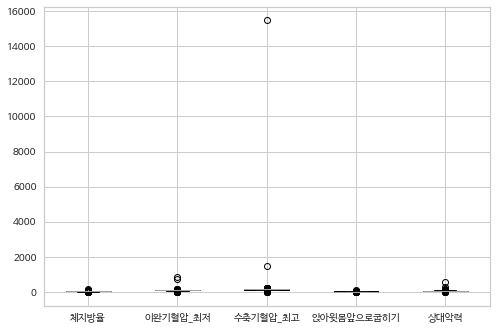

In [ ]:
# 남성데이터 이상치 제거
## 이상치 확인
ddf_fit5_2.boxplot(column = ['체지방율', '이완기혈압_최저', '수축기혈압_최고', '앉아윗몸앞으로굽히기', '상대악력'])
plt.show()

In [ ]:
# Q1,Q3,IQR정의
ddfM_Q1 = ddf_fit5_2[['체지방율', '이완기혈압_최저', '수축기혈압_최고', '앉아윗몸앞으로굽히기', '상대악력']].quantile(q=0.25)
ddfM_Q3 = ddf_fit5_2[['체지방율', '이완기혈압_최저', '수축기혈압_최고', '앉아윗몸앞으로굽히기', '상대악력']].quantile(q=0.75)
ddfM_IQR = ddfM_Q3-ddfM_Q1

print(ddfM_Q1)
print('-------------------------------')
print(ddfM_Q3)
print('-------------------------------')
print(ddfM_IQR)

체지방율           18.0
이완기혈압_최저       73.0
수축기혈압_최고      123.0
앉아윗몸앞으로굽히기      4.0
상대악력           53.1
Name: 0.25, dtype: float64
-------------------------------
체지방율           27.1
이완기혈압_최저       88.0
수축기혈압_최고      144.0
앉아윗몸앞으로굽히기     15.4
상대악력           66.0
Name: 0.75, dtype: float64
-------------------------------
체지방율           9.1
이완기혈압_최저      15.0
수축기혈압_최고      21.0
앉아윗몸앞으로굽히기    11.4
상대악력          12.9
dtype: float64


In [ ]:
# 이상치 제거한 남성 최종 데이터 만들기(ddf_fit5)
ddf_fit5_3 = ddf_fit5_2[(ddf_fit5_2['체지방율'] <= ddfM_Q3['체지방율']+1.5*ddfM_IQR['체지방율'])] # 체지방율의 min값인 3이 가능한 수치여서 그대로 둠 
ddf_fit5_4= ddf_fit5_3[(ddf_fit5_2['이완기혈압_최저'] <= ddfM_Q3['이완기혈압_최저']+1.5*ddfM_IQR['이완기혈압_최저']) & (ddf_fit5_2['이완기혈압_최저'] >= ddfM_Q1['이완기혈압_최저']-1.5*ddfM_IQR['이완기혈압_최저'])]
ddf_fit5_5= ddf_fit5_4[(ddf_fit5_2['수축기혈압_최고'] <= ddfM_Q3['수축기혈압_최고']+1.5*ddfM_IQR['수축기혈압_최고']) & (ddf_fit5_2['수축기혈압_최고'] >= ddfM_Q1['수축기혈압_최고']-1.5*ddfM_IQR['수축기혈압_최고'])]
ddf_fit5_6= ddf_fit5_5[(ddf_fit5_2['앉아윗몸앞으로굽히기'] <= ddfM_Q3['앉아윗몸앞으로굽히기']+1.5*ddfM_IQR['앉아윗몸앞으로굽히기']) & (ddf_fit5_2['앉아윗몸앞으로굽히기'] >= ddfM_Q1['앉아윗몸앞으로굽히기']-1.5*ddfM_IQR['앉아윗몸앞으로굽히기'])]
ddf_fit5_7 = ddf_fit5_6[(ddf_fit5_2['상대악력'] <= ddfM_Q3['상대악력']+1.5*ddfM_IQR['상대악력']) & (ddf_fit5_2['상대악력'] >= ddfM_Q1['상대악력']-1.5*ddfM_IQR['상대악력'])]
ddf_fit5_8 = ddf_fit5_7.reset_index(drop=True)

<ipython-input-20-555b11ccf9be>:3: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  ddf_fit5_4= ddf_fit5_3[(ddf_fit5_2['이완기혈압_최저'] <= ddfM_Q3['이완기혈압_최저']+1.5*ddfM_IQR['이완기혈압_최저']) & (ddf_fit5_2['이완기혈압_최저'] >= ddfM_Q1['이완기혈압_최저']-1.5*ddfM_IQR['이완기혈압_최저'])]
<ipython-input-20-555b11ccf9be>:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  ddf_fit5_5= ddf_fit5_4[(ddf_fit5_2['수축기혈압_최고'] <= ddfM_Q3['수축기혈압_최고']+1.5*ddfM_IQR['수축기혈압_최고']) & (ddf_fit5_2['수축기혈압_최고'] >= ddfM_Q1['수축기혈압_최고']-1.5*ddfM_IQR['수축기혈압_최고'])]
<ipython-input-20-555b11ccf9be>:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  ddf_fit5_6= ddf_fit5_5[(ddf_fit5_2['앉아윗몸앞으로굽히기'] <= ddfM_Q3['앉아윗몸앞으로굽히기']+1.5*ddfM_IQR['앉아윗몸앞으로굽히기']) & (ddf_fit5_2['앉아윗몸앞으로굽히기'] >= ddfM_Q1['앉아윗몸앞으로굽히기']-1.5*ddfM_IQR['앉아윗몸앞으로굽히기'])]
<ipython-input-20-555b11ccf9be>:6: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  ddf_fit5_7 = ddf_fit

In [ ]:
# 모델링 시 사용할 데이터프레임 만들기
ddf_fit5 = ddf_fit5_8.drop(["상장구분", "나이대"], axis = 1)

In [ ]:
# 남성 최종 데이터 19729개
ddf_fit5.info()
ddf_fit5.describe()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19729 entries, 0 to 19728
Data columns (total 9 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   나이          19729 non-null  int64  
 1   신장          19729 non-null  float64
 2   체중          19729 non-null  float64
 3   체지방율        19729 non-null  float64
 4   이완기혈압_최저    19729 non-null  float64
 5   수축기혈압_최고    19729 non-null  float64
 6   앉아윗몸앞으로굽히기  19729 non-null  float64
 7   BMI         19729 non-null  float64
 8   상대악력        19729 non-null  float64
dtypes: float64(8), int64(1)
memory usage: 1.4 MB


,나이,신장,체중,체지방율,이완기혈압_최저,수축기혈압_최고,앉아윗몸앞으로굽히기,BMI,상대악력
count,19729.000000,19729.000000,19729.000000,19729.000000,19729.000000,19729.000000,19729.000000,19729.000000,19729.000000
mean,38.767195,172.646835,74.783821,22.595129,80.208550,133.631933,9.675234,25.048700,59.685874
std,16.693202,6.335865,10.884058,6.381895,10.203662,13.841072,8.230939,3.073068,9.331566
min,20.000000,136.500000,35.500000,3.000000,51.000000,92.000000,-13.100000,14.100000,33.800000
25%,23.000000,168.500000,67.400000,18.100000,73.000000,123.000000,4.500000,23.000000,53.300000
50%,33.000000,172.700000,73.900000,22.600000,80.000000,133.000000,10.300000,24.800000,59.500000
75%,56.000000,177.000000,81.200000,27.000000,88.000000,144.000000,15.500000,26.900000,65.900000
max,69.000000,198.100000,136.300000,40.700000,109.000000,175.000000,32.200000,43.700000,85.300000


In [ ]:
# 여성 데이터 확인
ddf_fit6_2.describe()

,나이,신장,체중,체지방율,이완기혈압_최저,수축기혈압_최고,앉아윗몸앞으로굽히기,BMI,상대악력
count,12191.000000,12191.000000,12191.000000,12191.000000,12191.000000,12191.000000,12191.000000,12191.000000,12191.000000
mean,43.731113,159.150734,59.030234,31.582125,75.430949,126.572152,15.539470,23.320261,45.452178
std,17.045455,6.092322,9.145891,6.892153,15.419312,26.915129,8.126055,3.468026,8.778944
min,20.000000,127.300000,10.000000,6.900000,0.000000,0.000000,-21.000000,3.800000,0.000000
25%,26.000000,155.000000,52.800000,26.800000,68.000000,114.000000,11.200000,20.900000,39.800000
50%,46.000000,159.100000,57.800000,31.800000,75.000000,124.000000,16.500000,22.900000,45.300000
75%,60.000000,163.200000,63.900000,36.300000,83.000000,138.000000,20.900000,25.300000,51.000000
max,69.000000,182.600000,115.100000,68.100000,790.000000,1478.000000,207.000000,43.500000,305.000000


여성데이터의 통계값을 보았을 때 혈압, 앉아윗몸앞으로굽히기, 상대악력에 이상치가 있음을 추측할 수 있다.

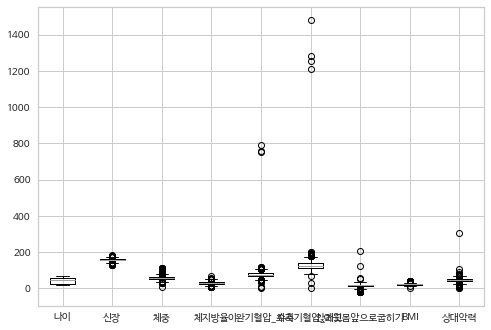

In [ ]:
# 여성데이터 이상치 제거
## 이상치 확인
ddf_fit6_2.boxplot(column = ['나이', '신장', '체중', '체지방율', '이완기혈압_최저', '수축기혈압_최고', '앉아윗몸앞으로굽히기', 'BMI',
       '상대악력'])
plt.show()

In [ ]:
# Q1,Q3,IQR정의
ddfF_Q1 = ddf_fit6_2[['이완기혈압_최저', '수축기혈압_최고', '앉아윗몸앞으로굽히기', '상대악력']].quantile(q=0.25)
ddfF_Q3 = ddf_fit6_2[['이완기혈압_최저', '수축기혈압_최고', '앉아윗몸앞으로굽히기', '상대악력']].quantile(q=0.75)
ddfF_IQR = ddfF_Q3-ddfF_Q1

print(ddfF_Q1)
print('-------------------------------')
print(ddfF_Q3)
print('-------------------------------')
print(ddfF_IQR)


이완기혈압_최저       68.0
수축기혈압_최고      114.0
앉아윗몸앞으로굽히기     11.2
상대악력           39.8
Name: 0.25, dtype: float64
-------------------------------
이완기혈압_최저       83.0
수축기혈압_최고      138.0
앉아윗몸앞으로굽히기     20.9
상대악력           51.0
Name: 0.75, dtype: float64
-------------------------------
이완기혈압_최저      15.0
수축기혈압_최고      24.0
앉아윗몸앞으로굽히기     9.7
상대악력          11.2
dtype: float64


In [ ]:
# 이상치 제거한 여성 최종 데이터 만들기(ddf_fit6)
ddf_fit6_4= ddf_fit6_2[(ddf_fit6_2['이완기혈압_최저'] <= ddfF_Q3['이완기혈압_최저']+1.5*ddfF_IQR['이완기혈압_최저']) & (ddf_fit6_2['이완기혈압_최저'] >= ddfF_Q1['이완기혈압_최저']-1.5*ddfF_IQR['이완기혈압_최저'])]
ddf_fit6_5= ddf_fit6_4[(ddf_fit6_2['수축기혈압_최고'] <= ddfF_Q3['수축기혈압_최고']+1.5*ddfF_IQR['수축기혈압_최고']) & (ddf_fit6_2['수축기혈압_최고'] >= ddfF_Q1['수축기혈압_최고']-1.5*ddfF_IQR['수축기혈압_최고'])]
ddf_fit6_6= ddf_fit6_5[(ddf_fit6_2['앉아윗몸앞으로굽히기'] <= ddfF_Q3['앉아윗몸앞으로굽히기']+1.5*ddfF_IQR['앉아윗몸앞으로굽히기']) & (ddf_fit5_2['앉아윗몸앞으로굽히기'] >= ddfF_Q1['앉아윗몸앞으로굽히기']-1.5*ddfF_IQR['앉아윗몸앞으로굽히기'])]
ddf_fit6_7 = ddf_fit6_6[(ddf_fit6_2['상대악력'] <= ddfF_Q3['상대악력']+1.5*ddfF_IQR['상대악력']) & (ddf_fit6_2['상대악력'] >= ddfF_Q1['상대악력']-1.5*ddfF_IQR['상대악력'])]
ddf_fit6_8 = ddf_fit6_7.reset_index(drop=True)

<ipython-input-26-8da9750fa68a>:3: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  ddf_fit6_5= ddf_fit6_4[(ddf_fit6_2['수축기혈압_최고'] <= ddfF_Q3['수축기혈압_최고']+1.5*ddfF_IQR['수축기혈압_최고']) & (ddf_fit6_2['수축기혈압_최고'] >= ddfF_Q1['수축기혈압_최고']-1.5*ddfF_IQR['수축기혈압_최고'])]
<ipython-input-26-8da9750fa68a>:4: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  ddf_fit6_6= ddf_fit6_5[(ddf_fit6_2['앉아윗몸앞으로굽히기'] <= ddfF_Q3['앉아윗몸앞으로굽히기']+1.5*ddfF_IQR['앉아윗몸앞으로굽히기']) & (ddf_fit5_2['앉아윗몸앞으로굽히기'] >= ddfF_Q1['앉아윗몸앞으로굽히기']-1.5*ddfF_IQR['앉아윗몸앞으로굽히기'])]
<ipython-input-26-8da9750fa68a>:5: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  ddf_fit6_7 = ddf_fit6_6[(ddf_fit6_2['상대악력'] <= ddfF_Q3['상대악력']+1.5*ddfF_IQR['상대악력']) & (ddf_fit6_2['상대악력'] >= ddfF_Q1['상대악력']-1.5*ddfF_IQR['상대악력'])]


In [ ]:
# 모델링 시 사용할 데이터프레임 만들기
ddf_fit6 = ddf_fit6_8.drop(["상장구분", "나이대"], axis = 1)

In [ ]:
# 여성 최종 데이터 10954개
ddf_fit6.info()
ddf_fit6.describe()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10954 entries, 0 to 10953
Data columns (total 9 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   나이          10954 non-null  int64  
 1   신장          10954 non-null  float64
 2   체중          10954 non-null  float64
 3   체지방율        10954 non-null  float64
 4   이완기혈압_최저    10954 non-null  float64
 5   수축기혈압_최고    10954 non-null  float64
 6   앉아윗몸앞으로굽히기  10954 non-null  float64
 7   BMI         10954 non-null  float64
 8   상대악력        10954 non-null  float64
dtypes: float64(8), int64(1)
memory usage: 770.3 KB


,나이,신장,체중,체지방율,이완기혈압_최저,수축기혈압_최고,앉아윗몸앞으로굽히기,BMI,상대악력
count,10954.000000,10954.000000,10954.000000,10954.000000,10954.000000,10954.000000,10954.000000,10954.000000,10954.000000
mean,43.849553,159.131751,58.972847,31.558042,75.259969,126.135667,15.535053,23.302319,45.497654
std,17.066061,6.121261,9.085152,6.828854,10.652909,15.889519,7.823770,3.436420,8.049757
min,20.000000,127.300000,30.200000,6.900000,46.000000,79.000000,-21.000000,14.300000,23.000000
25%,26.000000,155.000000,52.800000,26.800000,68.000000,115.000000,11.300000,20.900000,39.900000
50%,46.000000,159.100000,57.800000,31.800000,75.000000,124.000000,16.500000,22.800000,45.300000
75%,60.000000,163.200000,63.900000,36.200000,83.000000,138.000000,20.900000,25.300000,50.900000
max,69.000000,182.600000,115.100000,68.100000,105.000000,174.000000,35.200000,43.500000,67.700000


### (4) 데이터 탐색 및 시각화

#### 남성 데이터(ddf_fit5_8)

20    8519
60    4141
30    3099
40    2039
50    1931
Name: 나이대, dtype: int64


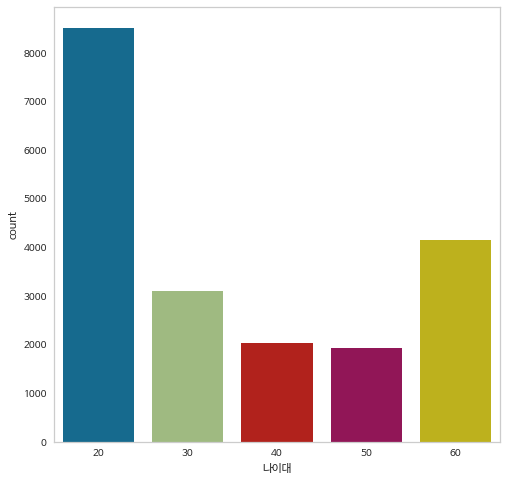

In [ ]:
# 나이대에 따른 남성 데이터 
plt.figure(figsize = (8,8))
sns.countplot(data = ddf_fit5_8, x = '나이대')
plt.grid(False)

print(ddf_fit5_8["나이대"].value_counts())

참가증    10645
3등급     4539
2등급     3358
1등급     1187
Name: 상장구분, dtype: int64


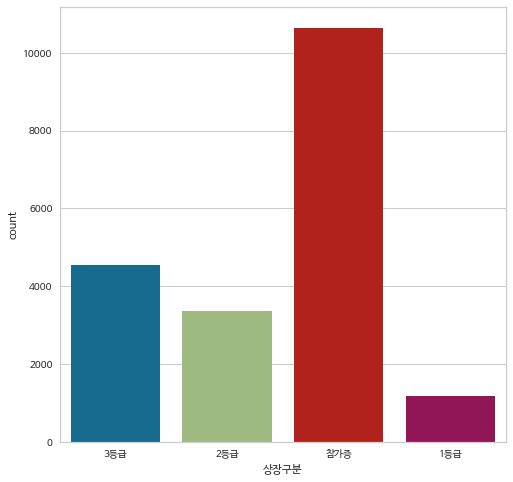

In [ ]:
# 상장구분에 따른 남성데이터
plt.figure(figsize = (8,8))
sns.countplot(data = ddf_fit5_8, x = '상장구분')

print(ddf_fit5_8["상장구분"].value_counts())

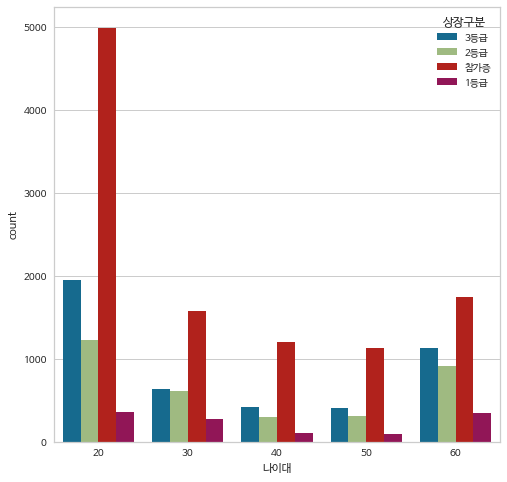

In [ ]:
# 나이대와 상장구분에 따른
plt.figure(figsize = (8,8))
sns.countplot(data = ddf_fit5_8, x = '나이대', hue = "상장구분")


#### 여성 데이터(ddf_fit6_8)



20    3534
60    2871
50    2169
40    1241
30    1139
Name: 나이대, dtype: int64


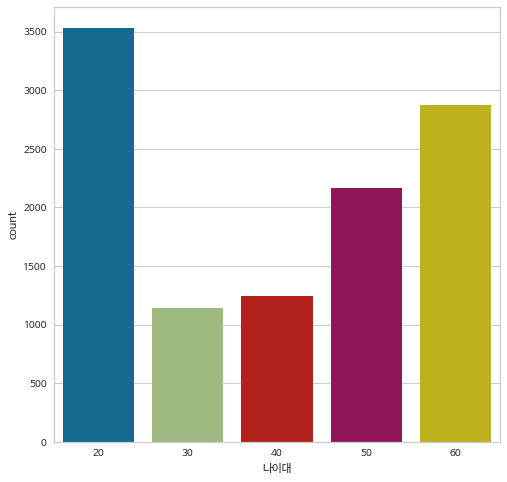

In [ ]:
# 나이대에 따른 여성 데이터
plt.figure(figsize = (8,8))
sns.countplot(data = ddf_fit6_8, x = '나이대')

print(ddf_fit6_8["나이대"].value_counts())

참가증    5645
3등급    2526
2등급    1864
1등급     919
Name: 상장구분, dtype: int64


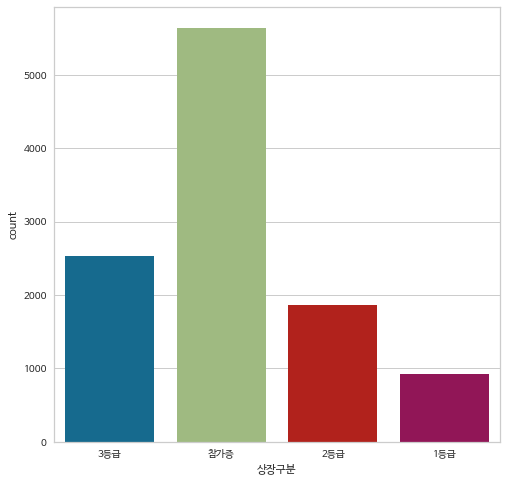

In [ ]:
# 상장구분에 따른 여성 데이터
plt.figure(figsize = (8,8))
sns.countplot(data = ddf_fit6_8, x = '상장구분')

print(ddf_fit6_8["상장구분"].value_counts())

20    3534
60    2871
50    2169
40    1241
30    1139
Name: 나이대, dtype: int64


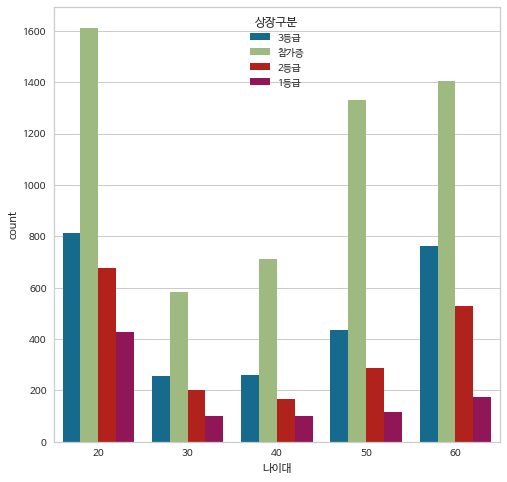

In [ ]:
# 나이대와 상장구분에 따른
plt.figure(figsize = (8,8))
sns.countplot(data = ddf_fit6_8, x = '나이대', hue = "상장구분")

print(ddf_fit6_8["나이대"].value_counts())

## [3] 남성 데이터로 모델링(군집화)

In [ ]:
ddf_sc = StandardScaler()

### (1) 표준화 / 군집 수 정하기(엘보우)

In [ ]:
# 표준화
ddf_scaled_M = ddf_sc.fit_transform(ddf_fit5)
pd.DataFrame(ddf_scaled_M)


,0,1,2,3,4,5,6,7,8
0,-1.124270,1.271077,1.278616,0.267149,-1.980570,-2.285425,0.258150,0.700067,0.901707
1,1.571506,0.182011,-0.044453,0.314158,-0.118446,1.038101,0.112355,-0.146014,0.323011
2,-0.225678,-3.006269,-1.119447,-0.312631,-0.706485,-0.768163,-0.130637,0.472276,1.941216
3,-0.105866,0.797570,1.140796,0.079112,-0.020439,0.387846,0.938527,0.830234,-0.127085
4,1.751225,-1.869853,-1.468591,0.235809,0.861619,1.688356,1.035724,-0.764304,-1.037995
...,...,...,...,...,...,...,...,...,...
19724,-1.004458,-1.317428,-1.073507,-0.955090,0.077567,-0.768163,0.841331,-0.536513,0.280145
19725,0.013946,0.497682,-0.026077,-0.829732,-0.706485,-0.262409,-0.009141,-0.308722,2.059098
19726,0.553102,1.349994,-1.101071,-0.014906,-1.098511,-0.479161,-1.442792,-1.935802,-0.169952
19727,0.193665,0.118876,1.471564,0.502194,0.469593,1.760607,1.254417,1.676315,0.237279


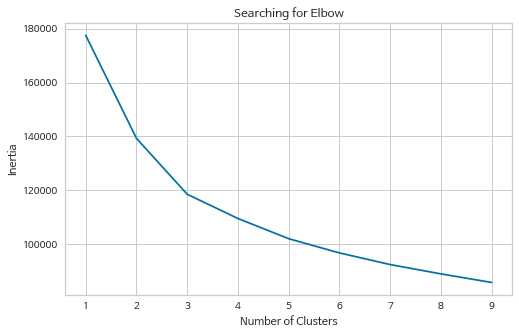

In [ ]:
# 군집 수 정하기 
ddf_Xm = ddf_scaled_M.copy()

clusters =[]
for i in range(1, 10):
    km = KMeans(n_clusters=i, random_state=0).fit(ddf_Xm)
    clusters.append(km.inertia_)
    
fig, ax = plt.subplots(figsize=(8, 5))
sns.lineplot(x=list(range(1, 10)), y=clusters, ax=ax)
ax.set_title('Searching for Elbow')
ax.set_xlabel('Number of Clusters')
ax.set_ylabel('Inertia')

plt.show() # 2, 3중에서 선택

In [ ]:
# ddf_scaled_M 데이터를 넣어 클러스터링
ddf_km3_M = KMeans(n_clusters=3, random_state = 0)
ddf_clustersM = ddf_km3_M.fit(ddf_Xm)

# 클러스터일 변수인 ddf_clusters 값을 원본 데이터인 ddf_fit5에 넣기
ddf_fit5["Clusters"] = ddf_clustersM.labels_
ddf_fit5.head()

,나이,신장,체중,체지방율,이완기혈압_최저,수축기혈압_최고,앉아윗몸앞으로굽히기,BMI,상대악력,Clusters
0,20,180.7,88.7,24.3,60.0,102.0,11.8,27.2,68.1,1
1,65,173.8,74.3,24.6,79.0,148.0,10.6,24.6,62.7,0
2,35,153.6,62.6,20.6,73.0,123.0,8.6,26.5,77.8,1
3,37,177.7,87.2,23.1,80.0,139.0,17.4,27.6,58.5,2
4,68,160.8,58.8,24.1,89.0,157.0,18.2,22.7,50.0,0


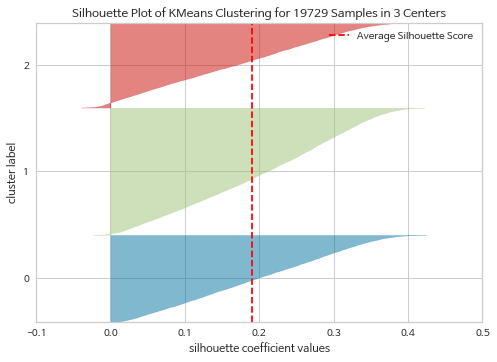

모든 데이터의 평균 실루엣 계수값: 0.1907479652927584


In [ ]:
# 실루엣 계수 시각화
#visualizer 생성
visualizer_2 = SilhouetteVisualizer(ddf_km3_M, colors='yellowbrick')
#생성된 visualizer에 데이터 입력 
visualizer_2.fit(ddf_Xm)      
visualizer_2.show()

average_score_M = silhouette_score(ddf_Xm, ddf_fit5["Clusters"])
print('모든 데이터의 평균 실루엣 계수값:', format(average_score_M)) 

In [ ]:
# 데이비스-볼딘지수 확인
ddf_dv_M = davies_bouldin_score(ddf_Xm, ddf_fit5["Clusters"])
print('데이비스-볼딘지수:', format(ddf_dv_M)) 

데이비스-볼딘지수: 1.6152566333441873


### (2) 클러스터링 결과 확인

In [ ]:
# 클러스터별 개수
ddf_fit5.groupby('Clusters').count()

,나이,신장,체중,체지방율,이완기혈압_최저,수축기혈압_최고,앉아윗몸앞으로굽히기,BMI,상대악력
Clusters,,,,,,,,,
0,5734,5734,5734,5734,5734,5734,5734,5734,5734
1,8404,8404,8404,8404,8404,8404,8404,8404,8404
2,5591,5591,5591,5591,5591,5591,5591,5591,5591


- cluster1에 해당하는 수가 8404로 가장 많다. 그 다음으로는 cluster0(5734), cluster2(5591) 순이다.

In [ ]:
# 클러스터별 평균
ddf_fit5.groupby('Clusters').mean()

,나이,신장,체중,체지방율,이완기혈압_최저,수축기혈압_최고,앉아윗몸앞으로굽히기,BMI,상대악력
Clusters,,,,,,,,,
0,57.966167,167.484601,69.362973,24.816170,84.854479,142.343913,9.110696,24.719777,58.022428
1,29.200262,174.093777,70.301167,17.801258,75.094360,125.875226,11.237114,23.176273,64.901559
2,33.457521,175.766160,87.081329,27.523092,83.131086,136.356466,7.906503,28.200537,53.552012


- 각 클러스터별 평균값은 위와 같다.
- 전반적인 평균 수치를 보았을 때 cluster2의 평균 체력이 상대적으로 낮다는 것을 확인할 수 있다. 



### (3) 클러스터링 결과 시각화(차원 축소 활용)
- 차원 축소 방법인 PCA(Principal Component Analysis)를 통해 시각화를 한다.
 - 차원 축소란: 정보를 잃지 않게 하면서 새로운 축을 만드는 기법이다.
- 9개의 변수를 2개의 변수로 줄이는 작업을 통해 2차원의 그래프를 그리고자 한다.


In [ ]:
# 클러스터링 시각화
ddf_X_M = ddf_Xm.copy()

#객체
ddf_pca = PCA(n_components=2)

#적용
ddf_pca.fit(ddf_X_M)
ddf_pcaM = ddf_pca.transform(ddf_X_M)
ddf_pcaM

array([[-0.58319017,  3.30021166],
       [ 0.37863469, -1.1392859 ],
       [-1.64553801, -1.41680325],
       ...,
       [-1.51595402,  0.10389459],
       [ 2.09742847,  0.08695842],
       [ 3.70586038, -0.3547341 ]])

In [ ]:
#ddf_pca를 보기 쉽게 데이터프레임으로 만들기
ddf_pca_dfM = pd.DataFrame(ddf_pcaM)
ddf_pca_dfM['Clusters'] = ddf_fit5['Clusters'] 
ddf_pca_dfM.head()

,0,1,Clusters
0,-0.583190,3.300212,1
1,0.378635,-1.139286,0
2,-1.645538,-1.416803,1
3,0.992075,0.998097,2
4,0.221662,-3.502650,0


/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


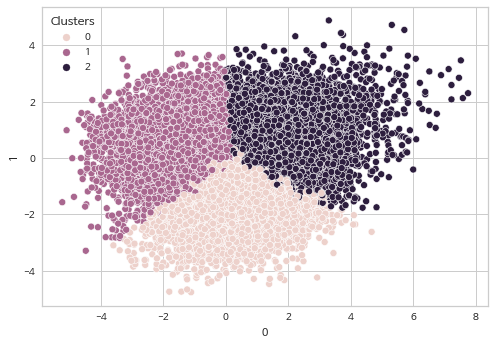

In [ ]:
# 시각화
ddf_axsM = plt.subplots()
ddf_axsM = sns.scatterplot(0, 1, hue='Clusters', data=ddf_pca_dfM)


## [4] 남성 데이터 클러스터별 특징 파악

In [ ]:
# 클러스터링 결과와 기존의 상장구분을 포함한 데이터프레임 생성
ddf_newM = ddf_fit5.copy()
ddf_newM['상장구분'] = ddf_fit5_8[['상장구분']]
ddf_newM['나이대'] = ddf_fit5_8['나이대']
ddf_newM

,나이,신장,체중,체지방율,이완기혈압_최저,수축기혈압_최고,앉아윗몸앞으로굽히기,BMI,상대악력,Clusters,상장구분,나이대
0,20,180.7,88.7,24.3,60.0,102.0,11.8,27.2,68.1,1,3등급,20
1,65,173.8,74.3,24.6,79.0,148.0,10.6,24.6,62.7,0,2등급,60
2,35,153.6,62.6,20.6,73.0,123.0,8.6,26.5,77.8,1,3등급,30
3,37,177.7,87.2,23.1,80.0,139.0,17.4,27.6,58.5,2,2등급,30
4,68,160.8,58.8,24.1,89.0,157.0,18.2,22.7,50.0,0,참가증,60
...,...,...,...,...,...,...,...,...,...,...,...,...
19724,22,164.3,63.1,16.5,81.0,123.0,16.6,23.4,62.3,1,3등급,20
19725,39,175.8,74.5,17.3,73.0,130.0,9.6,24.1,78.9,1,2등급,30
19726,48,181.2,62.8,22.5,69.0,127.0,-2.2,19.1,58.1,1,참가증,40
19727,42,173.4,90.8,25.8,85.0,158.0,20.0,30.2,61.9,2,참가증,40


### (1) 클러스터별 상장구분의 비율

In [ ]:
ddf_newM_group = ddf_newM.groupby(['Clusters','상장구분'], as_index=False).count()[['Clusters', '상장구분', '나이']]
ddf_newM_group

,Clusters,상장구분,나이
0,0,1등급,387
1,0,2등급,1190
2,0,3등급,1502
3,0,참가증,2655
4,1,1등급,756
5,1,2등급,1826
6,1,3등급,2438
7,1,참가증,3384
8,2,1등급,44
9,2,2등급,342


In [ ]:
#ddf_newM_group에서 cluster별 상장구분1,2,3,4 비율을 for문으로 뽑기.
ddf1 = (ddf_newM_group['상장구분']=="1등급") 
ddf2 = (ddf_newM_group['상장구분']=="2등급") 
ddf3 = (ddf_newM_group['상장구분']=="3등급") 
ddf4 = (ddf_newM_group['상장구분']=="참가증") 

for i in range(0, 3):
    tmp3 = (ddf_newM_group['Clusters']==i)
    print('Cluster '+ str(i) + '의 1등급 비율은 ' + str(round((ddf_newM_group.loc[(tmp3 & ddf1),  '나이'].sum() / ddf_newM_group.loc[tmp3, '나이'].sum())*100, 4)) + '%')
    print('Cluster '+ str(i) + '의 2등급 비율은 ' + str(round((ddf_newM_group.loc[(tmp3 & ddf2),  '나이'].sum() / ddf_newM_group.loc[tmp3, '나이'].sum())*100, 4)) + '%')
    print('Cluster '+ str(i) + '의 3등급 비율은 ' + str(round((ddf_newM_group.loc[(tmp3 & ddf3),  '나이'].sum() / ddf_newM_group.loc[tmp3, '나이'].sum())*100, 4)) + '%')
    print('Cluster '+ str(i) + '의 참가증 비율은 ' + str(round((ddf_newM_group.loc[(tmp3 & ddf4), '나이'].sum() / ddf_newM_group.loc[tmp3, '나이'].sum())*100, 4)) + '%')
    print(' ')

Cluster 0의 1등급 비율은 6.7492%
Cluster 0의 2등급 비율은 20.7534%
Cluster 0의 3등급 비율은 26.1946%
Cluster 0의 참가증 비율은 46.3028%
 
Cluster 1의 1등급 비율은 8.9957%
Cluster 1의 2등급 비율은 21.7277%
Cluster 1의 3등급 비율은 29.01%
Cluster 1의 참가증 비율은 40.2665%
 
Cluster 2의 1등급 비율은 0.787%
Cluster 2의 2등급 비율은 6.117%
Cluster 2의 3등급 비율은 10.7136%
Cluster 2의 참가증 비율은 82.3824%
 


- cluster2가 다른 클러스터에 비해 참가증을 받은 비율이 높다. 이 이유를 분석하면 좋을 것 같다.

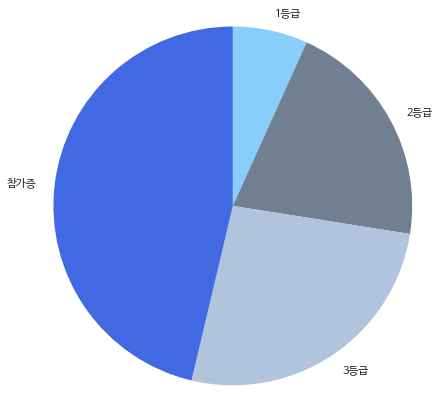

In [ ]:
##  클러스터별 상장구분 시각화
# cluster0
ratioM0 = [6.7492, 20.7534, 26.1946, 46.3028]
labels = ['1등급', '2등급', '3등급', '참가증']
colors = ['lightskyblue', 'slategrey', 'lightsteelblue', 'royalblue']
textprops = dict(size=11, weight=4)
plt.pie(ratioM0,labels = labels, startangle = 90, counterclock=False, textprops=textprops, colors=colors, radius=1.5)
plt.show()


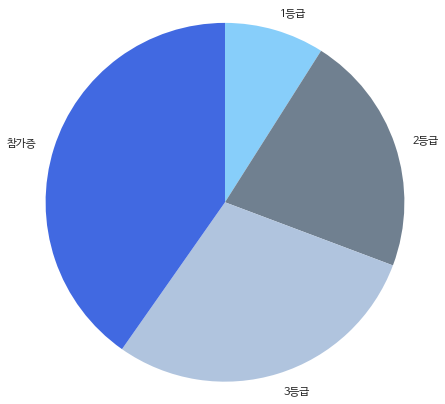

In [ ]:
# cluster1
ratioM1 = [8.9957, 21.7277, 29.01, 40.2665]
labels = ['1등급', '2등급', '3등급', '참가증']
colors = ['lightskyblue', 'slategrey', 'lightsteelblue', 'royalblue']
textprops = dict(size=11, weight=4)
plt.pie(ratioM1,labels = labels, startangle = 90, counterclock=False, textprops=textprops, colors = colors, radius=1.5)
plt.show()

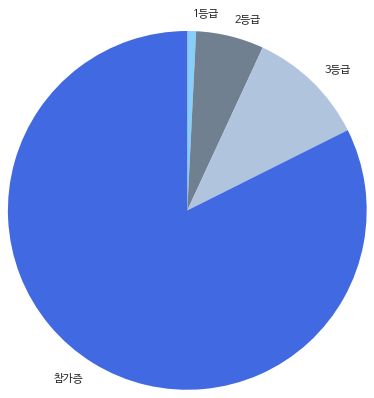

In [ ]:
# cluster2
ratioM2 = [0.787, 6.117, 10.7136, 82.3824]
labels = ['1등급', '2등급', '3등급', '참가증']
colors = ['lightskyblue', 'slategrey', 'lightsteelblue', 'royalblue']
textprops = dict(size=11, weight=4)
plt.pie(ratioM2,labels = labels, startangle = 90, counterclock=False, textprops=textprops, colors = colors, radius=1.5)
plt.show()

### (2) 클러스터별 나이대의 비율

In [ ]:
ddf_newM_group1 = ddf_newM.groupby(['Clusters','나이대'], as_index=False).count()[['Clusters', '나이대', '나이']]

In [ ]:
#ddf_newM_group1에서 cluster별 상장구분1,2,3,4 비율을 for문으로 뽑기.
ddf1 = (ddf_newM_group1['나이대']== 20) 
ddf2 = (ddf_newM_group1['나이대']== 30) 
ddf3 = (ddf_newM_group1['나이대']== 40) 
ddf4 = (ddf_newM_group1['나이대']== 50)
ddf5 = (ddf_newM_group1['나이대']== 60)  

for i in range(0, 3):
    tmp3 = (ddf_newM_group1['Clusters']==i)
    print('Cluster '+ str(i) + '의 20대 비율은 ' + str(round((ddf_newM_group1.loc[(tmp3 & ddf1),  '나이'].sum() / ddf_newM_group1.loc[tmp3, '나이'].sum())*100, 5)) + '%')
    print('Cluster '+ str(i) + '의 30대 비율은 ' + str(round((ddf_newM_group1.loc[(tmp3 & ddf2),  '나이'].sum() / ddf_newM_group1.loc[tmp3, '나이'].sum())*100, 5)) + '%')
    print('Cluster '+ str(i) + '의 40대 비율은 ' + str(round((ddf_newM_group1.loc[(tmp3 & ddf3),  '나이'].sum() / ddf_newM_group1.loc[tmp3, '나이'].sum())*100, 5)) + '%')
    print('Cluster '+ str(i) + '의 50대 비율은 ' + str(round((ddf_newM_group1.loc[(tmp3 & ddf4),  '나이'].sum() / ddf_newM_group1.loc[tmp3, '나이'].sum())*100, 5)) + '%')
    print('Cluster '+ str(i) + '의 60대 비율은 ' + str(round((ddf_newM_group1.loc[(tmp3 & ddf5),  '나이'].sum() / ddf_newM_group1.loc[tmp3, '나이'].sum())*100, 5)) + '%')
    print(' ')

Cluster 0의 20대 비율은 3.40077%
Cluster 0의 30대 비율은 4.41228%
Cluster 0의 40대 비율은 9.45239%
Cluster 0의 50대 비율은 20.63132%
Cluster 0의 60대 비율은 62.10324%
 
Cluster 1의 20대 비율은 66.77772%
Cluster 1의 30대 비율은 17.74155%
Cluster 1의 40대 비율은 8.34127%
Cluster 1의 50대 비율은 3.85531%
Cluster 1의 60대 비율은 3.28415%
 
Cluster 2의 20대 비율은 48.50653%
Cluster 2의 30대 비율은 24.23538%
Cluster 2의 40대 비율은 14.23717%
Cluster 2의 50대 비율은 7.58362%
Cluster 2의 60대 비율은 5.43731%
 


체력 데이터의 평균 수치가 가장 좋지 않고, 참가증을 가장 많이 받은 clusters2에서 20대의 비율이 높게 나타난다.

####1. 클러스터에 따른 나이대별 상장구분 수

In [ ]:
ddf_newM_비율 = ddf_newM.groupby(['Clusters','나이대', '상장구분'], as_index=False).count()[['Clusters', '나이대', '상장구분', '나이']]
ddf_newM_비율

,Clusters,나이대,상장구분,나이
0,0,20,1등급,5
1,0,20,2등급,27
2,0,20,3등급,38
3,0,20,참가증,125
4,0,30,1등급,8
5,0,30,2등급,50
6,0,30,3등급,65
7,0,30,참가증,130
8,0,40,1등급,30
9,0,40,2등급,90


In [ ]:
# Cluster 0 분리
ddf_newM0 = ddf_newM[ddf_newM['Clusters'] == 0]
ddf_newM0.describe()

,나이,신장,체중,체지방율,이완기혈압_최저,수축기혈압_최고,앉아윗몸앞으로굽히기,BMI,상대악력,Clusters
count,5734.000000,5734.000000,5734.000000,5734.000000,5734.000000,5734.000000,5734.000000,5734.000000,5734.000000,5734.0
mean,57.966167,167.484601,69.362973,24.816170,84.854479,142.343913,9.110696,24.719777,58.022428,0.0
std,10.497642,5.316677,7.016363,4.830701,8.862283,12.056395,7.466746,2.200117,7.994244,0.0
min,20.000000,137.700000,39.900000,5.200000,51.000000,98.000000,-13.100000,16.300000,33.900000,0.0
25%,55.000000,164.000000,65.000000,21.600000,79.000000,134.000000,4.400000,23.400000,52.800000,0.0
50%,61.000000,167.700000,69.900000,24.700000,85.000000,144.000000,9.500000,24.800000,58.000000,0.0
75%,65.000000,171.100000,74.600000,28.000000,92.000000,152.000000,14.300000,26.200000,63.400000,0.0
max,69.000000,187.000000,86.400000,40.500000,109.000000,175.000000,29.000000,36.700000,84.700000,0.0


In [ ]:
# Cluster 1 분리
ddf_newM1 = ddf_newM[ddf_newM['Clusters'] == 1]
ddf_newM1.describe()

,나이,신장,체중,체지방율,이완기혈압_최저,수축기혈압_최고,앉아윗몸앞으로굽히기,BMI,상대악력,Clusters
count,8404.000000,8404.000000,8404.000000,8404.000000,8404.000000,8404.000000,8404.000000,8404.000000,8404.000000,8404.0
mean,29.200262,174.093777,70.301167,17.801258,75.094360,125.875226,11.237114,23.176273,64.901559,1.0
std,10.763167,5.343731,7.523670,4.621694,9.351974,11.715671,8.369875,2.079696,8.230704,0.0
min,20.000000,149.700000,35.500000,3.000000,51.000000,92.000000,-13.100000,14.100000,33.800000,1.0
25%,21.000000,170.500000,65.200000,14.600000,68.000000,118.000000,6.300000,21.800000,59.300000,1.0
50%,25.000000,174.000000,70.700000,17.800000,75.000000,125.000000,11.900000,23.300000,64.800000,1.0
75%,33.000000,177.600000,75.540000,21.000000,81.000000,134.000000,17.000000,24.600000,70.600000,1.0
max,69.000000,195.400000,94.200000,37.500000,104.000000,160.000000,32.200000,29.400000,85.300000,1.0


In [ ]:
# Cluster 2 분리
ddf_newM2 = ddf_newM[ddf_newM['Clusters'] == 2]
ddf_newM2.describe()

,나이,신장,체중,체지방율,이완기혈압_최저,수축기혈압_최고,앉아윗몸앞으로굽히기,BMI,상대악력,Clusters
count,5591.000000,5591.000000,5591.000000,5591.000000,5591.000000,5591.000000,5591.000000,5591.000000,5591.000000,5591.0
mean,33.457521,175.766160,87.081329,27.523092,83.131086,136.356466,7.906503,28.200537,53.552012,2.0
std,12.344675,5.435232,8.419413,4.878214,9.241900,12.040128,8.335771,2.558280,7.652980,0.0
min,20.000000,136.500000,65.300000,11.200000,52.000000,93.000000,-13.100000,21.200000,33.900000,2.0
25%,23.000000,172.000000,81.400000,24.100000,77.000000,128.000000,2.300000,26.500000,48.300000,2.0
50%,30.000000,175.700000,85.600000,27.400000,83.000000,136.000000,8.600000,27.900000,53.500000,2.0
75%,41.000000,179.400000,91.400000,30.850000,90.000000,145.000000,14.000000,29.600000,58.800000,2.0
max,69.000000,198.100000,136.300000,40.700000,109.000000,175.000000,30.200000,43.700000,84.100000,2.0


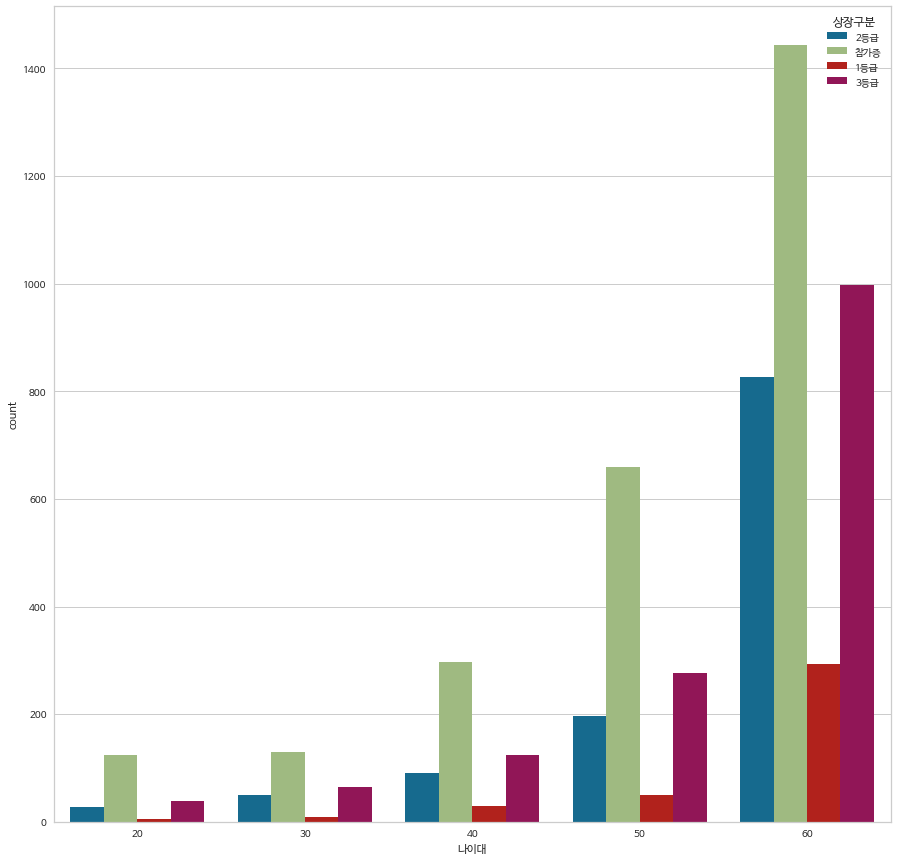

In [ ]:
# Cluster0의 나이대 & 상장구분에 따른 빈도 시각화
plt.figure(figsize = (15,15))
sns.countplot(data = ddf_newM0, x = "나이대", hue = '상장구분')

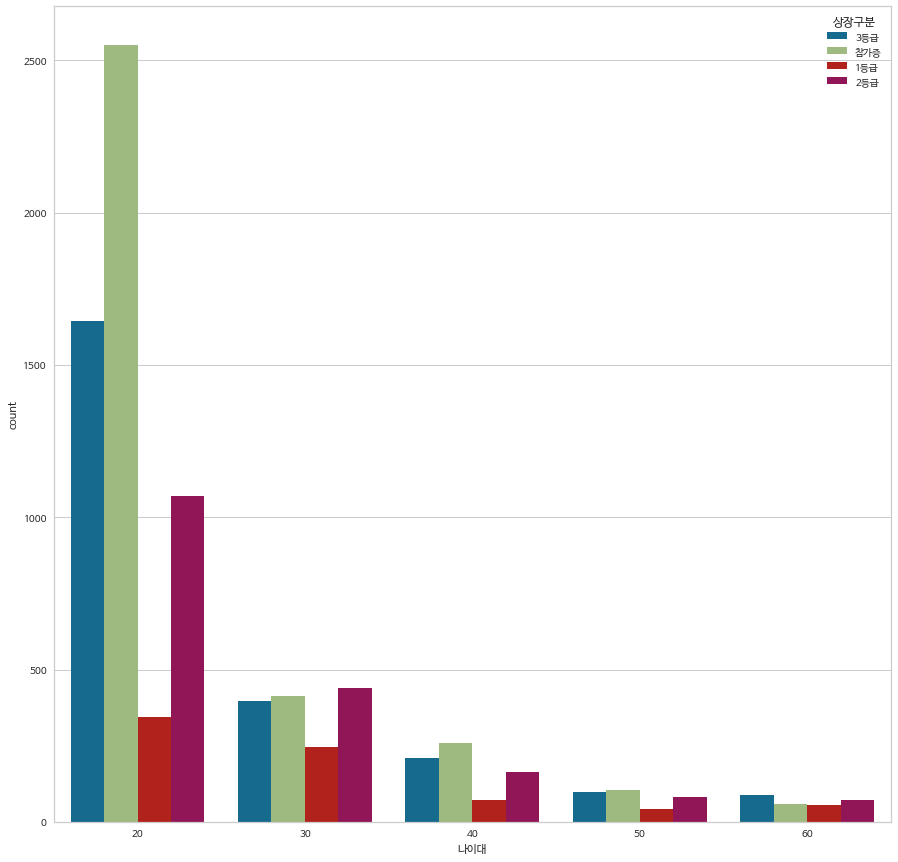

In [ ]:
# Cluster1의 나이대 & 상장구분에 따른
plt.figure(figsize = (15,15))
sns.countplot(data = ddf_newM1, x = "나이대", hue = '상장구분')

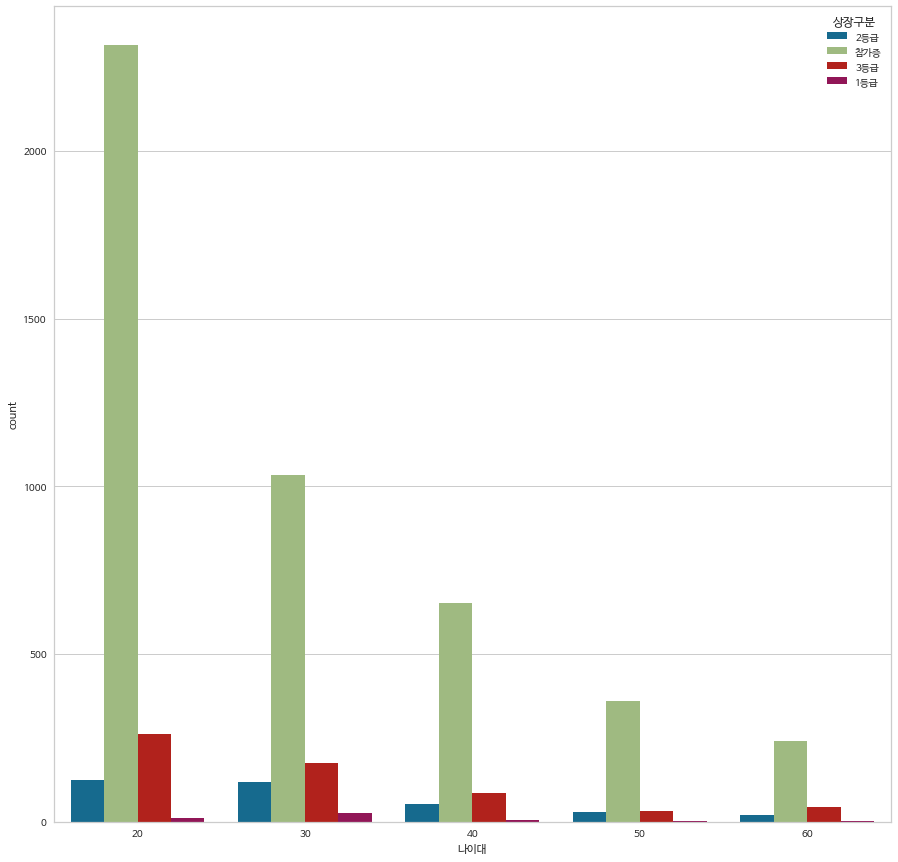

In [ ]:
# Cluster2의 나이대 & 상장구분에 따른
plt.figure(figsize = (15,15))
sns.countplot(data = ddf_newM2, x = "나이대", hue = '상장구분')

### (3) 클러스터별 탐색



#### 클러스터에 따른 나이대별 평균

In [ ]:
# 군집 시각화할 수 있는 함수 만들기1: 나이대별
def group_plot(df, text, name_list):

  fig, axes = plt.subplots(1,len(name_list),figsize=(110, 6))
  plt.subplots_adjust(wspace=0.3, hspace = 0.5)

  for i in range(len(name_list)):

    plot1 = sns.barplot(x=name_list[i], y = '나이대', data=df, orient='h', ci=None , ax=axes[i], estimator = np.mean) 
    plot1.set_title(f'{text}' + ' ' + name_list[i] + ' ' + '평균' ,fontsize=15 , weight='bold')
    plot1.set_xlabel(' ')
    plot1.set_ylabel('나이대')

  plt.show()
    

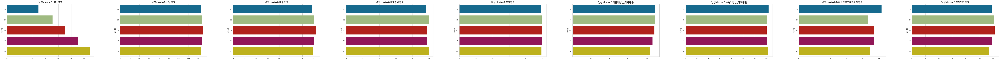

In [ ]:
# cluster0
name_list = ['나이','신장', '체중', '체지방율', 'BMI','이완기혈압_최저', '수축기혈압_최고', '앉아윗몸앞으로굽히기', '상대악력']
group_plot(ddf_newM0, '남성 cluster0',  name_list)

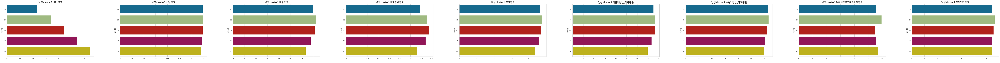

In [ ]:
# cluster1
name_list = ['나이','신장', '체중', '체지방율', 'BMI','이완기혈압_최저', '수축기혈압_최고', '앉아윗몸앞으로굽히기', '상대악력']
group_plot(ddf_newM1, '남성 cluster1',  name_list)

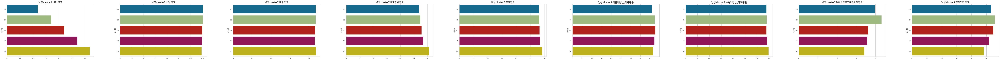

In [ ]:
# cluster2
name_list = ['나이','신장', '체중', '체지방율', 'BMI','이완기혈압_최저', '수축기혈압_최고', '앉아윗몸앞으로굽히기', '상대악력']
group_plot(ddf_newM2, '남성 cluster2',  name_list)

#### 클러스터에 따른 상장구분별 평균

In [ ]:
# 군집 시각화할 수 있는 함수 만들기2: 상장구분
def group_plot1(df, text, name_list):

  fig, axes = plt.subplots(1,len(name_list),figsize=(110, 6))
  plt.subplots_adjust(wspace=0.3, hspace = 0.5)

  for i in range(len(name_list)):

    plot1 = sns.barplot(x=name_list[i], y = '상장구분', data=df, orient='h', ci=None , ax=axes[i], estimator = np.mean) 
    plot1.set_title(f'{text}' + ' ' + name_list[i] + ' ' + '평균' ,fontsize=15 , weight='bold')
    plot1.set_xlabel(' ')
    plot1.set_ylabel('상장구분')

  plt.show()
    

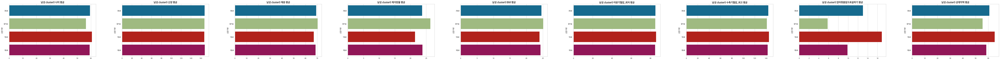

In [ ]:
# cluster0
name_list = ['나이','신장', '체중', '체지방율', 'BMI','이완기혈압_최저', '수축기혈압_최고', '앉아윗몸앞으로굽히기', '상대악력']
group_plot1(ddf_newM0, '남성 cluster0',  name_list)

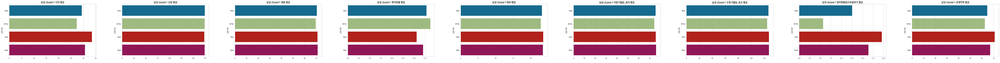

In [ ]:
# cluster1
name_list = ['나이','신장', '체중', '체지방율', 'BMI','이완기혈압_최저', '수축기혈압_최고', '앉아윗몸앞으로굽히기', '상대악력']
group_plot1(ddf_newM1, '남성 cluster1',  name_list)

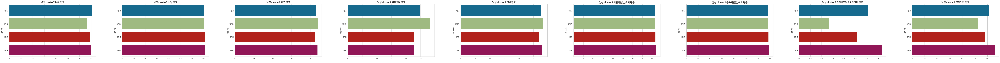

In [ ]:
# cluster2
name_list = ['나이','신장', '체중', '체지방율', 'BMI','이완기혈압_최저', '수축기혈압_최고', '앉아윗몸앞으로굽히기', '상대악력']
group_plot1(ddf_newM2, '남성 cluster2',  name_list)

#### 클러스터에 따른 나이대&상장구분별 평균

##### 시각화

In [ ]:
# 군집 시각화할 수 있는 함수 만들기2: 상장구분
def group_plot2(df, text, name_list):

  fig, axes = plt.subplots(1,len(name_list),figsize=(185, 8))
  plt.subplots_adjust(wspace=0.3, hspace = 0.5)

  for i in range(len(name_list)):

    plot1 = sns.barplot(x=name_list[i], y = '나이대',hue = '상장구분', data=df, palette='pastel', orient='h', ci=None , ax=axes[i], estimator = np.mean) 
    plot1.set_title(f'{text}' + ' ' + name_list[i] + ' ' + '평균' ,fontsize=15 , weight='bold')
    plot1.set_xlabel(' ')
    plot1.set_ylabel('나이대')

  plt.show()

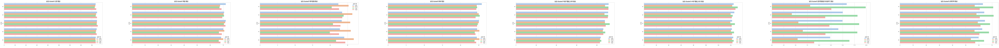

In [ ]:
# cluster0
name_list1 = ['신장', '체중', '체지방율', 'BMI','이완기혈압_최저', '수축기혈압_최고', '앉아윗몸앞으로굽히기', '상대악력']
group_plot2(ddf_newM0, '남성 cluster0',  name_list1)

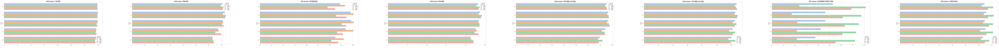

In [ ]:
# cluster1
name_list1 = ['신장', '체중', '체지방율', 'BMI','이완기혈압_최저', '수축기혈압_최고', '앉아윗몸앞으로굽히기', '상대악력']
group_plot2(ddf_newM1, '남성 cluster1',  name_list1)

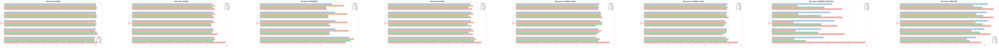

In [ ]:
# cluster2
name_list1 = ['신장', '체중', '체지방율', 'BMI','이완기혈압_최저', '수축기혈압_최고', '앉아윗몸앞으로굽히기', '상대악력']
group_plot2(ddf_newM2, '남성 cluster2',  name_list1)

##### 수치

In [ ]:
# cluster0 나이대 & 상장구분별 평균
M0_신장 = ddf_newM0.groupby(['상장구분','나이대'], as_index=False).mean()[['상장구분', '나이대', '신장']]
M0_체중 = ddf_newM0.groupby(['상장구분','나이대'], as_index=False).mean()[['상장구분', '나이대', '체중']]
M0_BMI = ddf_newM0.groupby(['상장구분', '나이대'], as_index=False).mean()[['상장구분', '나이대', 'BMI']]
M0_체지방율 = ddf_newM0.groupby(['상장구분','나이대'], as_index=False).mean()[['상장구분', '나이대', '체지방율']]
M0_이완기혈압 = ddf_newM0.groupby(['상장구분','나이대'], as_index=False).mean()[['상장구분', '나이대', '이완기혈압_최저']]
M0_수축기혈압 = ddf_newM0.groupby(['상장구분','나이대'], as_index=False).mean()[['상장구분', '나이대', '수축기혈압_최고']]
M0_유연성 = ddf_newM0.groupby(['상장구분','나이대'], as_index=False).mean()[['상장구분', '나이대', '앉아윗몸앞으로굽히기']]
M0_상대악력 = ddf_newM0.groupby(['상장구분','나이대'], as_index=False).mean()[['상장구분', '나이대', '상대악력']]
print('------------------------------------------------------')
print('나이대별 체중의 평균:', M0_체중)
print('------------------------------------------------------')
print('나이대별 신장의 평균:', M0_신장)
print('------------------------------------------------------')
print('나이대별 BMI의 평균:', M0_BMI)
print('------------------------------------------------------')
print('나이대별 체지방율의 평균:', M0_체지방율)
print('------------------------------------------------------')
print('나이대별 이완기혈압(최저)의 평균:', M0_이완기혈압)
print('------------------------------------------------------')
print('나이대별 수축기혈압(최고)의 평균:', M0_수축기혈압)
print('------------------------------------------------------')
print('나이대별 앉아윗몸앞으로굽히기의 평균:', M0_유연성)
print('------------------------------------------------------')
print('나이대별 상대악력의 평균:', M0_상대악력)
print('------------------------------------------------------')

------------------------------------------------------
나이대별 체중의 평균:    상장구분 나이대         체중
0   1등급  20  67.180000
1   1등급  30  70.662500
2   1등급  40  70.623333
3   1등급  50  66.750000
4   1등급  60  66.624592
5   2등급  20  71.962963
6   2등급  30  70.724000
7   2등급  40  72.006000
8   2등급  50  70.167398
9   2등급  60  68.418767
10  3등급  20  68.738158
11  3등급  30  69.333538
12  3등급  40  71.782400
13  3등급  50  68.929675
14  3등급  60  67.916309
15  참가증  20  67.617760
16  참가증  30  70.355846
17  참가증  40  71.553939
18  참가증  50  70.852939
19  참가증  60  69.977020
------------------------------------------------------
나이대별 신장의 평균:    상장구분 나이대          신장
0   1등급  20  165.320000
1   1등급  30  167.062500
2   1등급  40  168.856667
3   1등급  50  167.044000
4   1등급  60  167.027551
5   2등급  20  166.929630
6   2등급  30  169.540000
7   2등급  40  169.484444
8   2등급  50  168.958673
9   2등급  60  167.088150
10  3등급  20  168.063158
11  3등급  30  169.440000
12  3등급  40  170.897600
13  3등급  50  168.951986
14  3등급  60  167.1041

In [ ]:
# cluster1 나이대 & 상장구분별 평균
M1_신장 = ddf_newM1.groupby(['상장구분','나이대'], as_index=False).mean()[['상장구분', '나이대', '신장']]
M1_체중 = ddf_newM1.groupby(['상장구분','나이대'], as_index=False).mean()[['상장구분', '나이대', '체중']]
M1_BMI = ddf_newM1.groupby(['상장구분', '나이대'], as_index=False).mean()[['상장구분', '나이대', 'BMI']]
M1_체지방율 = ddf_newM1.groupby(['상장구분','나이대'], as_index=False).mean()[['상장구분', '나이대', '체지방율']]
M1_이완기혈압 = ddf_newM1.groupby(['상장구분','나이대'], as_index=False).mean()[['상장구분', '나이대', '이완기혈압_최저']]
M1_수축기혈압 = ddf_newM1.groupby(['상장구분','나이대'], as_index=False).mean()[['상장구분', '나이대', '수축기혈압_최고']]
M1_유연성 = ddf_newM1.groupby(['상장구분','나이대'], as_index=False).mean()[['상장구분', '나이대', '앉아윗몸앞으로굽히기']]
M1_상대악력 = ddf_newM1.groupby(['상장구분','나이대'], as_index=False).mean()[['상장구분', '나이대', '상대악력']]
print('------------------------------------------------------')
print('나이대별 체중의 평균:', M1_체중)
print('------------------------------------------------------')
print('나이대별 신장의 평균:', M1_신장)
print('------------------------------------------------------')
print('나이대별 BMI의 평균:', M1_BMI)
print('------------------------------------------------------')
print('나이대별 체지방율의 평균:', M1_체지방율)
print('------------------------------------------------------')
print('나이대별 이완기혈압(최저)의 평균:', M1_이완기혈압)
print('------------------------------------------------------')
print('나이대별 수축기혈압(최고)의 평균:', M1_수축기혈압)
print('------------------------------------------------------')
print('나이대별 앉아윗몸앞으로굽히기의 평균:', M1_유연성)
print('------------------------------------------------------')
print('나이대별 상대악력의 평균:', M1_상대악력)
print('------------------------------------------------------')

------------------------------------------------------
나이대별 체중의 평균:    상장구분 나이대         체중
0   1등급  20  71.487420
1   1등급  30  73.386885
2   1등급  40  70.429714
3   1등급  50  65.130732
4   1등급  60  63.672857
5   2등급  20  70.950159
6   2등급  30  72.890843
7   2등급  40  71.686173
8   2등급  50  69.707805
9   2등급  60  64.176111
10  3등급  20  70.560820
11  3등급  30  72.596313
12  3등급  40  71.100853
13  3등급  50  67.301031
14  3등급  60  63.040227
15  참가증  20  69.266871
16  참가증  30  71.065825
17  참가증  40  71.398295
18  참가증  50  67.895962
19  참가증  60  62.965000
------------------------------------------------------
나이대별 신장의 평균:    상장구분 나이대          신장
0   1등급  20  174.029275
1   1등급  30  174.223770
2   1등급  40  172.824286
3   1등급  50  170.934146
4   1등급  60  170.176786
5   2등급  20  174.174510
6   2등급  30  174.285421
7   2등급  40  174.227160
8   2등급  50  172.834146
9   2등급  60  170.519444
10  3등급  20  174.249028
11  3등급  30  175.054040
12  3등급  40  174.245024
13  3등급  50  172.339175
14  3등급  60  172.0863

In [ ]:
# cluster2 나이대 & 상장구분별 평균
M2_신장 = ddf_newM2.groupby(['상장구분','나이대'], as_index=False).mean()[['상장구분', '나이대', '신장']]
M2_체중 = ddf_newM2.groupby(['상장구분','나이대'], as_index=False).mean()[['상장구분', '나이대', '체중']]
M2_BMI = ddf_newM2.groupby(['상장구분', '나이대'], as_index=False).mean()[['상장구분', '나이대', 'BMI']]
M2_체지방율 = ddf_newM2.groupby(['상장구분','나이대'], as_index=False).mean()[['상장구분', '나이대', '체지방율']]
M2_이완기혈압 = ddf_newM2.groupby(['상장구분','나이대'], as_index=False).mean()[['상장구분', '나이대', '이완기혈압_최저']]
M2_수축기혈압 = ddf_newM2.groupby(['상장구분','나이대'], as_index=False).mean()[['상장구분', '나이대', '수축기혈압_최고']]
M2_유연성 = ddf_newM2.groupby(['상장구분','나이대'], as_index=False).mean()[['상장구분', '나이대', '앉아윗몸앞으로굽히기']]
M2_상대악력 = ddf_newM2.groupby(['상장구분','나이대'], as_index=False).mean()[['상장구분', '나이대', '상대악력']]
print('------------------------------------------------------')
print('나이대별 체중의 평균:', M2_체중)
print('------------------------------------------------------')
print('나이대별 신장의 평균:', M2_신장)
print('------------------------------------------------------')
print('나이대별 BMI의 평균:', M2_BMI)
print('------------------------------------------------------')
print('나이대별 체지방율의 평균:', M2_체지방율)
print('------------------------------------------------------')
print('나이대별 이완기혈압(최저)의 평균:', M2_이완기혈압)
print('------------------------------------------------------')
print('나이대별 수축기혈압(최고)의 평균:', M2_수축기혈압)
print('------------------------------------------------------')
print('나이대별 앉아윗몸앞으로굽히기의 평균:', M2_유연성)
print('------------------------------------------------------')
print('나이대별 상대악력의 평균:', M2_상대악력)
print('------------------------------------------------------')

------------------------------------------------------
나이대별 체중의 평균:    상장구분 나이대         체중
0   1등급  20  87.772727
1   1등급  30  86.744800
2   1등급  40  84.640000
3   1등급  50  90.766667
4   1등급  60  99.300000
5   2등급  20  84.823065
6   2등급  30  85.929748
7   2등급  40  85.698077
8   2등급  50  86.454286
9   2등급  60  86.900000
10  3등급  20  85.290498
11  3등급  30  84.972045
12  3등급  40  83.679540
13  3등급  50  84.571875
14  3등급  60  86.141860
15  참가증  20  87.535475
16  참가증  30  87.800512
17  참가증  40  87.141654
18  참가증  50  86.347258
19  참가증  60  87.836680
------------------------------------------------------
나이대별 신장의 평균:    상장구분 나이대          신장
0   1등급  20  177.200000
1   1등급  30  177.180000
2   1등급  40  175.325000
3   1등급  50  179.566667
4   1등급  60  178.500000
5   2등급  20  175.902419
6   2등급  30  175.926050
7   2등급  40  176.301923
8   2등급  50  176.525000
9   2등급  60  174.347368
10  3등급  20  177.959004
11  3등급  30  177.467045
12  3등급  40  177.701149
13  3등급  50  177.700000
14  3등급  60  173.3767

## [5] 여성 데이터로 모델링(군집화)

### (1) 표준화 / 군집 수 정하기(엘보우)

In [ ]:
# 표준화
ddf_scaled_F = ddf_sc.fit_transform(ddf_fit6)
pd.DataFrame(ddf_scaled_F)


,0,1,2,3,4,5,6,7,8
0,-0.987359,1.269118,0.113064,-0.198877,-1.901912,-1.456100,-0.145084,-0.524500,0.186641
1,0.126013,0.468593,0.421273,-0.696787,0.444972,-0.574976,0.647409,0.173933,-0.099095
2,0.419006,-1.508214,-0.503355,1.499875,-2.089662,-0.323226,-0.093956,0.261238,-0.123942
3,0.477604,-1.148795,0.344220,1.617030,-0.212155,-0.008539,-0.643588,1.017873,-2.111670
4,1.004991,0.288883,0.047019,-0.491766,0.163346,1.879585,0.992527,-0.117080,0.621457
...,...,...,...,...,...,...,...,...,...
10949,-0.284177,0.174523,-1.218841,-1.297208,-0.212155,-0.637913,0.200034,-1.339338,0.074831
10950,-1.338950,1.203769,-0.778542,-1.223986,-0.775408,-0.260288,0.072212,-1.339338,2.124676
10951,-1.104556,2.004295,0.135078,-1.707252,1.008224,0.494961,0.506805,-0.815513,0.720843
10952,-0.108381,0.909699,-0.085071,-0.213522,0.163346,-0.323226,0.698538,-0.524500,0.410260


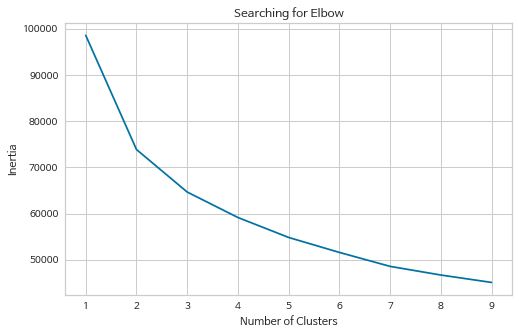

In [ ]:
# 군집 수 정하기 
ddf_Xf = ddf_scaled_F.copy()

clusters =[]
for i in range(1, 10):
    km = KMeans(n_clusters=i, random_state=0).fit(ddf_Xf)
    clusters.append(km.inertia_)
    
fig, ax = plt.subplots(figsize=(8, 5))
sns.lineplot(x=list(range(1, 10)), y=clusters, ax=ax)
ax.set_title('Searching for Elbow')
ax.set_xlabel('Number of Clusters')
ax.set_ylabel('Inertia')
plt.show() # 2, 3중에서 선택

In [ ]:
# ddf_scaled_F 데이터를 넣어 클러스터링
ddf_km3_F = KMeans(n_clusters=3, random_state = 0)
ddf_clustersF = ddf_km3_F.fit(ddf_Xf)

# 클러스터일 변수인 ddf_clusters 값을 원본 데이터인 ddf_fit5에 넣기
ddf_fit6["Clusters"] = ddf_clustersF.labels_
ddf_fit6.head()

,나이,신장,체중,체지방율,이완기혈압_최저,수축기혈압_최고,앉아윗몸앞으로굽히기,BMI,상대악력,Clusters
0,27,166.9,60.0,30.2,55.0,103.0,14.4,21.5,47.0,1
1,46,162.0,62.8,26.8,80.0,117.0,20.6,23.9,44.7,1
2,51,149.9,54.4,41.8,53.0,121.0,14.8,24.2,44.5,0
3,52,152.1,62.1,42.6,73.0,126.0,10.5,26.8,28.5,2
4,61,160.9,59.4,28.2,77.0,156.0,23.3,22.9,50.5,0


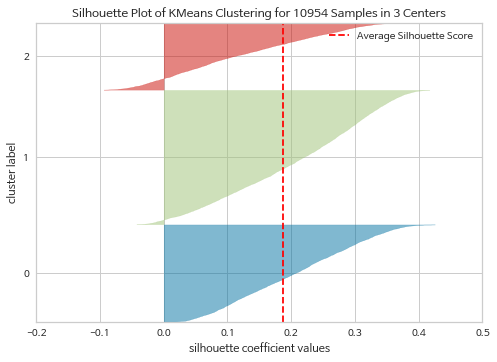

모든 데이터의 평균 실루엣 계수값: 0.18714168503564443


In [ ]:
# 실루엣 계수 시각화
#visualizer 생성
visualizer_3 = SilhouetteVisualizer(ddf_km3_F, colors='yellowbrick')
#생성된 visualizer에 데이터 입력 
visualizer_3.fit(ddf_Xf)      
visualizer_3.show()

average_score_F = silhouette_score(ddf_Xf, ddf_fit6["Clusters"])
print('모든 데이터의 평균 실루엣 계수값:', format(average_score_F)) 


In [ ]:
ddf_dv_F = davies_bouldin_score(ddf_Xf, ddf_fit6["Clusters"])
print('데이비스-볼딘지수:', format(ddf_dv_F)) 

데이비스-볼딘지수: 1.6935965475218453


### (2) 클러스터링 결과 확인

In [ ]:
# 클러스터별 개수
ddf_fit6.groupby('Clusters').count()

,나이,신장,체중,체지방율,이완기혈압_최저,수축기혈압_최고,앉아윗몸앞으로굽히기,BMI,상대악력
Clusters,,,,,,,,,
0,3571,3571,3571,3571,3571,3571,3571,3571,3571
1,4937,4937,4937,4937,4937,4937,4937,4937,4937
2,2446,2446,2446,2446,2446,2446,2446,2446,2446


- cluster1에 해당하는 수가 4937로 가장 많다. 그 다음으로는 clsster0(3571), cluster2(2446) 순이다. 

In [ ]:
# 클러스터별 평균
ddf_fit6.groupby('Clusters').mean()

,나이,신장,체중,체지방율,이완기혈압_최저,수축기혈압_최고,앉아윗몸앞으로굽히기,BMI,상대악력
Clusters,,,,,,,,,
0,58.827219,154.787426,56.437051,32.862935,79.973145,137.189835,16.390095,23.563316,44.723719
1,32.698602,161.638282,54.841053,27.043456,70.550658,116.212700,16.442418,20.968017,49.698623
2,44.490188,160.415004,71.014546,38.765213,77.884301,130.025797,12.455323,27.632829,38.148324


- 각 클러스터별 평균값은 위와 같다.
- 전반적인 평균 수치를 보았을 때 cluster2의 평균 체력이 상대적으로 낮다는 것을 확인할 수 있다. 

### (3) 클러스터링 결과 시각화(차원 축소 활용)


In [ ]:
# 클러스터링 시각화
ddf_X_F = ddf_Xf.copy()

#객체
ddf_pca = PCA(n_components=2)

#적용
ddf_pca.fit(ddf_X_F)
ddf_pcaF = ddf_pca.transform(ddf_X_F)
ddf_pcaF

array([[-1.67570278,  2.22527715],
       [-0.19995721,  0.29103488],
       [ 0.38875348, -0.08496033],
       ...,
       [-1.61235963,  0.47139031],
       [-0.82598748,  0.23952776],
       [-2.00552437,  1.34429984]])

In [ ]:
#ddf_pca를 보기 쉽게 데이터프레임으로 만들기
ddf_pca_dfF = pd.DataFrame(ddf_pcaF)
ddf_pca_dfF['Clusters'] = ddf_fit6['Clusters'] 
ddf_pca_dfF.head()

,0,1,Clusters
0,-1.675703,2.225277,1
1,-0.199957,0.291035,1
2,0.388753,-0.084960,0
3,2.464719,0.278669,2
4,0.222675,-1.499553,0


/usr/local/lib/python3.8/dist-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


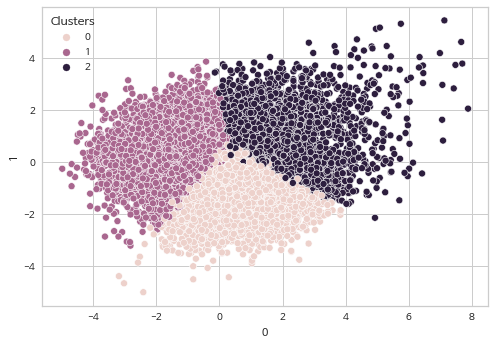

In [ ]:
ddf_axsF = plt.subplots()
ddf_axsF = sns.scatterplot(0, 1, hue='Clusters', data=ddf_pca_dfF)

## [6] 여성 데이터 클러스터별 특징 파악

In [ ]:
# 클러스터링 결과와 기존의 상장구분을 포함한 데이터프레임 생성
ddf_newF = ddf_fit6.copy()
ddf_newF['상장구분'] = ddf_fit6_8[['상장구분']]
ddf_newF['나이대'] = ddf_fit6_8[['나이대']]
ddf_newF

,나이,신장,체중,체지방율,이완기혈압_최저,수축기혈압_최고,앉아윗몸앞으로굽히기,BMI,상대악력,Clusters,상장구분,나이대
0,27,166.9,60.0,30.2,55.0,103.0,14.4,21.5,47.0,1,3등급,20
1,46,162.0,62.8,26.8,80.0,117.0,20.6,23.9,44.7,1,3등급,40
2,51,149.9,54.4,41.8,53.0,121.0,14.8,24.2,44.5,0,참가증,50
3,52,152.1,62.1,42.6,73.0,126.0,10.5,26.8,28.5,2,참가증,50
4,61,160.9,59.4,28.2,77.0,156.0,23.3,22.9,50.5,0,참가증,60
...,...,...,...,...,...,...,...,...,...,...,...,...
10949,39,160.2,47.9,22.7,73.0,116.0,17.1,18.7,46.1,1,참가증,30
10950,21,166.5,51.9,23.2,67.0,122.0,16.1,18.7,62.6,1,2등급,20
10951,25,171.4,60.2,19.9,86.0,134.0,19.5,20.5,51.3,1,1등급,20
10952,42,164.7,58.2,30.1,77.0,121.0,21.0,21.5,48.8,1,3등급,40


### (1) 클러스터별 상장구분의 비율

In [ ]:
ddf_newF_group = ddf_newF.groupby(['Clusters','상장구분'], as_index=False).count()[['Clusters', '상장구분', '나이']]

In [ ]:
#ddf_newF_group에서 cluster별 상장구분1,2,3,4 비율을 for문으로 뽑기.
ddf11 = (ddf_newF_group['상장구분']=='1등급') #1등급
ddf22 = (ddf_newF_group['상장구분']=='2등급') #2등급
ddf33 = (ddf_newF_group['상장구분']=='3등급') #3등급
ddf44 = (ddf_newF_group['상장구분']=='참가증') #참가증

for i in range(0, 3):
    tmp3 = (ddf_newF_group['Clusters']==i)
    print('Cluster '+ str(i) + '의 1등급 비율은 ' + str(round((ddf_newF_group.loc[(tmp3 & ddf11),  '나이'].sum() / ddf_newF_group.loc[tmp3, '나이'].sum())*100, 4)) + '%')
    print('Cluster '+ str(i) + '의 2등급 비율은 ' + str(round((ddf_newF_group.loc[(tmp3 & ddf22),  '나이'].sum() / ddf_newF_group.loc[tmp3, '나이'].sum())*100, 4)) + '%')
    print('Cluster '+ str(i) + '의 3등급 비율은 ' + str(round((ddf_newF_group.loc[(tmp3 & ddf33),  '나이'].sum() / ddf_newF_group.loc[tmp3, '나이'].sum())*100, 4)) + '%')
    print('Cluster '+ str(i) + '의 참가증 비율은 ' + str(round((ddf_newF_group.loc[(tmp3 & ddf44), '나이'].sum() / ddf_newF_group.loc[tmp3, '나이'].sum())*100, 4)) + '%')
    print(' ')

Cluster 0의 1등급 비율은 5.9367%
Cluster 0의 2등급 비율은 18.0902%
Cluster 0의 3등급 비율은 27.8353%
Cluster 0의 참가증 비율은 48.1378%
 
Cluster 1의 1등급 비율은 14.1381%
Cluster 1의 2등급 비율은 22.2807%
Cluster 1의 3등급 비율은 27.0205%
Cluster 1의 참가증 비율은 36.5607%
 
Cluster 2의 1등급 비율은 0.3679%
Cluster 2의 2등급 비율은 4.8242%
Cluster 2의 3등급 비율은 8.0948%
Cluster 2의 참가증 비율은 86.713%
 


- cluster2가 다른 클러스터에 비해 참가증을 받은 비율이 높다. 이 이유를 분석하면 좋을 것 같다.

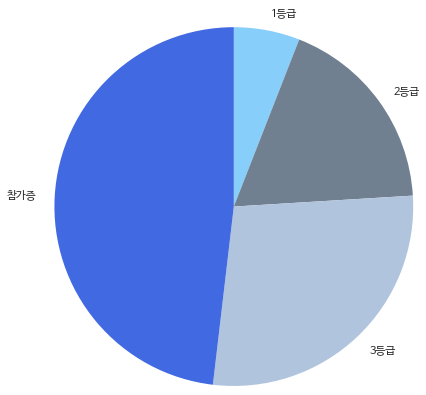

In [ ]:
# 클러스터별 상장구분 시각화
# cluster0
ratioF0 = [5.9367, 18.0902, 27.8353, 48.1378]
labels = ['1등급', '2등급', '3등급', '참가증']
colors = ['lightskyblue', 'slategrey', 'lightsteelblue', 'royalblue']
textprops = dict(size=11, weight=4)
plt.pie(ratioF0,labels = labels, startangle = 90, counterclock=False, textprops=textprops, colors = colors,radius=1.5)
plt.show()


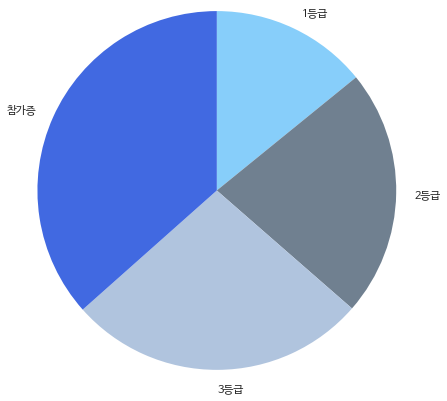

In [ ]:
# cluster1
ratioF1 = [14.1381, 22.2807, 27.0205, 36.5607]
labels = ['1등급', '2등급', '3등급', '참가증']
colors = ['lightskyblue', 'slategrey', 'lightsteelblue', 'royalblue']
textprops = dict(size=11, weight=4)
plt.pie(ratioF1,labels = labels, startangle = 90, counterclock=False, textprops=textprops, colors = colors, radius=1.5)
plt.show()

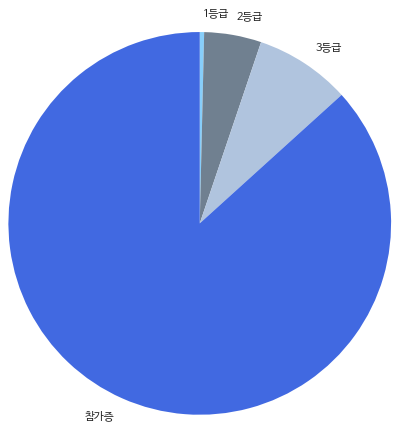

In [ ]:
# cluster2
ratioF2 = [0.3679, 4.8242, 8.0948, 86.713]
labels = ['1등급', '2등급', '3등급', '참가증']
colors = ['lightskyblue', 'slategrey', 'lightsteelblue', 'royalblue']
textprops = dict(size=11, weight=4)
plt.pie(ratioF2,labels = labels, startangle = 90, counterclock=False, textprops=textprops, colors = colors, radius=1.6)
plt.show()

### (2) 클러스터별 나이대의 비율

In [ ]:
ddf_newF_group1 = ddf_newF.groupby(['Clusters','나이대'], as_index=False).count()[['Clusters', '나이대', '나이']]

In [ ]:
#ddf_newF_group에서 cluster별 상장구분1,2,3,4 비율을 for문으로 뽑기.
ddf1 = (ddf_newF_group1['나이대']== 20) 
ddf2 = (ddf_newF_group1['나이대']== 30) 
ddf3 = (ddf_newF_group1['나이대']== 40) 
ddf4 = (ddf_newF_group1['나이대']== 50)
ddf5 = (ddf_newF_group1['나이대']== 60)  

for i in range(0, 3):
    tmp3 = (ddf_newF_group1['Clusters']==i)
    print('Cluster '+ str(i) + '의 20대 비율은 ' + str(round((ddf_newF_group1.loc[(tmp3 & ddf1),  '나이'].sum() / ddf_newF_group1.loc[tmp3, '나이'].sum())*100, 5)) + '%')
    print('Cluster '+ str(i) + '의 30대 비율은 ' + str(round((ddf_newF_group1.loc[(tmp3 & ddf2),  '나이'].sum() / ddf_newF_group1.loc[tmp3, '나이'].sum())*100, 5)) + '%')
    print('Cluster '+ str(i) + '의 40대 비율은 ' + str(round((ddf_newF_group1.loc[(tmp3 & ddf3),  '나이'].sum() / ddf_newF_group1.loc[tmp3, '나이'].sum())*100, 5)) + '%')
    print('Cluster '+ str(i) + '의 50대 비율은 ' + str(round((ddf_newF_group1.loc[(tmp3 & ddf4),  '나이'].sum() / ddf_newF_group1.loc[tmp3, '나이'].sum())*100, 5)) + '%')
    print('Cluster '+ str(i) + '의 60대 비율은 ' + str(round((ddf_newF_group1.loc[(tmp3 & ddf5),  '나이'].sum() / ddf_newF_group1.loc[tmp3, '나이'].sum())*100, 5)) + '%')
    print(' ')

Cluster 0의 20대 비율은 2.04425%
Cluster 0의 30대 비율은 1.7082%
Cluster 0의 40대 비율은 7.61691%
Cluster 0의 50대 비율은 32.28787%
Cluster 0의 60대 비율은 56.34276%
 
Cluster 1의 20대 비율은 55.84363%
Cluster 1의 30대 비율은 16.58902%
Cluster 1의 40대 비율은 12.47721%
Cluster 1의 50대 비율은 9.84403%
Cluster 1의 60대 비율은 5.2461%
 
Cluster 2의 20대 비율은 28.78168%
Cluster 2의 30대 비율은 10.58872%
Cluster 2의 40대 비율은 14.43173%
Cluster 2의 50대 비율은 21.66803%
Cluster 2의 60대 비율은 24.52984%
 


체력 데이터의 평균 수치 가장 좋지 않고, 참가증을 가장 많이 받은 clusters2의 나이대 비율을 보면 30대와 40대가, 20대,50대,60대가 비슷하다.

####1. 클러스터에 따른 나이대별 상장구분 수

In [ ]:
ddf_newF_비율 = ddf_newF.groupby(['Clusters','나이대', '상장구분'], as_index=False).count()[['Clusters', '나이대', '상장구분', '나이']]
ddf_newF_비율

,Clusters,나이대,상장구분,나이
0,0,20,1등급,1
1,0,20,2등급,13
2,0,20,3등급,27
3,0,20,참가증,32
4,0,30,1등급,3
5,0,30,2등급,5
6,0,30,3등급,18
7,0,30,참가증,35
8,0,40,1등급,14
9,0,40,2등급,34


In [ ]:
# Cluster 0 분리
ddf_newF0 = ddf_newF[ddf_newF['Clusters'] == 0]
ddf_newF0.describe()

,나이,신장,체중,체지방율,이완기혈압_최저,수축기혈압_최고,앉아윗몸앞으로굽히기,BMI,상대악력,Clusters,나이대
count,3571.000000,3571.000000,3571.000000,3571.000000,3571.000000,3571.000000,3571.000000,3571.000000,3571.000000,3571.0,3571.000000
mean,58.827219,154.787426,56.437051,32.862935,79.973145,137.189835,16.390095,23.563316,44.723719,0.0,53.917670
std,8.786104,5.072633,5.447684,5.076026,9.779328,13.665719,6.224849,2.121845,6.637412,0.0,8.594373
min,20.000000,127.300000,30.200000,6.900000,46.000000,95.000000,-17.000000,15.200000,24.000000,0.0,20.000000
25%,55.000000,151.700000,52.860000,29.900000,73.000000,127.000000,12.750000,22.100000,40.300000,0.0,50.000000
50%,61.000000,154.800000,56.800000,33.300000,80.000000,138.000000,17.000000,23.600000,44.600000,0.0,60.000000
75%,65.000000,158.100000,60.400000,36.300000,87.000000,148.000000,20.700000,25.000000,49.100000,0.0,60.000000
max,69.000000,172.700000,71.500000,68.100000,105.000000,174.000000,35.200000,30.900000,67.400000,0.0,60.000000


In [ ]:
# Cluster 1 분리
ddf_newF1 = ddf_newF[ddf_newF['Clusters'] == 1]
ddf_newF1.describe()

,나이,신장,체중,체지방율,이완기혈압_최저,수축기혈압_최고,앉아윗몸앞으로굽히기,BMI,상대악력,Clusters,나이대
count,4937.000000,4937.000000,4937.000000,4937.000000,4937.000000,4937.000000,4937.000000,4937.000000,4937.000000,4937.0,4937.000000
mean,32.698602,161.638282,54.841053,27.043456,70.550658,116.212700,16.442418,20.968017,49.698623,1.0,29.205996
std,13.012208,5.145792,6.157062,5.178529,9.453914,11.412287,8.298831,1.927822,7.031598,0.0,12.422266
min,20.000000,144.800000,35.100000,7.900000,46.000000,79.000000,-20.000000,14.300000,23.400000,1.0,20.000000
25%,22.000000,158.100000,50.600000,23.500000,64.000000,108.000000,11.900000,19.600000,44.900000,1.0,20.000000
50%,28.000000,161.600000,54.700000,27.300000,70.000000,116.000000,17.500000,21.000000,49.700000,1.0,20.000000
75%,41.000000,165.100000,58.900000,30.900000,77.000000,123.000000,22.100000,22.300000,54.400000,1.0,40.000000
max,69.000000,182.600000,79.000000,43.300000,99.000000,163.100000,35.200000,27.300000,67.700000,1.0,60.000000


In [ ]:
# Cluster 2 분리
ddf_newF2 = ddf_newF[ddf_newF['Clusters'] == 2]
ddf_newF2.describe()

,나이,신장,체중,체지방율,이완기혈압_최저,수축기혈압_최고,앉아윗몸앞으로굽히기,BMI,상대악력,Clusters,나이대
count,2446.000000,2446.000000,2446.000000,2446.000000,2446.000000,2446.000000,2446.000000,2446.000000,2446.000000,2446.0,2446.000000
mean,44.490188,160.415004,71.014546,38.765213,77.884301,130.025797,12.455323,27.632829,38.148324,2.0,40.257563
std,16.464044,5.910109,7.808287,4.640996,10.207505,14.247488,8.147284,2.993573,5.966040,0.0,15.669617
min,20.000000,142.600000,54.000000,22.900000,46.000000,90.000000,-21.000000,20.800000,23.000000,2.0,20.000000
25%,27.000000,156.600000,65.700000,35.600000,71.000000,120.000000,7.900000,25.600000,34.200000,2.0,20.000000
50%,47.000000,160.200000,69.600000,38.400000,78.000000,129.000000,13.700000,27.150000,38.200000,2.0,40.000000
75%,59.000000,164.300000,74.600000,41.800000,85.000000,140.000000,18.300000,29.300000,42.200000,2.0,50.000000
max,69.000000,180.700000,115.100000,54.200000,104.000000,172.000000,31.100000,43.500000,66.100000,2.0,60.000000


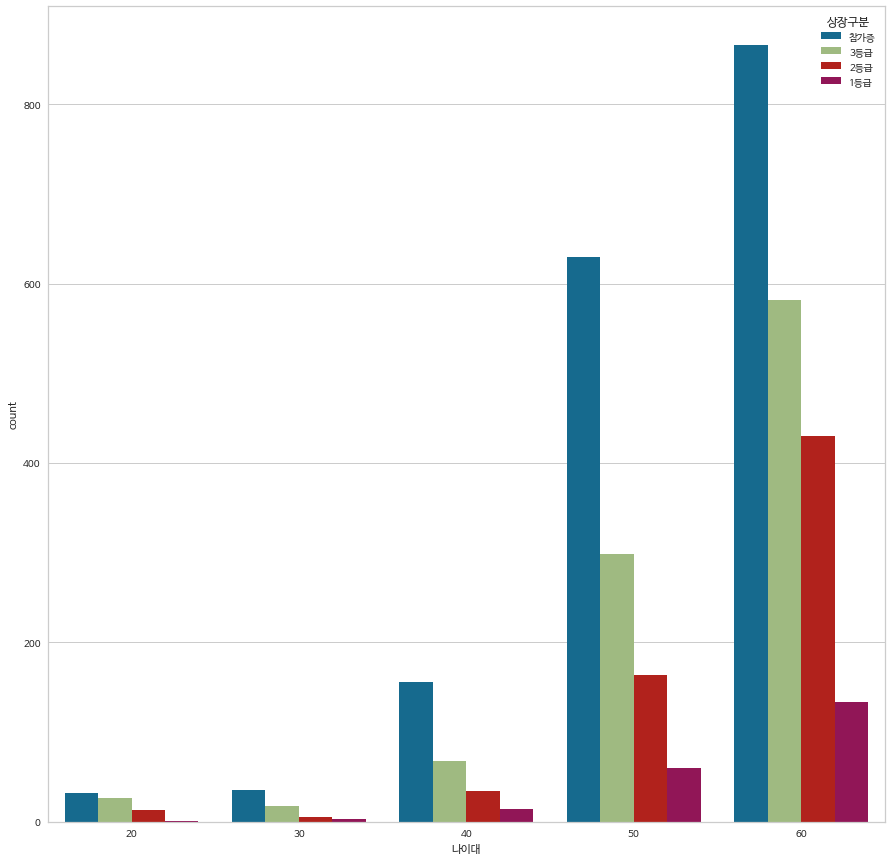

In [ ]:
# Cluster0의 나이대 & 상장구분에 따른 빈도 시각화
plt.figure(figsize = (15,15))
sns.countplot(data = ddf_newF0, x = "나이대", hue = '상장구분')

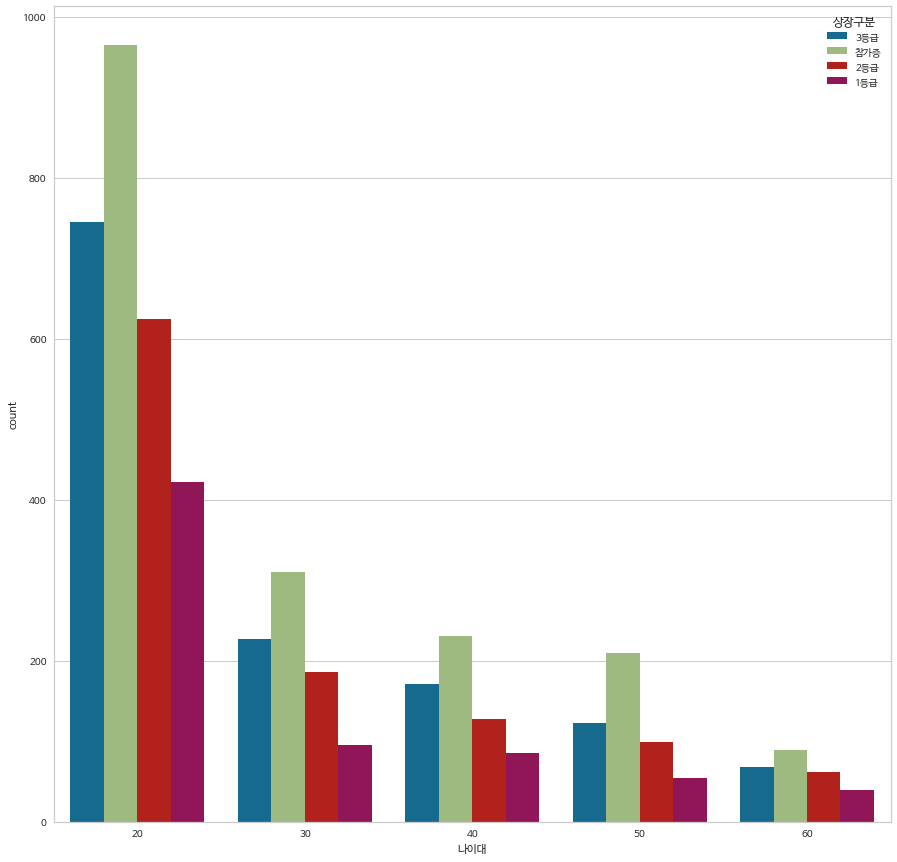

In [ ]:
# Cluster1의 나이대 & 상장구분에 따른
plt.figure(figsize = (15,15))
sns.countplot(data = ddf_newF1, x = "나이대", hue = '상장구분')

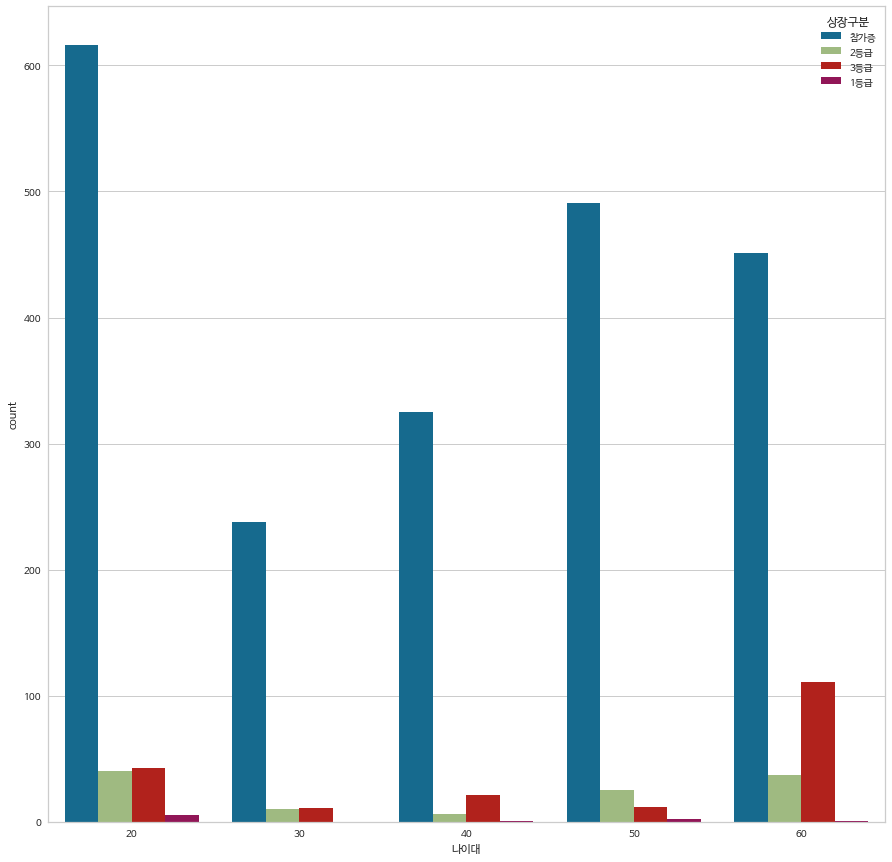

In [ ]:
# Cluster2의 나이대 & 상장구분에 따른
plt.figure(figsize = (15,15))
sns.countplot(data = ddf_newF2, x = "나이대", hue = '상장구분')

### (3) 클러스터별 탐색



#### 클러스터에 따른 나이대별 평균

In [ ]:
# 군집 시각화할 수 있는 함수 만들기1: 나이대별
'''
def group_plot(df, text, name_list):

  fig, axes = plt.subplots(1,len(name_list),figsize=(110, 6))
  plt.subplots_adjust(wspace=0.3, hspace = 0.5)

  for i in range(len(name_list)):

    plot1 = sns.barplot(x=name_list[i], y = '나이대', data=df, orient='h', ci=None , ax=axes[i], estimator = np.mean) 
    plot1.set_title(f'{text}' + ' ' + name_list[i] + ' ' + '평균' ,fontsize=15 , weight='bold')
    plot1.set_xlabel(' ')
    plot1.set_ylabel('나이대')

  plt.show()
 '''   

"\ndef group_plot(df, text, name_list):\n\n  fig, axes = plt.subplots(1,len(name_list),figsize=(110, 6))\n  plt.subplots_adjust(wspace=0.3, hspace = 0.5)\n\n  for i in range(len(name_list)):\n\n    plot1 = sns.barplot(x=name_list[i], y = '나이대', data=df, orient='h', ci=None , ax=axes[i], estimator = np.mean) \n    plot1.set_title(f'{text}' + ' ' + name_list[i] + ' ' + '평균' ,fontsize=15 , weight='bold')\n    plot1.set_xlabel(' ')\n    plot1.set_ylabel('나이대')\n\n  plt.show()\n "

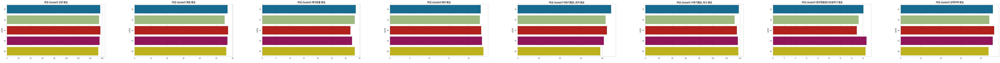

In [ ]:
# cluster0
name_list = ['신장', '체중', '체지방율', 'BMI','이완기혈압_최저', '수축기혈압_최고', '앉아윗몸앞으로굽히기', '상대악력']
group_plot(ddf_newF0, '여성 cluster0',  name_list)

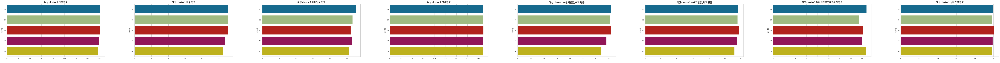

In [ ]:
# cluster1
name_list = ['신장', '체중', '체지방율', 'BMI','이완기혈압_최저', '수축기혈압_최고', '앉아윗몸앞으로굽히기', '상대악력']
group_plot(ddf_newF1, '여성 cluster1',  name_list)

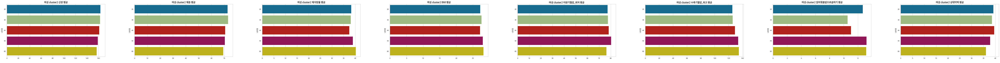

In [ ]:
# cluster2
name_list = ['신장', '체중', '체지방율', 'BMI','이완기혈압_최저', '수축기혈압_최고', '앉아윗몸앞으로굽히기', '상대악력']
group_plot(ddf_newF2, '여성 cluster2',  name_list)

#### 클러스터에 따른 상장구분별 평균

In [ ]:
# 군집 시각화할 수 있는 함수 만들기2: 상장구분
'''
def group_plot1(df, text, name_list):

  fig, axes = plt.subplots(1,len(name_list),figsize=(110, 6))
  plt.subplots_adjust(wspace=0.3, hspace = 0.5)

  for i in range(len(name_list)):

    plot1 = sns.barplot(x=name_list[i], y = '상장구분', data=df, orient='h', ci=None , ax=axes[i], estimator = np.mean) 
    plot1.set_title(f'{text}' + ' ' + name_list[i] + ' ' + '평균' ,fontsize=15 , weight='bold')
    plot1.set_xlabel(' ')
    plot1.set_ylabel('상장구분')

  plt.show()
'''

"\ndef group_plot1(df, text, name_list):\n\n  fig, axes = plt.subplots(1,len(name_list),figsize=(110, 6))\n  plt.subplots_adjust(wspace=0.3, hspace = 0.5)\n\n  for i in range(len(name_list)):\n\n    plot1 = sns.barplot(x=name_list[i], y = '상장구분', data=df, orient='h', ci=None , ax=axes[i], estimator = np.mean) \n    plot1.set_title(f'{text}' + ' ' + name_list[i] + ' ' + '평균' ,fontsize=15 , weight='bold')\n    plot1.set_xlabel(' ')\n    plot1.set_ylabel('상장구분')\n\n  plt.show()\n"

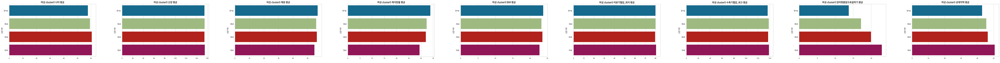

In [ ]:
# cluster0
name_list = ['나이','신장', '체중', '체지방율', 'BMI','이완기혈압_최저', '수축기혈압_최고', '앉아윗몸앞으로굽히기', '상대악력']
group_plot1(ddf_newF0, '여성 cluster0',  name_list)

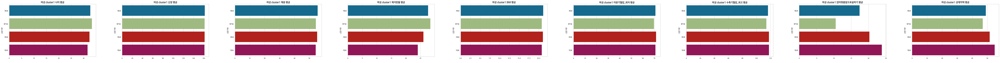

In [ ]:
# cluster1
name_list = ['나이','신장', '체중', '체지방율', 'BMI','이완기혈압_최저', '수축기혈압_최고', '앉아윗몸앞으로굽히기', '상대악력']
group_plot1(ddf_newF1, '여성 cluster1',  name_list)

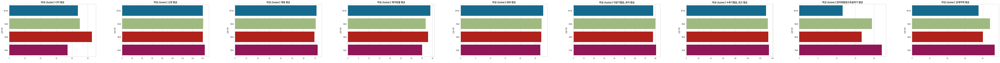

In [ ]:
# cluster2
name_list = ['나이','신장', '체중', '체지방율', 'BMI','이완기혈압_최저', '수축기혈압_최고', '앉아윗몸앞으로굽히기', '상대악력']
group_plot1(ddf_newF2, '여성 cluster2',  name_list)

#### 클러스터에 따른 나이대&상장구분별 평균

##### 시각화

In [ ]:
# 군집 시각화할 수 있는 함수 만들기2: 상장구분
'''
def group_plot2(df, text, name_list):

  fig, axes = plt.subplots(1,len(name_list),figsize=(185, 8))
  plt.subplots_adjust(wspace=0.3, hspace = 0.5)

  for i in range(len(name_list)):

    plot1 = sns.barplot(x=name_list[i], y = '나이대',hue = '상장구분', data=df, palette='pastel', orient='h', ci=None , ax=axes[i], estimator = np.mean) 
    plot1.set_title(f'{text}' + ' ' + name_list[i] + ' ' + '평균' ,fontsize=15 , weight='bold')
    plot1.set_xlabel(' ')
    plot1.set_ylabel('나이대')

  plt.show()
  '''

"\ndef group_plot2(df, text, name_list):\n\n  fig, axes = plt.subplots(1,len(name_list),figsize=(185, 8))\n  plt.subplots_adjust(wspace=0.3, hspace = 0.5)\n\n  for i in range(len(name_list)):\n\n    plot1 = sns.barplot(x=name_list[i], y = '나이대',hue = '상장구분', data=df, palette='pastel', orient='h', ci=None , ax=axes[i], estimator = np.mean) \n    plot1.set_title(f'{text}' + ' ' + name_list[i] + ' ' + '평균' ,fontsize=15 , weight='bold')\n    plot1.set_xlabel(' ')\n    plot1.set_ylabel('나이대')\n\n  plt.show()\n  "

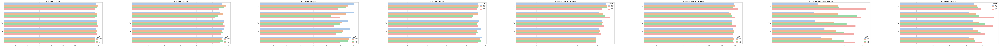

In [ ]:
# cluster0
name_list1 = ['신장', '체중', '체지방율', 'BMI','이완기혈압_최저', '수축기혈압_최고', '앉아윗몸앞으로굽히기', '상대악력']
group_plot2(ddf_newF0, '여성 cluster0',  name_list1)

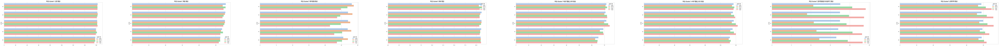

In [ ]:
# cluster1
name_list1 = ['신장', '체중', '체지방율', 'BMI','이완기혈압_최저', '수축기혈압_최고', '앉아윗몸앞으로굽히기', '상대악력']
group_plot2(ddf_newF1, '여성 cluster1',  name_list1)

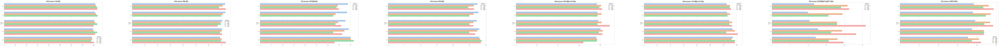

In [ ]:
# cluster2
name_list1 = ['신장', '체중', '체지방율', 'BMI','이완기혈압_최저', '수축기혈압_최고', '앉아윗몸앞으로굽히기', '상대악력']
group_plot2(ddf_newF2, '여성 cluster2',  name_list1)

##### 수치

In [ ]:
# cluster0 나이대 & 상장구분별 평균
F0_신장 = ddf_newF0.groupby(['상장구분','나이대'], as_index=False).mean()[['상장구분', '나이대', '신장']]
F0_체중 = ddf_newF0.groupby(['상장구분','나이대'], as_index=False).mean()[['상장구분', '나이대', '체중']]
F0_BMI = ddf_newF0.groupby(['상장구분', '나이대'], as_index=False).mean()[['상장구분', '나이대', 'BMI']]
F0_체지방율 = ddf_newF0.groupby(['상장구분','나이대'], as_index=False).mean()[['상장구분', '나이대', '체지방율']]
F0_이완기혈압 = ddf_newF0.groupby(['상장구분','나이대'], as_index=False).mean()[['상장구분', '나이대', '이완기혈압_최저']]
F0_수축기혈압 = ddf_newF0.groupby(['상장구분','나이대'], as_index=False).mean()[['상장구분', '나이대', '수축기혈압_최고']]
F0_유연성 = ddf_newF0.groupby(['상장구분','나이대'], as_index=False).mean()[['상장구분', '나이대', '앉아윗몸앞으로굽히기']]
F0_상대악력 = ddf_newF0.groupby(['상장구분','나이대'], as_index=False).mean()[['상장구분', '나이대', '상대악력']]
print('------------------------------------------------------')
print('나이대별 체중의 평균:', F0_체중)
print('------------------------------------------------------')
print('나이대별 신장의 평균:', F0_신장)
print('------------------------------------------------------')
print('나이대별 BMI의 평균:', F0_BMI)
print('------------------------------------------------------')
print('나이대별 체지방율의 평균:', F0_체지방율)
print('------------------------------------------------------')
print('나이대별 이완기혈압(최저)의 평균:', F0_이완기혈압)
print('------------------------------------------------------')
print('나이대별 수축기혈압(최고)의 평균:', F0_수축기혈압)
print('------------------------------------------------------')
print('나이대별 앉아윗몸앞으로굽히기의 평균:', F0_유연성)
print('------------------------------------------------------')
print('나이대별 상대악력의 평균:', F0_상대악력)
print('------------------------------------------------------')

------------------------------------------------------
나이대별 체중의 평균:    상장구분  나이대         체중
0   1등급   20  53.800000
1   1등급   30  51.566667
2   1등급   40  57.492857
3   1등급   50  55.018333
4   1등급   60  54.477612
5   2등급   20  57.324615
6   2등급   30  53.400000
7   2등급   40  56.580588
8   2등급   50  56.345488
9   2등급   60  56.443535
10  3등급   20  58.281481
11  3등급   30  56.833333
12  3등급   40  57.018529
13  3등급   50  56.179532
14  3등급   60  55.612165
15  참가증   20  55.831250
16  참가증   30  54.832000
17  참가증   40  57.410128
18  참가증   50  57.348937
19  참가증   60  56.634550
------------------------------------------------------
나이대별 신장의 평균:    상장구분  나이대          신장
0   1등급   20  154.000000
1   1등급   30  154.733333
2   1등급   40  158.557143
3   1등급   50  156.745000
4   1등급   60  154.169403
5   2등급   20  157.700000
6   2등급   30  156.660000
7   2등급   40  157.779412
8   2등급   50  156.285366
9   2등급   60  153.781860
10  3등급   20  158.670370
11  3등급   30  157.200000
12  3등급   40  157.416176
13  3등급   

In [ ]:
# cluster1 나이대 & 상장구분별 평균
F1_신장 = ddf_newF1.groupby(['상장구분','나이대'], as_index=False).mean()[['상장구분', '나이대', '신장']]
F1_체중 = ddf_newF1.groupby(['상장구분','나이대'], as_index=False).mean()[['상장구분', '나이대', '체중']]
F1_BMI = ddf_newF1.groupby(['상장구분', '나이대'], as_index=False).mean()[['상장구분', '나이대', 'BMI']]
F1_체지방율 = ddf_newF1.groupby(['상장구분','나이대'], as_index=False).mean()[['상장구분', '나이대', '체지방율']]
F1_이완기혈압 = ddf_newF1.groupby(['상장구분','나이대'], as_index=False).mean()[['상장구분', '나이대', '이완기혈압_최저']]
F1_수축기혈압 = ddf_newF1.groupby(['상장구분','나이대'], as_index=False).mean()[['상장구분', '나이대', '수축기혈압_최고']]
F1_유연성 = ddf_newF1.groupby(['상장구분','나이대'], as_index=False).mean()[['상장구분', '나이대', '앉아윗몸앞으로굽히기']]
F1_상대악력 = ddf_newF1.groupby(['상장구분','나이대'], as_index=False).mean()[['상장구분', '나이대', '상대악력']]
print('------------------------------------------------------')
print('나이대별 체중의 평균:', F1_체중)
print('------------------------------------------------------')
print('나이대별 신장의 평균:', F1_신장)
print('------------------------------------------------------')
print('나이대별 BMI의 평균:', F1_BMI)
print('------------------------------------------------------')
print('나이대별 체지방율의 평균:', F1_체지방율)
print('------------------------------------------------------')
print('나이대별 이완기혈압(최저)의 평균:', F1_이완기혈압)
print('------------------------------------------------------')
print('나이대별 수축기혈압(최고)의 평균:', F1_수축기혈압)
print('------------------------------------------------------')
print('나이대별 앉아윗몸앞으로굽히기의 평균:', F1_유연성)
print('------------------------------------------------------')
print('나이대별 상대악력의 평균:', F1_상대악력)
print('------------------------------------------------------')

------------------------------------------------------
나이대별 체중의 평균:    상장구분  나이대         체중
0   1등급   20  54.633412
1   1등급   30  54.029167
2   1등급   40  54.473721
3   1등급   50  52.771667
4   1등급   60  51.817500
5   2등급   20  55.857728
6   2등급   30  54.702151
7   2등급   40  55.109844
8   2등급   50  54.331313
9   2등급   60  52.661290
10  3등급   20  55.986846
11  3등급   30  55.731233
12  3등급   40  55.445497
13  3등급   50  53.785041
14  3등급   60  52.717941
15  참가증   20  54.116021
16  참가증   30  55.450968
17  참가증   40  55.517749
18  참가증   50  53.144381
19  참가증   60  52.562921
------------------------------------------------------
나이대별 신장의 평균:    상장구분  나이대          신장
0   1등급   20  162.047393
1   1등급   30  161.108333
2   1등급   40  162.217442
3   1등급   50  159.198148
4   1등급   60  156.697500
5   2등급   20  162.049600
6   2등급   30  162.154301
7   2등급   40  161.592187
8   2등급   50  161.125253
9   2등급   60  158.241935
10  3등급   20  162.438255
11  3등급   30  161.955507
12  3등급   40  161.649123
13  3등급   

In [ ]:
# cluster2 나이대 & 상장구분별 평균
F2_신장 = ddf_newF2.groupby(['상장구분','나이대'], as_index=False).mean()[['상장구분', '나이대', '신장']]
F2_체중 = ddf_newF2.groupby(['상장구분','나이대'], as_index=False).mean()[['상장구분', '나이대', '체중']]
F2_BMI = ddf_newF2.groupby(['상장구분', '나이대'], as_index=False).mean()[['상장구분', '나이대', 'BMI']]
F2_체지방율 = ddf_newF2.groupby(['상장구분','나이대'], as_index=False).mean()[['상장구분', '나이대', '체지방율']]
F2_이완기혈압 = ddf_newF2.groupby(['상장구분','나이대'], as_index=False).mean()[['상장구분', '나이대', '이완기혈압_최저']]
F2_수축기혈압 = ddf_newF2.groupby(['상장구분','나이대'], as_index=False).mean()[['상장구분', '나이대', '수축기혈압_최고']]
F2_유연성 = ddf_newF2.groupby(['상장구분','나이대'], as_index=False).mean()[['상장구분', '나이대', '앉아윗몸앞으로굽히기']]
F2_상대악력 = ddf_newF2.groupby(['상장구분','나이대'], as_index=False).mean()[['상장구분', '나이대', '상대악력']]
print('------------------------------------------------------')
print('나이대별 체중의 평균:', F2_체중)
print('------------------------------------------------------')
print('나이대별 신장의 평균:', F2_신장)
print('------------------------------------------------------')
print('나이대별 BMI의 평균:', F2_BMI)
print('------------------------------------------------------')
print('나이대별 체지방율의 평균:', F2_체지방율)
print('------------------------------------------------------')
print('나이대별 이완기혈압(최저)의 평균:', F2_이완기혈압)
print('------------------------------------------------------')
print('나이대별 수축기혈압(최고)의 평균:', F2_수축기혈압)
print('------------------------------------------------------')
print('나이대별 앉아윗몸앞으로굽히기의 평균:', F2_유연성)
print('------------------------------------------------------')
print('나이대별 상대악력의 평균:', F2_상대악력)
print('------------------------------------------------------')

------------------------------------------------------
나이대별 체중의 평균:    상장구분  나이대         체중
0   1등급   20  73.420000
1   1등급   40  67.000000
2   1등급   50  70.500000
3   1등급   60  73.400000
4   2등급   20  70.928500
5   2등급   30  71.118000
6   2등급   40  69.416667
7   2등급   50  70.207200
8   2등급   60  70.138378
9   3등급   20  68.177209
10  3등급   30  69.823636
11  3등급   40  69.506667
12  3등급   50  68.975000
13  3등급   60  69.735676
14  참가증   20  72.907143
15  참가증   30  73.116639
16  참가증   40  70.801908
17  참가증   50  70.471629
18  참가증   60  68.925787
------------------------------------------------------
나이대별 신장의 평균:    상장구분  나이대          신장
0   1등급   20  166.480000
1   1등급   40  159.900000
2   1등급   50  162.300000
3   1등급   60  160.600000
4   2등급   20  164.175000
5   2등급   30  164.590000
6   2등급   40  162.716667
7   2등급   50  160.176000
8   2등급   60  157.654054
9   3등급   20  166.369767
10  3등급   30  167.472727
11  3등급   40  166.619048
12  3등급   50  166.375000
13  3등급   60  155.858559
14  참가증  

## 최종 중간 결론
- 남성, 여성 으로 나누었을 때
 - 남성 cluster2과 여성 cluster2는 체중, 체지방율, BMI가 상대적으로 높고, 앉아윗몸앞으로 굽히기 횟수, 상대악력이 상대적으로 낮다. 뿐만 아니라 다른 cluster에 비해 참가증을 받은 비율이 유독 높게 나타났다.
 - 따라서 이들이 가장 운동활동이 필요한 대상이라고 판단하였다.





# 여가시간에 "운동 활동"을 하도록 만들자



## [1] 데이터 분석 배경 및 목적

### (1) 데이터 분석 배경
앞서 운동 활동이 매우 필요한 집단이 있음을 알아보았다. 따라서 이들의 체력 증진을 위해 운동 활동을 권장하는 것이 필요하다. 이를 위해 여가시간에 적극적으로 운동 활동을 하도록 유도하는 마케팅 방안이 필요하다. 이 때 각 집단별 특성에 따라 그 마케팅 방법을 다르게 할 필요가 있다. 따라서 집단에 따라 그 특징을 분석하고 해당 특성에 맞게 마케팅 방안을 도출하고자 한다.

### (2) 데이터 분석 목적
- 현재 시민들이 여가시간에 주로 어느 활동을 하는지 분석한다.
 - 시민들을 특징에 따라 여러 집단으로 나눈다.
 - 집단별로 어느 특징이 두드러지는지 시각화를 통해 확인한다.
- 설문조사에서 빠진 일부 항목을 모델링 과정을 통해 채워 넣는다.
 - "여가"와 관련된 설문 조사 중 "현재 여가에 어느 정도 지출하고 있는가"와 "미래 여가에 대한 지출을 얼마나 늘릴 것인가"에 대한 질문이 빠져 있다. 
 - 해당 질문은 여가에 대한 관심을 보여주는 효과적인 지표 중 하나이기 때문에 이를 유추할 필요가 있다.
  - 따라서 모든 데이터가 존재하는 데이터를 이용해 모델을 세우고, 해당 모델로 질문에 대한 답을 채워넣고자 한다.

### (3) 사용하고자 하는 데이터 목록

데이터 분석을 위해, "문화 빅데이터" 사이트의 데이터를 이용하고자 했다. 다음 데이터들은 ㈜컨슈머인사이트 정기 기획조사를 통한 설문조사 결과로, 2021년 11월 이후부터 매주 수집된 온라인(PC/모바일) 소비자 서베이 데이터이다. 

(1) 여가 관련 지출 동향 및 의향
- 여가시간을 보내기 위해 지출한 비용이 작년 대비 어느정도인지, 앞으로 어떻게 변할 것으로 예상하는지에 대한 소비자 응답값 (5점 척도)
- 본 데이터 셋에는 응답자 특성(성별, 연령대, 거주지역, 소득수준 등)이 포함

(2) 하루 평균 여가문화 시간 및 사용 비중
- 지난 일주일간의 하루 평균 여가 시간을 평일/주말 각각 어떤 목적으로 활용(휴식/오락, 취미, 대인관계/교제, 등)했는지에 대한 소비자 응답값 (비중, %)
- 본 데이터 셋에는 응답자 특성(성별, 연령대, 거주지역, 소득수준 등)이 포함

(3) 여가/문화 유형별 관심도
- 작년 동시기 대비 여가/문화 8개 유형(문화예술 관람하기, 운동/스포츠 직접하기, 관광/여행, 자기계발/자기관리 등)에 대한 관심 변화 정도 응답값 (5점 척도)
- 본 데이터 셋에는 응답자 특성(성별, 연령대, 거주지역, 소득수준 등)이 포함

해당 데이터들에서 공통적으로 "응답자 ID", "조사기간", "성별", "연령대", "거주지역", "소득수준"이 포함되어 있다는 것을 확인하고, 해당 설문조사가 동시에 이뤄진 것인지 추후 확인하고자 한다.

## [2] 데이터 전처리

(1) df_leisure = 여가 관련 지출 동향 및 의향

(2) df_use = 하루 평균 여가문화 시간 및 사용 비중

(3) df_interest = 여가/문화 유형별 관심도

In [ ]:
from google.colab import drive #colab과 google drive 연결
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
import os # 데이터를 불러오고, CSV 파일을 하나로 합치는데 필요한 패키지들
import pandas as pd
import glob

#### (1) 여가관련 지출 동향 및 의향
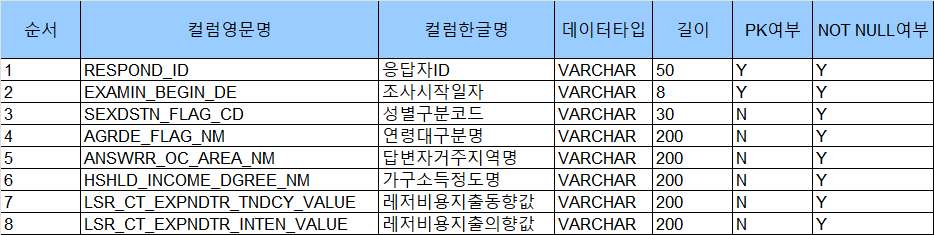

In [ ]:
files = os.path.join("/content/gdrive/MyDrive/Colab Notebooks/ITB_subject/leisure_raw", "*.csv")
files = glob.glob(files)
# joining files with concat and read_csv
df_leisure = pd.concat(map(pd.read_csv, files), ignore_index=True)
print(df_leisure)

       RESPOND_ID  EXAMIN_BEGIN_DE SEXDSTN_FLAG_CD AGRDE_FLAG_NM  \
0        53322236         20220907               F           40대   
1        53322261         20220907               M           60대   
2        53322315         20220907               F           20대   
3        53322372         20220907               M           30대   
4        53322387         20220907               F           50대   
...           ...              ...             ...           ...   
31407    53376635         20220314               F           60대   
31408    53376793         20220314               F           60대   
31409    53376867         20220314               F           50대   
31410    53376992         20220314               F           40대   
31411    53377235         20220314               M           20대   

      ANSWRR_OC_AREA_NM HSHLD_INCOME_DGREE_NM LSR_CT_EXPNDTR_TNDCY_VALUE  \
0                 서울특별시              700만원 이상                    감소한 편이다   
1                 서울특별시        

In [ ]:
df_leisure_new = df_leisure.copy() # 변수명 간단하게 변경
df_leisure_new = df_leisure_new.rename (columns = {'EXAMIN_BEGIN_DE': 'DATE'}) # 응답 날짜
df_leisure_new = df_leisure_new.rename (columns = {'SEXDSTN_FLAG_CD': 'SEX'})  # 성별
df_leisure_new = df_leisure_new.rename (columns = {'AGRDE_FLAG_NM': 'AGE'}) # 나이
df_leisure_new = df_leisure_new.rename (columns = {'HSHLD_INCOME_DGREE_NM': 'MONEY'}) #소득
df_leisure_new = df_leisure_new.rename (columns = {'ANSWRR_OC_AREA_NM': 'DO'}) # 주소지 (도)
df_leisure_new = df_leisure_new.rename (columns = {'LSR_CT_EXPNDTR_TNDCY_VALUE': 'TENDENCY'}) # 레저비용지출동향값
df_leisure_new = df_leisure_new.rename (columns = {'LSR_CT_EXPNDTR_INTEN_VALUE': 'WANT'}) # 레저비용지출의향값

In [ ]:
display(df_leisure_new)

,RESPOND_ID,DATE,SEX,AGE,DO,MONEY,TENDENCY,WANT
0,53322236,20220907,F,40대,서울특별시,700만원 이상,감소한 편이다,비슷할 것이다
1,53322261,20220907,M,60대,서울특별시,300이상500만원 미만,증가한 편이다,증가할 것이다
2,53322315,20220907,F,20대,서울특별시,700만원 이상,증가한 편이다,비슷할 것이다
3,53322372,20220907,M,30대,경기도,300이상500만원 미만,비슷하다,비슷할 것이다
4,53322387,20220907,F,50대,서울특별시,300만원 미만,비슷하다,비슷할 것이다
...,...,...,...,...,...,...,...,...
31407,53376635,20220314,F,60대,서울특별시,300만원 미만,비슷하다,비슷할 것이다
31408,53376793,20220314,F,60대,서울특별시,300이상500만원 미만,감소한 편이다,증가할 것이다
31409,53376867,20220314,F,50대,세종특별자치시,500이상700만원 미만,증가한 편이다,비슷할 것이다
31410,53376992,20220314,F,40대,경상북도,300만원 미만,증가한 편이다,증가할 것이다


In [ ]:
df_leisure_new[df_leisure_new.RESPOND_ID == 53322261]  #ID가 중복되는 경우가 있는지 확인 -> 같은 ID를 가진 사람이 다른 기간에 응답을 세 번 한 상황

,RESPOND_ID,DATE,SEX,AGE,DO,MONEY,TENDENCY,WANT
1,53322261,20220907,M,60대,서울특별시,300이상500만원 미만,증가한 편이다,증가할 것이다
21782,53322261,20220404,M,60대,서울특별시,300이상500만원 미만,비슷하다,증가할 것이다
25381,53322261,20220406,M,60대,서울특별시,300이상500만원 미만,비슷하다,증가할 것이다


### (2) 하루 평균 여가문화 시간 및 사용 비중
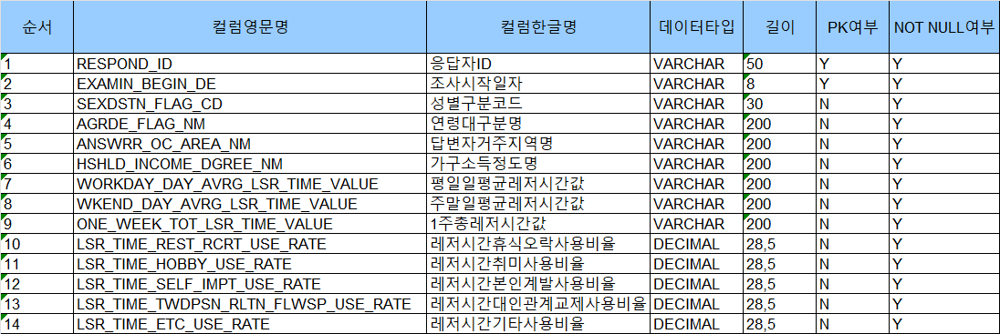

In [ ]:
files2 = os.path.join("/content/gdrive/MyDrive/Colab Notebooks/ITB_subject/use_raw", "*.csv")
files2 = glob.glob(files2)
# joining files with concat and read_csv
df_use = pd.concat(map(pd.read_csv, files2), ignore_index=True)
print(df_use)

       RESPOND_ID  EXAMIN_BEGIN_DE SEXDSTN_FLAG_CD AGRDE_FLAG_NM  \
0        53322394         20220810               F           50대   
1        53322420         20220810               F           50대   
2        53322575         20220810               F           20대   
3        53322714         20220810               M           20대   
4        53322837         20220810               M           40대   
...           ...              ...             ...           ...   
38623    53377219         20220713               F           50대   
38624    53377301         20220713               M           30대   
38625    53377343         20220713               M           30대   
38626    53377392         20220713               M           50대   
38627    53377429         20220713               M           60대   

      ANSWRR_OC_AREA_NM HSHLD_INCOME_DGREE_NM  \
0                 서울특별시              700만원 이상   
1                 서울특별시         300이상500만원 미만   
2                 서울특별시             

In [ ]:
df_use_new = df_use.copy() # 변수명 간단하게 변경
df_use_new = df_use_new.rename (columns = {'EXAMIN_BEGIN_DE': 'DATE'}) # 응답 날짜
df_use_new = df_use_new.rename (columns = {'SEXDSTN_FLAG_CD': 'SEX'}) # 성별
df_use_new = df_use_new.rename (columns = {'AGRDE_FLAG_NM': 'AGE'}) # 나이
df_use_new = df_use_new.rename (columns = {'HSHLD_INCOME_DGREE_NM': 'MONEY'}) #소득
df_use_new = df_use_new.rename (columns = {'ANSWRR_OC_AREA_NM': 'DO'}) # 주소지 (도)
df_use_new = df_use_new.rename (columns = {'LSR_CT_EXPNDTR_TNDCY_VALUE': 'TENDENCY'}) # 레저비용지출동향값
df_use_new = df_use_new.rename (columns = {'LSR_CT_EXPNDTR_INTEN_VALUE': 'WANT'}) # 레저비용지출의향값

df_use_new = df_use_new.rename (columns = {'WORKDAY_DAY_AVRG_LSR_TIME_VALUE': 'WORKDAY'}) # 평일일평균레저시간값
df_use_new = df_use_new.rename (columns = {'WKEND_DAY_AVRG_LSR_TIME_VALUE': 'WKEND'}) # 주말일평균레저시간값
df_use_new = df_use_new.rename (columns = {'ONE_WEEK_TOT_LSR_TIME_VALUE': 'ONEWEEK'}) # 1주총레저시간값
df_use_new = df_use_new.rename (columns = {'LSR_TIME_REST_RCRT_USE_RATE': 'REST'}) # 레저시간휴식오락사용비율
df_use_new = df_use_new.rename (columns = {'LSR_TIME_HOBBY_USE_RATE': 'HOBBY'}) # 레저시간취미사용비율
df_use_new = df_use_new.rename (columns = {'LSR_TIME_SELF_IMPT_USE_RATE': 'SELF'}) # 레저시간본인계발사용비율
df_use_new = df_use_new.rename (columns = {'LSR_TIME_TWDPSN_RLTN_FLWSP_USE_RATE': 'SOCIAL'}) # 레저시간대인관계교제사용비율
df_use_new = df_use_new.rename (columns = {'LSR_TIME_ETC_USE_RATE': 'ETC'}) # 레저시간기타사용비율

In [ ]:
display(df_use_new)

,RESPOND_ID,DATE,SEX,AGE,DO,MONEY,WORKDAY,WKEND,ONEWEEK,REST,HOBBY,SELF,SOCIAL,ETC
0,53322394,20220810,F,50대,서울특별시,700만원 이상,3,8,31,10,40,10,40,0
1,53322420,20220810,F,50대,서울특별시,300이상500만원 미만,4,6,32,50,5,30,15,0
2,53322575,20220810,F,20대,서울특별시,300만원 미만,5,12,49,30,10,20,40,0
3,53322714,20220810,M,20대,서울특별시,300이상500만원 미만,2,4,18,0,5,10,85,0
4,53322837,20220810,M,40대,서울특별시,300이상500만원 미만,5,5,35,70,0,0,30,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
38623,53377219,20220713,F,50대,인천광역시,700만원 이상,1,5,15,35,25,25,15,0
38624,53377301,20220713,M,30대,서울특별시,500이상700만원 미만,2,4,18,59,22,12,7,0
38625,53377343,20220713,M,30대,경상남도,300만원 미만,1,3,11,60,20,20,0,0
38626,53377392,20220713,M,50대,전라북도,500이상700만원 미만,2,4,18,30,50,10,10,0


In [ ]:
df_use_new[df_use_new.RESPOND_ID == 53322261] #ID가 중복되는 경우가 있는지 확인 -> 같은 ID를 가진 사람이 다른 기간에 응답을 세 번 한 상황

,RESPOND_ID,DATE,SEX,AGE,DO,MONEY,WORKDAY,WKEND,ONEWEEK,REST,HOBBY,SELF,SOCIAL,ETC
3692,53322261,20220907,M,60대,서울특별시,300이상500만원 미만,3,8,31,10,50,10,5,25
14634,53322261,20220404,M,60대,서울특별시,300이상500만원 미만,2,8,26,50,30,0,20,0
18687,53322261,20220406,M,60대,서울특별시,300이상500만원 미만,2,8,26,50,30,0,20,0


### (3) 여가/문화 유형별 관심도
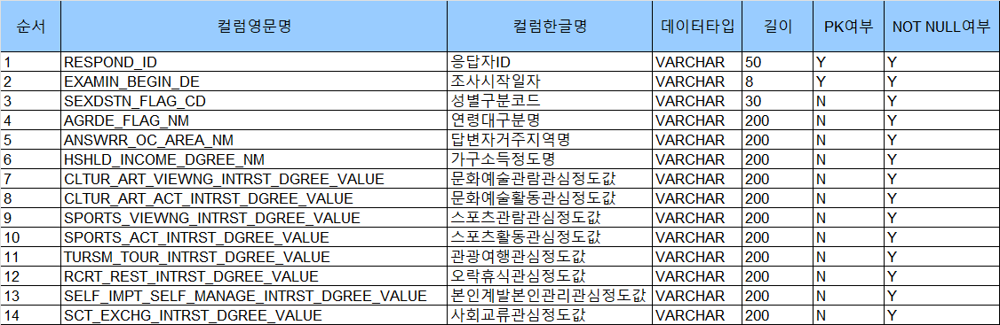

In [ ]:
files4 = os.path.join("/content/gdrive/MyDrive/Colab Notebooks/ITB_subject/interest_raw", "*.csv")
files4 = glob.glob(files4)
# joining files with concat and read_csv
df_interest = pd.concat(map(pd.read_csv, files4), ignore_index=True)
print(df_interest)

       RESPOND_ID  EXAMIN_BEGIN_DE SEXDSTN_FLAG_CD AGRDE_FLAG_NM  \
0        53322178         20220914               M           30대   
1        53322272         20220914               M           60대   
2        53322472         20220914               M           20대   
3        53322520         20220914               F           60대   
4        53322789         20220914               M           30대   
...           ...              ...             ...           ...   
31407     3217343         20220202               F           40대   
31408     3222218         20220202               M           20대   
31409     3222891         20220202               M           60대   
31410     3226201         20220202               M           20대   
31411     3241763         20220202               M           50대   

      ANSWRR_OC_AREA_NM HSHLD_INCOME_DGREE_NM  \
0                 서울특별시              700만원 이상   
1                 서울특별시         300이상500만원 미만   
2                 서울특별시         300이

In [ ]:
df_interest_new = df_interest.copy() # 변수명 간단하게 변경
df_interest_new = df_interest_new.rename (columns = {'EXAMIN_BEGIN_DE': 'DATE'}) # 응답 날짜
df_interest_new = df_interest_new.rename (columns = {'SEXDSTN_FLAG_CD': 'SEX'}) # 성별
df_interest_new = df_interest_new.rename (columns = {'AGRDE_FLAG_NM': 'AGE'}) # 나이
df_interest_new = df_interest_new.rename (columns = {'HSHLD_INCOME_DGREE_NM': 'MONEY'}) #소득
df_interest_new = df_interest_new.rename (columns = {'ANSWRR_OC_AREA_NM': 'DO'}) # 주소지 (도)

df_interest_new = df_interest_new.rename (columns = {'CLTUR_ART_VIEWNG_INTRST_DGREE_VALUE': 'INTER_CUL_VIEW'}) # 문화예술관람관심정도값
df_interest_new = df_interest_new.rename (columns = {'CLTUR_ART_ACT_INTRST_DGREE_VALUE': 'INTER_CUL_ACT'}) # 문화예술활동관심정도값
df_interest_new = df_interest_new.rename (columns = {'SPORTS_VIEWNG_INTRST_DGREE_VALUE': 'INTER_SPORT_VIEW'}) # 스포츠관람관심정도값
df_interest_new = df_interest_new.rename (columns = {'SPORTS_ACT_INTRST_DGREE_VALUE': 'INTER_SPORT_ACT'}) # 스포츠활동관심정도값
df_interest_new = df_interest_new.rename (columns = {'TURSM_TOUR_INTRST_DGREE_VALUE': 'INTER_TRAVEL'}) # 관광여행관심정도값
df_interest_new = df_interest_new.rename (columns = {'RCRT_REST_INTRST_DGREE_VALUE': 'INTER_REST'}) # 오락휴식관심정도값
df_interest_new = df_interest_new.rename (columns = {'SELF_IMPT_SELF_MANAGE_INTRST_DGREE_VALUE': 'INTER_SELF'}) # 본인계발본인관리관심정도값
df_interest_new = df_interest_new.rename (columns = {'SCT_EXCHG_INTRST_DGREE_VALUE': 'INTER_SOCIAL'}) # 사회교류관심정도값

In [ ]:
display(df_interest_new)

,RESPOND_ID,DATE,SEX,AGE,DO,MONEY,INTER_CUL_VIEW,INTER_CUL_ACT,INTER_SPORT_VIEW,INTER_SPORT_ACT,INTER_TRAVEL,INTER_REST,INTER_SELF,INTER_SOCIAL
0,53322178,20220914,M,30대,서울특별시,700만원 이상,조금 커졌다,비슷하다,조금 커졌다,비슷하다,조금 커졌다,조금 커졌다,조금 작아졌다,비슷하다
1,53322272,20220914,M,60대,서울특별시,300이상500만원 미만,조금 작아졌다,비슷하다,조금 커졌다,조금 커졌다,조금 작아졌다,조금 커졌다,조금 작아졌다,비슷하다
2,53322472,20220914,M,20대,서울특별시,300이상500만원 미만,비슷하다,비슷하다,매우 커졌다,비슷하다,조금 커졌다,조금 커졌다,조금 커졌다,조금 작아졌다
3,53322520,20220914,F,60대,서울특별시,300만원 미만,조금 작아졌다,비슷하다,조금 작아졌다,조금 커졌다,조금 작아졌다,비슷하다,조금 커졌다,비슷하다
4,53322789,20220914,M,30대,서울특별시,500이상700만원 미만,비슷하다,비슷하다,조금 커졌다,조금 커졌다,조금 커졌다,조금 커졌다,조금 커졌다,비슷하다
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
31407,3217343,20220202,F,40대,서울특별시,300만원 미만,조금 커졌다,매우 커졌다,조금 커졌다,비슷하다,조금 커졌다,비슷하다,비슷하다,조금 작아졌다
31408,3222218,20220202,M,20대,서울특별시,300이상500만원 미만,조금 커졌다,조금 커졌다,조금 커졌다,조금 커졌다,조금 커졌다,조금 커졌다,조금 커졌다,조금 커졌다
31409,3222891,20220202,M,60대,부산광역시,500이상700만원 미만,조금 커졌다,비슷하다,조금 커졌다,조금 커졌다,조금 작아졌다,조금 커졌다,조금 작아졌다,조금 작아졌다
31410,3226201,20220202,M,20대,경기도,300만원 미만,조금 작아졌다,매우 작아졌다,매우 작아졌다,비슷하다,매우 작아졌다,조금 커졌다,매우 작아졌다,매우 작아졌다


In [ ]:
df_interest_new[df_interest_new.RESPOND_ID == 53322261] #ID가 중복되는 경우가 있는지 확인 -> 같은 ID를 가진 사람이 다른 기간에 응답을 세 번 한 상황

,RESPOND_ID,DATE,SEX,AGE,DO,MONEY,INTER_CUL_VIEW,INTER_CUL_ACT,INTER_SPORT_VIEW,INTER_SPORT_ACT,INTER_TRAVEL,INTER_REST,INTER_SELF,INTER_SOCIAL
530,53322261,20220907,M,60대,서울특별시,300이상500만원 미만,비슷하다,비슷하다,비슷하다,조금 커졌다,비슷하다,비슷하다,비슷하다,조금 작아졌다
17687,53322261,20220404,M,60대,서울특별시,300이상500만원 미만,조금 작아졌다,조금 작아졌다,비슷하다,비슷하다,매우 작아졌다,비슷하다,조금 작아졌다,비슷하다
18188,53322261,20220406,M,60대,서울특별시,300이상500만원 미만,조금 작아졌다,조금 작아졌다,비슷하다,비슷하다,매우 작아졌다,비슷하다,조금 작아졌다,비슷하다


### (4) 데이터 병합

위의 데이터들은 전부 "한 조사 기관"에서 나온 설문조사 결과이고 이 모든 설문조사에 응답한 객체가 존재하므로 이 프레임을 합칠 수 있다. pandas의 merge on(조건) how = 조인 방법 이용해서 데이터 프레임 합치고자 한다.

In [ ]:
import pandas as pd #outer join을 이용해 모든 데이터가 입력 (입력 값 없는 경우 NAN 지동 지정)
df1 = pd.merge(df_leisure_new, df_use_new, on = ['DATE', 'RESPOND_ID', 'SEX', 'AGE', 'DO', 'MONEY'], how = 'outer')
df1 = pd.merge(df1, df_interest_new, on = ['DATE', 'RESPOND_ID', 'SEX', 'AGE', 'DO', 'MONEY'], how = 'outer')
display(df1)

,RESPOND_ID,DATE,SEX,AGE,DO,MONEY,TENDENCY,WANT,WORKDAY,WKEND,...,SOCIAL,ETC,INTER_CUL_VIEW,INTER_CUL_ACT,INTER_SPORT_VIEW,INTER_SPORT_ACT,INTER_TRAVEL,INTER_REST,INTER_SELF,INTER_SOCIAL
0,53322236,20220907,F,40대,서울특별시,700만원 이상,감소한 편이다,비슷할 것이다,3,2,...,20,0,비슷하다,조금 작아졌다,비슷하다,조금 작아졌다,조금 작아졌다,조금 커졌다,조금 커졌다,조금 작아졌다
1,53322261,20220907,M,60대,서울특별시,300이상500만원 미만,증가한 편이다,증가할 것이다,3,8,...,5,25,비슷하다,비슷하다,비슷하다,조금 커졌다,비슷하다,비슷하다,비슷하다,조금 작아졌다
2,53322315,20220907,F,20대,서울특별시,700만원 이상,증가한 편이다,비슷할 것이다,3,6,...,30,0,조금 작아졌다,비슷하다,매우 작아졌다,비슷하다,조금 커졌다,매우 커졌다,조금 작아졌다,매우 작아졌다
3,53322372,20220907,M,30대,경기도,300이상500만원 미만,비슷하다,비슷할 것이다,1,3,...,0,0,비슷하다,비슷하다,비슷하다,비슷하다,비슷하다,비슷하다,비슷하다,비슷하다
4,53322387,20220907,F,50대,서울특별시,300만원 미만,비슷하다,비슷할 것이다,2,3,...,30,0,조금 커졌다,조금 커졌다,조금 커졌다,조금 커졌다,조금 커졌다,조금 커졌다,조금 커졌다,조금 커졌다
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
38623,3242397,20211124,M,20대,경기도,300이상500만원 미만,NaN,NaN,2,6,...,50,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
38624,3243457,20211124,F,30대,강원도,300이상500만원 미만,NaN,NaN,1,2,...,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
38625,3243663,20211124,F,30대,경기도,300이상500만원 미만,NaN,NaN,4,18,...,10,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
38626,3244279,20211124,M,40대,전라북도,700만원 이상,NaN,NaN,3,8,...,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
df1[df1.RESPOND_ID == 53322261] # 앞서서 확인했던 모두 응답한 ID의 설문조사 내용이 전부 JOIN 된 것을 확인

,RESPOND_ID,DATE,SEX,AGE,DO,MONEY,TENDENCY,WANT,WORKDAY,WKEND,...,SOCIAL,ETC,INTER_CUL_VIEW,INTER_CUL_ACT,INTER_SPORT_VIEW,INTER_SPORT_ACT,INTER_TRAVEL,INTER_REST,INTER_SELF,INTER_SOCIAL
1,53322261,20220907,M,60대,서울특별시,300이상500만원 미만,증가한 편이다,증가할 것이다,3,8,...,5,25,비슷하다,비슷하다,비슷하다,조금 커졌다,비슷하다,비슷하다,비슷하다,조금 작아졌다
21782,53322261,20220404,M,60대,서울특별시,300이상500만원 미만,비슷하다,증가할 것이다,2,8,...,20,0,조금 작아졌다,조금 작아졌다,비슷하다,비슷하다,매우 작아졌다,비슷하다,조금 작아졌다,비슷하다
25381,53322261,20220406,M,60대,서울특별시,300이상500만원 미만,비슷하다,증가할 것이다,2,8,...,20,0,조금 작아졌다,조금 작아졌다,비슷하다,비슷하다,매우 작아졌다,비슷하다,조금 작아졌다,비슷하다


### (5) 데이터 척도값 변경
효율적으로 처리하기 위해 한글로 쓰여진 척도값을 숫자로 변경

이 때 원본은 변경되지 않도록 df2를 새로 만들어 저장

In [ ]:
df2 = df1.copy()
df2 = df2.replace({'매우 작아졌다':1, '조금 작아졌다':2, '비슷하다':3, '조금 커졌다':4, '매우 커졌다':5})
df2 = df2.replace({'크게 감소했다':1, '감소한 편이다':2, '비슷하다':3, '증가한 편이다':4, '크게 증가했다':5})
df2 = df2.replace({'크게 감소할 것이다':1, '감소할 것이다':2, '비슷할 것이다':3, '증가할 것이다':4, '크게 증가할 것이다':5})
df2 = df2.replace({'300만원 미만':1, '300이상500만원 미만':2, '500이상700만원 미만':3, '700만원 이상':4})
# df2 = df2.replace({'M':0, 'F':1})  # 지금 당장은 변경할 필요 없음
# df2 = df2.replace({'20대':2, '30대':3, '40대':4, '50대':5,'60대':6}) # 지금 당장은 변경할 필요 없음

In [ ]:
display(df2)

,RESPOND_ID,DATE,SEX,AGE,DO,MONEY,TENDENCY,WANT,WORKDAY,WKEND,...,SOCIAL,ETC,INTER_CUL_VIEW,INTER_CUL_ACT,INTER_SPORT_VIEW,INTER_SPORT_ACT,INTER_TRAVEL,INTER_REST,INTER_SELF,INTER_SOCIAL
0,53322236,20220907,F,40대,서울특별시,4,2.0,3.0,3,2,...,20,0,3.0,2.0,3.0,2.0,2.0,4.0,4.0,2.0
1,53322261,20220907,M,60대,서울특별시,2,4.0,4.0,3,8,...,5,25,3.0,3.0,3.0,4.0,3.0,3.0,3.0,2.0
2,53322315,20220907,F,20대,서울특별시,4,4.0,3.0,3,6,...,30,0,2.0,3.0,1.0,3.0,4.0,5.0,2.0,1.0
3,53322372,20220907,M,30대,경기도,2,3.0,3.0,1,3,...,0,0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0
4,53322387,20220907,F,50대,서울특별시,1,3.0,3.0,2,3,...,30,0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
38623,3242397,20211124,M,20대,경기도,2,NaN,NaN,2,6,...,50,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
38624,3243457,20211124,F,30대,강원도,2,NaN,NaN,1,2,...,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
38625,3243663,20211124,F,30대,경기도,2,NaN,NaN,4,18,...,10,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
38626,3244279,20211124,M,40대,전라북도,4,NaN,NaN,3,8,...,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


### (6)  데이터 확인

In [ ]:
df2.info() # 전체 데이터 38628개

<class 'pandas.core.frame.DataFrame'>
Int64Index: 38628 entries, 0 to 38627
Data columns (total 24 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   RESPOND_ID        38628 non-null  int64  
 1   DATE              38628 non-null  int64  
 2   SEX               38628 non-null  object 
 3   AGE               38628 non-null  object 
 4   DO                38628 non-null  object 
 5   MONEY             38628 non-null  object 
 6   TENDENCY          31412 non-null  float64
 7   WANT              31412 non-null  float64
 8   WORKDAY           38628 non-null  int64  
 9   WKEND             38628 non-null  int64  
 10  ONEWEEK           38628 non-null  int64  
 11  REST              38628 non-null  int64  
 12  HOBBY             38628 non-null  int64  
 13  SELF              38628 non-null  int64  
 14  SOCIAL            38628 non-null  int64  
 15  ETC               38628 non-null  int64  
 16  INTER_CUL_VIEW    31412 non-null  float6

In [ ]:
df2['RESPOND_ID'] = df2['RESPOND_ID'].astype(str) # RESPOND_ID 는 숫자로 계산할 필요가 없는 KEY이므로 문자로 변환

In [ ]:
display(df2.isna().sum()) # 결측치 수 : 일부에서 7216개 (3개의 설문조사를 합치는 과정에서 모든 설문에 응답하지 않은 객체의 NA값 발생)
 # 변수 "TENDENCY", "WANT", "INTER"와 관련된 데이터 중 7216개가 NA값임.

RESPOND_ID             0
DATE                   0
SEX                    0
AGE                    0
DO                     0
MONEY                  0
TENDENCY            7216
WANT                7216
WORKDAY                0
WKEND                  0
ONEWEEK                0
REST                   0
HOBBY                  0
SELF                   0
SOCIAL                 0
ETC                    0
INTER_CUL_VIEW      7216
INTER_CUL_ACT       7216
INTER_SPORT_VIEW    7216
INTER_SPORT_ACT     7216
INTER_TRAVEL        7216
INTER_REST          7216
INTER_SELF          7216
INTER_SOCIAL        7216
dtype: int64

In [ ]:
df2.describe()

,DATE,TENDENCY,WANT,WORKDAY,WKEND,ONEWEEK,REST,HOBBY,SELF,SOCIAL,ETC,INTER_CUL_VIEW,INTER_CUL_ACT,INTER_SPORT_VIEW,INTER_SPORT_ACT,INTER_TRAVEL,INTER_REST,INTER_SELF,INTER_SOCIAL
count,3.862800e+04,31412.000000,31412.000000,38628.000000,38628.000000,38628.000000,38628.000000,38628.000000,38628.000000,38628.000000,38628.000000,31412.000000,31412.000000,31412.000000,31412.000000,31412.000000,31412.000000,31412.000000,31412.000000
mean,2.021925e+07,3.238444,3.383611,3.060474,5.865253,27.032878,41.945946,19.366884,13.278606,22.133841,3.274723,3.021934,2.890074,2.936298,3.210206,3.345664,3.406310,3.257768,2.959792
std,3.187322e+03,0.820258,0.735876,2.222386,3.481849,15.549568,25.728483,19.361442,15.426196,18.889275,11.992920,0.997081,0.975805,0.968603,0.971318,1.148029,0.864867,0.913534,0.977415
min,2.021110e+07,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
25%,2.022021e+07,3.000000,3.000000,2.000000,3.000000,16.000000,20.000000,0.000000,0.000000,10.000000,0.000000,2.000000,2.000000,2.000000,3.000000,3.000000,3.000000,3.000000,2.000000
50%,2.022042e+07,3.000000,3.000000,3.000000,5.000000,25.000000,40.000000,15.000000,10.000000,20.000000,0.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000
75%,2.022063e+07,4.000000,4.000000,4.000000,8.000000,35.000000,60.000000,30.000000,20.000000,30.000000,0.000000,4.000000,3.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000
max,2.022093e+07,5.000000,5.000000,18.000000,18.000000,126.000000,100.000000,100.000000,100.000000,100.000000,100.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000


## [3] 데이터 시각화

분석에 앞서서, 해당 원데이터에서 운동과 직접적으로 관련된 컬럼은 없다. 따라서 "여가시간에 운동을 유도하는데 가장 중요한 변수"를 임의로 설정하고자 한다. 
- 먼저 여가 사용 비중 변수들은(REST(휴식 및 오락), HOBBY(취미), TRAVEL(여행), SOCIAL(소셜 활동), ETC(기타)) 응답자가 운동을 어떻게 생각하느냐에 따라 운동을 REST(오락 활동으로 볼링을 치러간다.)나 HOBBY(수영을 취미로 배운다.) 또는 SOCIAL(친구들과 같이 골프를 치면서 관계를 쌓는다.) 등으로 선택할 수 있어 적절하지 않다.
- WORKDAY, WKEND, ONEWEEK 등 응답자가 얼마나 여가시간을 보내느냐는 단순 수치만 있다. 물론 절대적인 시간이 많아지면, 운동에 관한 여가 활동도 늘어날 수 밖에 없지만 해당 조사는 "휴식" 또한 여가활동으로 포함하고 있는데다가 그 "휴식"이 포함된 "REST"변수가 전체의 41%로 큰 비중을 차지하고 있어 적절하지 않다.
- 여가와 관련된 지출 변수 중  "TENDENCY(현재 여가에 얼마나 지출을 하고 있는지)", "WANT(미래에 여가와 관련해 지출을 어떻게 변경할 것인지)" 의 변수는 역시 여행과 문화 생활에 영향을 받아 완벽하지 않다. 그러나 해당 조사결과가 코로나 활동으로 인해 해외여행 및 문화 생활이 쉽지 않았던 2021년 11월 이후 부터의 데이터라는 점, 그리고 한국의 경우 상대적으로 운동을 하기 위해 헬스장에서 PT를 받거나 해당 운동에 필요한 물품을 사는데 돈을 기꺼이 지불하는 경우가 많다는 점, 마지막으로 코로나 기간에 골프나 테니스 등 소위 고급 스포츠들의 인기가 급상승했다는 점을 근거로 해당 변수를 집중적으로 분석하고자 한다.

In [ ]:
'''
%matplotlib inline
import matplotlib as mpl               # 기본 설정
import matplotlib.pyplot as plt        # 그래프 관련
import matplotlib.font_manager as fm   # 폰트 관련

mpl.rcParams['axes.unicode_minus'] = False  ## 마이너스 부호가 깨지는 것 방지 

!apt-get update -qq
!apt-get install fonts-nanum* -qq              # 나눔 폰트 설치

sys_font=fm.findSystemFonts()
print(f"sys_font number: {len(sys_font)}")
print(sys_font)                                # 전체 폰트 개수

nanum_font = [f for f in sys_font if 'Nanum' in f]
print(f"nanum_font number: {len(nanum_font)}") # 나눔 폰트 개수 (설치된 것을 확인)
#nanum_font

# 설치된 나눔글꼴중 원하는 폰트의 전체 경로 가져오기 
path = '/usr/share/fonts/truetype/nanum/NanumGothicEco.ttf'  
font_name = fm.FontProperties(fname=path, size=10).get_name()
print(font_name)

plt.rc('font', family=font_name)
fm._rebuild()  # 폰트 적용
'''

'\n%matplotlib inline\nimport matplotlib as mpl               # 기본 설정\nimport matplotlib.pyplot as plt        # 그래프 관련\nimport matplotlib.font_manager as fm   # 폰트 관련\n\nmpl.rcParams[\'axes.unicode_minus\'] = False  ## 마이너스 부호가 깨지는 것 방지 \n\n!apt-get update -qq\n!apt-get install fonts-nanum* -qq              # 나눔 폰트 설치\n\nsys_font=fm.findSystemFonts()\nprint(f"sys_font number: {len(sys_font)}")\nprint(sys_font)                                # 전체 폰트 개수\n\nnanum_font = [f for f in sys_font if \'Nanum\' in f]\nprint(f"nanum_font number: {len(nanum_font)}") # 나눔 폰트 개수 (설치된 것을 확인)\n#nanum_font\n\n# 설치된 나눔글꼴중 원하는 폰트의 전체 경로 가져오기 \npath = \'/usr/share/fonts/truetype/nanum/NanumGothicEco.ttf\'  \nfont_name = fm.FontProperties(fname=path, size=10).get_name()\nprint(font_name)\n\nplt.rc(\'font\', family=font_name)\nfm._rebuild()  # 폰트 적용\n'

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
import numpy as np

### (1) 응답자 분포 정도
분석에 앞서, 해당 변수별로 응답자가 어떻게 분포해있는지 시각화를 통해 확인하고자 한다.

In [ ]:
print(len(df2.loc[df2['AGE'] == '20대']),
len(df2.loc[df2['AGE'] == '30대']),
len(df2.loc[df2['AGE'] == '40대']),
len(df2.loc[df2['AGE'] == '50대']),
len(df2.loc[df2['AGE'] == '60대']))

6944 7180 8589 8847 7068


<function matplotlib.pyplot.show(*args, **kw)>

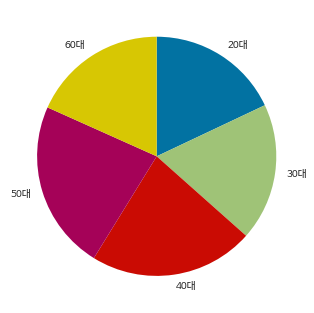

In [ ]:
values1 = [6944, 7180, 8589, 8847, 7068]
labels = ['20대', '30대', '40대', '50대', '60대']
plt.pie(values1,labels = labels, startangle = 90, counterclock=False, textprops={'size':10})

plt.show # 응답 연령대는 비교적 고르게 분포해 있다.

In [ ]:
print(len(df2.loc[df2['SEX'] == 'F']),
len(df2.loc[df2['SEX'] == 'M']))

19067 19561


<function matplotlib.pyplot.show(*args, **kw)>

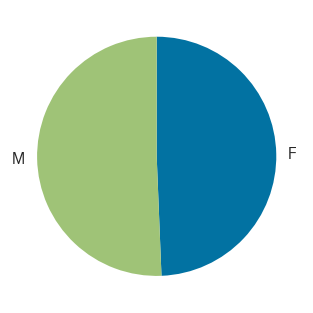

In [ ]:
values2 = [19067, 19561]
labels = ['F', 'M']
plt.pie(values2,labels = labels, startangle = 90, counterclock=False, textprops={'size':15})

plt.show # 응답 성별은 남성(51%), 여성(약 49%)으로 고르게 분포해 있다.

In [ ]:
print(len(df2.loc[df2['DO'] == '서울특별시']),
len(df2.loc[df2['DO'] == '경기도']),
len(df2.loc[df2['DO'] == '강원도']),
len(df2.loc[df2['DO'] == '충청남도']),
len(df2.loc[df2['DO'] == '부산광역시']),
len(df2.loc[df2['DO'] == '제주특별자치도']),
len(df2.loc[df2['DO'] == '대전광역시']),
len(df2.loc[df2['DO'] == '전라북도']),
len(df2.loc[df2['DO'] == '경상북도']),
len(df2.loc[df2['DO'] == '전라남도']),
len(df2.loc[df2['DO'] == '경상남도']),
len(df2.loc[df2['DO'] == '세종특별자치시']),
len(df2.loc[df2['DO'] == '인천광역시']),
len(df2.loc[df2['DO'] == '대구광역시']),
len(df2.loc[df2['DO'] == '광주광역시']),
len(df2.loc[df2['DO'] == '울산광역시']),
len(df2.loc[df2['DO'] == '충청북도']))

6928 9092 1206 1524 2773 539 1265 1290 2037 1264 2608 357 2399 1921 1202 947 1276


<function matplotlib.pyplot.show(*args, **kw)>

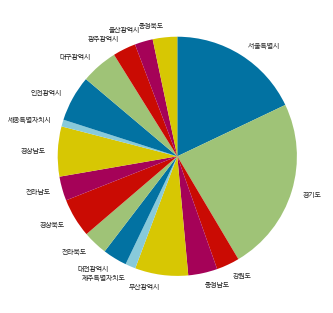

In [ ]:
values3 = [6928, 9092, 1206, 1524, 2773, 539, 1265, 1290, 2037, 1264, 2608, 357, 2399, 1921, 1202, 947, 1276]
labels = ['서울특별시', '경기도', '강원도', '충청남도', '부산광역시', '제주특별자치도', '대전광역시', '전라북도', '경상북도', '전라남도', '경상남도', '세종특별자치시', '인천광역시', '대구광역시', '광주광역시', '울산광역시', '충청북도']
plt.pie(values3,labels = labels, startangle = 90, counterclock=False, textprops={'size':7})

plt.show # 응답 지역은 서울특별시(약 18%), 경기도(약 24%)에 몰려 있고 이 외에는 대체로 3~5%대의 비율을 차지하고 있다.

In [ ]:
print(len(df2.loc[df2['MONEY'] == 1]),
len(df2.loc[df2['MONEY'] == 2]),
len(df2.loc[df2['MONEY'] == 3]),
len(df2.loc[df2['MONEY'] == 4]),
len(df2.loc[df2['MONEY'] == '무응답']))

9737 11798 7388 7734 1971


<function matplotlib.pyplot.show(*args, **kw)>

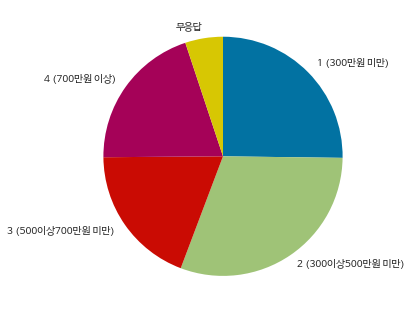

In [ ]:
values4 = [9737, 11798, 7388, 7734, 1971]
labels = ['1 (300만원 미만)', '2 (300이상500만원 미만)', '3 (500이상700만원 미만)', '4 (700만원 이상)', '무응답']
plt.pie(values4,labels = labels, startangle = 90, counterclock=False, textprops={'size':10})

plt.show # 소득 수준 또한 2(300이상 500만원 미만) 항목이 약 30%를 차지하는 등 비교적 고르게 분포해 있다.

따라서 응답자들의 분포는 연령대, 성별, 소득 수준에서 비교적 모든 항목에 고르게 분포해 있고, 지역 변수 중 "서울특별시"와 "경기도"에 많은 응답자들이 상대적으로 몰려 있는 것을 확인했으나, 두 지역이 대한민국에서 가장 인구밀집도가 높은 지역이라는 것을 고려해 크게 상관하지 않는다.

이후 다른 변수들도 확인하고자 했다.

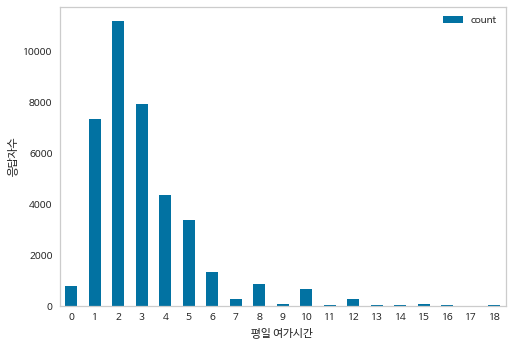

In [ ]:
answer1 = df2.groupby('WORKDAY', as_index = False).agg(count = ('WORKDAY', 'count'))
answer1.plot.bar(x="WORKDAY", y="count", rot = 0, xlabel = '평일 여가시간 ', ylabel = '응답자수')
plt.grid(False)
# 주로 1~3시간 정도의 여유시간을 갖는다는 응답에 응답자들이 많이 몰려 있다.

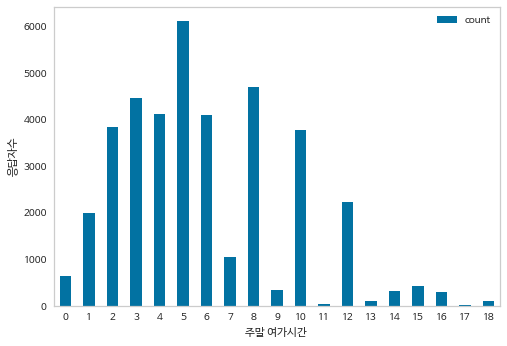

In [ ]:
answer2 = df2.groupby('WKEND', as_index = False).agg(count = ('WKEND', 'count'))
answer2.plot.bar(x="WKEND", y="count", rot = 0, xlabel = '주말 여가시간 ', ylabel = '응답자수')
plt.grid(False)
# 주로 5시간 정도의 여유시간을 갖는다는 응답에 응답자들이 많이 몰려 있다.

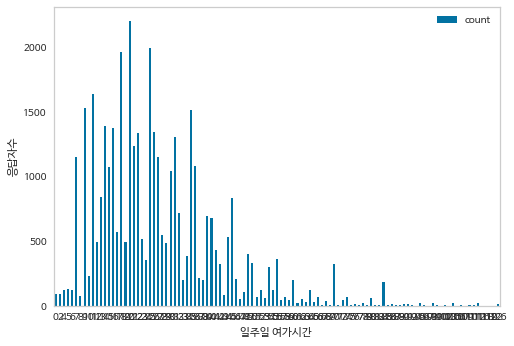

In [ ]:
answer3 = df2.groupby('ONEWEEK', as_index = False).agg(count = ('ONEWEEK', 'count'))
answer3.plot.bar(x="ONEWEEK", y="count", rot = 0, xlabel = '일주일 여가시간 ', ylabel = '응답자수')
plt.grid(False)
# 그래프가 너무 촘촘해 알아볼 수가 없다. 따라서 수치를 통해 확인한다.

In [ ]:
count1 = df2['ONEWEEK'].value_counts()
print(count1[:10]) # 9~35시간대 에 많은 응답이 있었음을 알 수 있다.

20    2203
25    1995
18    1962
11    1639
9     1527
35    1511
14    1389
16    1379
26    1345
22    1334
Name: ONEWEEK, dtype: int64


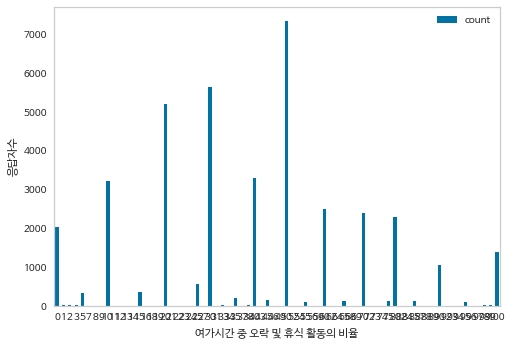

In [ ]:
answer4 = df2.groupby('REST', as_index = False).agg(count = ('REST', 'count'))
answer4.plot.bar(x="REST", y="count", rot = 0, xlabel = '여가시간 중 오락 및 휴식 활동의 비율', ylabel = '응답자수')
plt.grid(False)
# 그래프가 너무 촘촘해 알아볼 수가 없다. 따라서 수치를 통해 확인한다.

In [ ]:
answer5 = np.mean(df2['REST'])
answer6 = np.mean(df2['HOBBY'])
answer7 = np.mean(df2['SELF'])
answer8 = np.mean(df2['SOCIAL'])
answer9 = np.mean(df2['ETC'])
print(f"여가시간 중 오락 및 휴식 활동의 비율 : {answer5} \n여가시간 중 취미 활동의 비율 : {answer6} \n여가시간 중 자기계발 활동의 비율 : {answer7}")
print(f"여가시간 중 소셜 활동의 비율 : {answer8} \n여가시간 중 기타 활동의 비율 : {answer9}")
# 평균적으로 여가시간 활동의 비율은 평균적으로 오락 및 휴식(41%),  소셜활동 (22%), 취미(19%), 자기계발(13%), 기타(3.24)와 같다.

여가시간 중 오락 및 휴식 활동의 비율 : 41.945945945945944 
여가시간 중 취미 활동의 비율 : 19.366884125504814 
여가시간 중 자기계발 활동의 비율 : 13.278606192399296
여가시간 중 소셜 활동의 비율 : 22.133840737289013 
여가시간 중 기타 활동의 비율 : 3.27472299886093


<function matplotlib.pyplot.show(*args, **kw)>

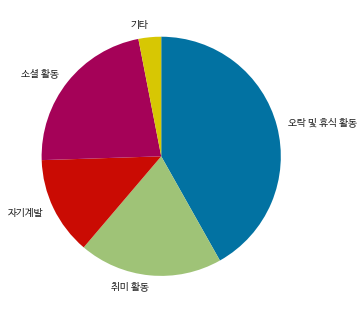

In [ ]:
values5 = [41, 19, 13, 22, 3]
labels = ['오락 및 휴식 활동', '취미 활동', '자기계발', '소셜 활동', '기타']
plt.pie(values5,labels = labels, startangle = 90, counterclock=False, textprops={'size':10})

plt.show # 응답자들은 평균적으로 여가시간의 41%를 오락 및 휴식활동에 투자한다.

### (2) 연령대별 분석
연령대별로 여가에 지출하는 정도와 미래 지출 정도가 차이가 있을까에 대해 확인한다.
- 현재 여가 비용 지출 정도에서는 20대가 가장 많고, 그 뒤로 점차 낮아진다.
- 미래 여가 비용 지출 의향 정도에서는 30대가 가장 많고 그 뒤로 점차 낮아진다. 그러나 그 정도가 크게 차이나지는 않는다.
- 이를 통해 20대는 비교적 여가를 중요시하고 이에 대한 지출을 아끼지 않는 편임을 알 수 있다.

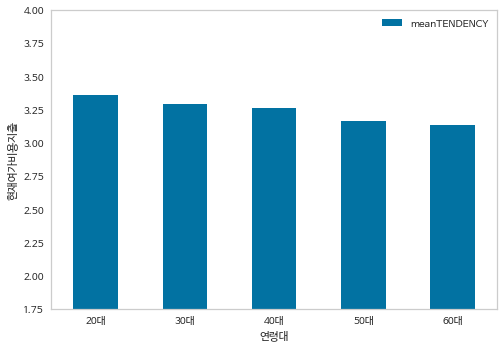

In [ ]:
age_TENDENCY = df2.groupby('AGE', as_index = False).agg(meanTENDENCY = ('TENDENCY', 'mean'))
age_TENDENCY
age_TENDENCY.plot.bar(x='AGE', y = 'meanTENDENCY', rot = 0, ylim = [1.75, 4], xlabel = '연령대', ylabel = '현재여가비용지출')
plt.grid(False)

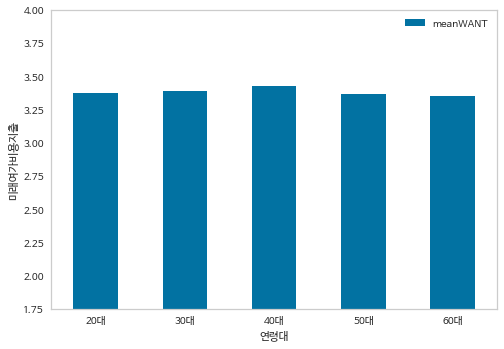

In [ ]:
age_WANT = df2.groupby('AGE', as_index = False).agg(meanWANT = ('WANT', 'mean'))
age_WANT.plot.bar(x = 'AGE', y = 'meanWANT', rot = 0, ylim = [1.75, 4], xlabel = '연령대', ylabel = '미래여가비용지출')
plt.grid(False)

연령대별로 여가를 보내는 시간이 다른지 확인한다.
- 주로 직업을 가지고 일을 하는 연령대인 30~50대는 주중에는 상대적으로 여가를 많이 즐기지 못하고 있다.
- 반면 아직 취직을 하지 않은 20대나 은퇴를 한 60대는 주중에 비교적 여가를 많이 즐기고 있다.

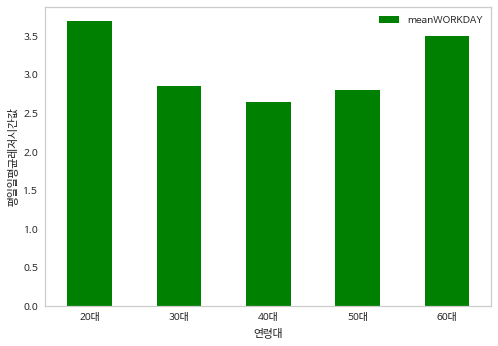

In [ ]:
age_WORKDAY = df2.groupby('AGE', as_index = False).agg(meanWORKDAY = ('WORKDAY', 'mean'))
age_WORKDAY.plot.bar(x = 'AGE', y = 'meanWORKDAY', rot = 0, xlabel = '연령대', ylabel = '평일일평균레저시간값', color = 'green')
plt.grid(False)

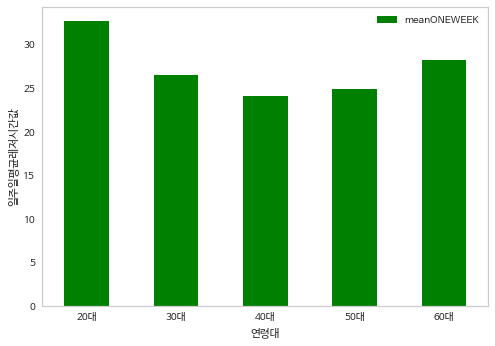

In [ ]:
age_ONEWEEK = df2.groupby('AGE', as_index = False).agg(meanONEWEEK = ('ONEWEEK', 'mean'))
age_ONEWEEK.plot.bar(x = 'AGE', y = 'meanONEWEEK', rot = 0, xlabel = '연령대', ylabel = '일주일평균레저시간값', color = 'green')
plt.savefig('./age_ONEWEEK.png')
plt.grid(False)

### (3) 성별 분석

In [ ]:
'''
!pip install mglearn 
!pip install --upgrade joblib==1.1.0
'''

'\n!pip install mglearn \n!pip install --upgrade joblib==1.1.0\n'

In [ ]:
#import mglearn
plt.rcParams["font.size"] = 12 #폰트 사이즈 전역 설정

성별과 연령대를 동시에 이용해 해당 집단 간에 차이가 있는지 확인한다.
- 여가 관련 투자 정도에는 연령대별로 남성이 여성에 비해 현재 여가 관련 비용 지출이 많다고 응답했지만, 수치가 작아 확신할 수 없다.
- 남성과 여성 모두 점차 연령대가 높아질 수록 여가에 관한 비용 지출이 줄고 있다.
-남성과 여성 모두 미래 여가 관련 비용 지출 의향은 30대에서 높아지는 모습을 보여주고 있다.

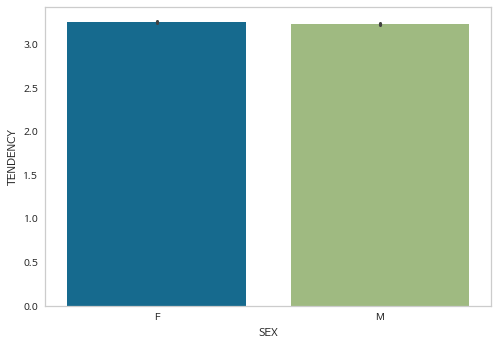

In [ ]:
sns.barplot(x="SEX", y="TENDENCY",data=df2)
plt.grid(False)
# 성별 간 여가 활동 현재 지출 의향

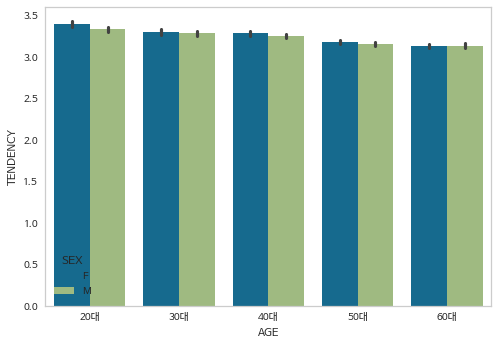

In [ ]:
sns.barplot(x="AGE", y="TENDENCY",hue='SEX', data=df2, order = ['20대', '30대', '40대', '50대', '60대'])
plt.grid(False)
# 연령대별 - 성별로 여가 활동 현재 지출 의향

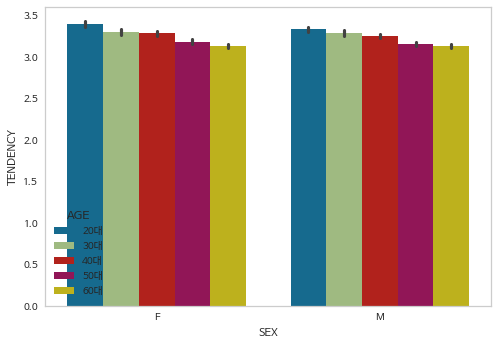

In [ ]:
sns.barplot(x="SEX", y="TENDENCY", hue='AGE', data=df2, hue_order = ['20대', '30대', '40대', '50대', '60대'])
plt.grid(False)
# 성별 - 연령대별로 여가활동 현재 지출 의향

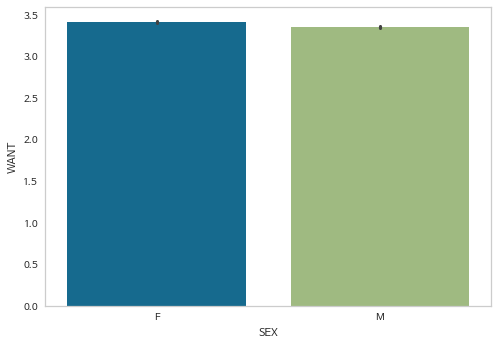

In [ ]:
sns.barplot(x="SEX", y="WANT",data=df2)
plt.grid(False)
# 성별 간 여가 활동 미래 지출 의향

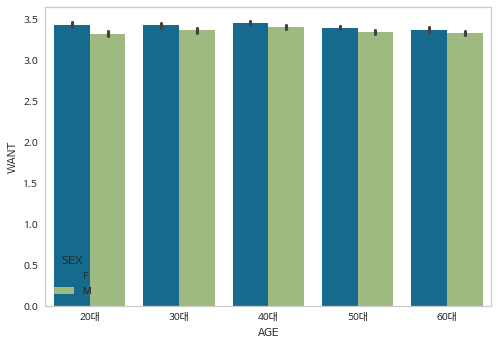

In [ ]:
sns.barplot(x="AGE", y="WANT",hue='SEX', data=df2, order = ['20대', '30대', '40대', '50대', '60대'])
plt.grid(False)
# 연령대별 - 성별로 여가활동 미래 지출 의향

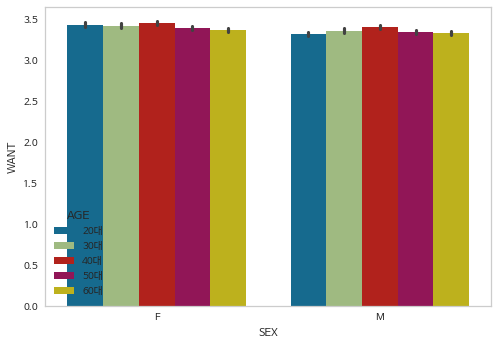

In [ ]:
sns.barplot(x="SEX", y="WANT", hue='AGE', data=df2, hue_order = ['20대', '30대', '40대', '50대', '60대'])
plt.grid(False)
# 성별 - 연령대별로 여가활동 미래 지출 의향

### (4) 주소지별 분석
- 세종특별자치시의 여가활동에 대한 현재, 미래 지출 의향이 타 주소지에 비해 크지만 이 수치가 매우 작아 의미 있는 결과로 보기는 힘들다.
- 따라서 지역간에는 여가 활동 지출 의향 간에 차이가 있다고 보기는 어렵다.

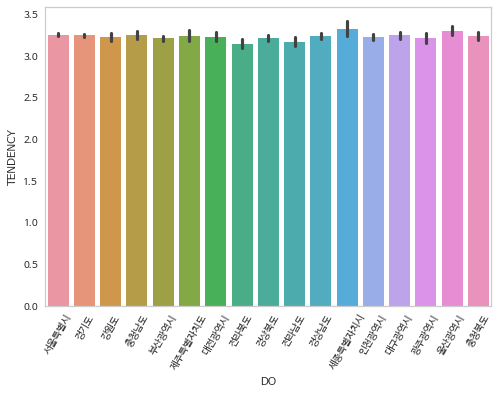

In [ ]:
sns.barplot(x="DO", y="TENDENCY", data=df2)
plt.xticks(rotation=60)
plt.grid(False)
# 주소지 별로 여가 활동 현재 지출 의향

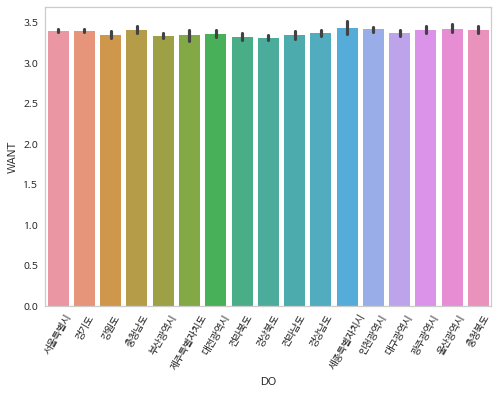

In [ ]:
sns.barplot(x="DO", y="WANT", data=df2)
plt.xticks(rotation=60)
plt.grid(False)
# 주소지 별로 여가 활동 미래 지출 의향

### (5) 소득별 분석
- 소득 수준이 높아질수록 여가활동에 대한 미래 지출 의향이 커지지만, 이 수치가 매우 작아 충분히 의미 있다고 여기기에는 힘들다
- 소득별로 연령대를 나눴을 때, 여가 관련 현재 지출이 가장 많다고 응답한 것은 20대이며 연령대가 높아질 수록 이 수치가 낮아진다.


In [ ]:
df2["MONEY"].value_counts() # 무응답 값은 약 5% 정도로, 그 영향이 크지 않다.

2      11798
1       9737
4       7734
3       7388
무응답     1971
Name: MONEY, dtype: int64

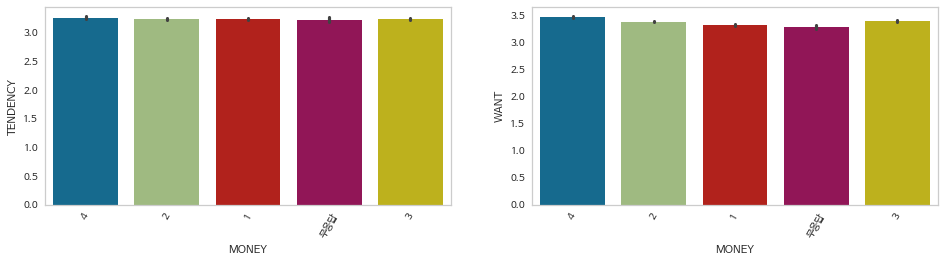

In [ ]:
plt.figure(figsize = (16, 8))

plt.subplot(2, 2, 1)
sns.barplot(x="MONEY", y="TENDENCY", data=df2)
plt.xticks(rotation=60)
plt.grid(False)
# 소득별로 여가 활동 현재 지출 의향

plt.subplot(2, 2, 2)
sns.barplot(x="MONEY", y="WANT", data=df2)
plt.xticks(rotation=60)
plt.grid(False)
# 소득별로 여가 활동 현재 미래 의향

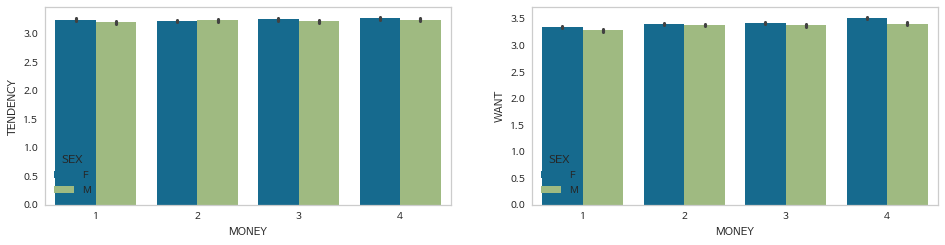

In [ ]:
plt.figure(figsize = (16, 8))

plt.subplot(2, 2, 1)
not_x = df2['MONEY'] != '무응답'
sns.barplot(x="MONEY", y="TENDENCY", hue='SEX', data=df2[not_x]) # 소득 - 성별별로 여가 활동 현재 지출 의향
plt.grid(False)

plt.subplot(2, 2, 2)
not_x = df2['MONEY'] != '무응답'
sns.barplot(x="MONEY", y="WANT", hue='SEX', data=df2[not_x]) # 소득 - 성별별로 여가 활동 미래 지출 의향
plt.grid(False)

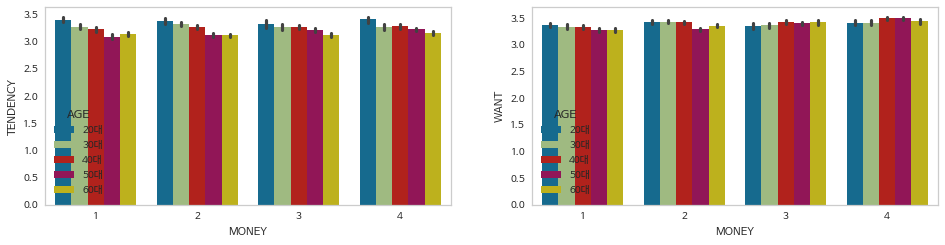

In [ ]:
plt.figure(figsize = (16, 8))

plt.subplot(2, 2, 1)
sns.barplot(x="MONEY", y="TENDENCY", hue='AGE',data=df2[not_x], hue_order = ['20대', '30대', '40대', '50대', '60대']) # 소득 - 연령별로 여가 활동 현재 지출 의향
plt.grid(False)

plt.subplot(2, 2, 2)
sns.barplot(x="MONEY", y="WANT", hue='AGE', data=df2[not_x], hue_order = ['20대', '30대', '40대', '50대', '60대']) # 소득 - 연령별로 여가 활동 미래 지출 의향
plt.grid(False)


### (6) 관심도별 분석
- 어떤 관심도이든 관심 수준이 올라갈 수록, 현재 여가 지출 비용과 미래 여가 지출 희망 비용이 증가한다.
- 따라서 여가 활동에 관심이 많은 사람일 수록 여가 활동에 더 적극적일 것이다.

In [ ]:
import matplotlib.pyplot as plt

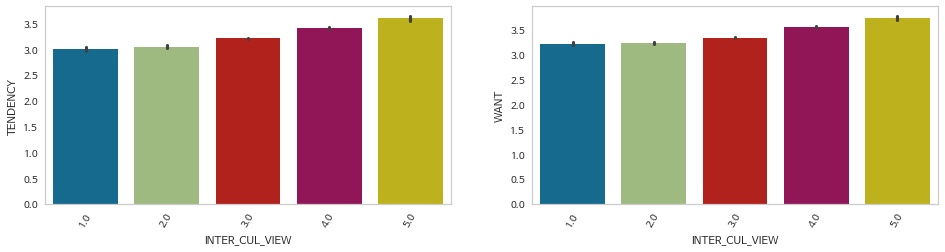

In [ ]:
# 문화예술관람관심정도값
plt.figure(figsize = (16, 8))
plt.subplot(2, 2, 1)
sns.barplot(x="INTER_CUL_VIEW", y="TENDENCY", data=df2)
plt.xticks(rotation=60)
plt.grid(False)

plt.subplot(2, 2, 2)
sns.barplot(x="INTER_CUL_VIEW", y="WANT", data=df2)
plt.xticks(rotation=60)
plt.grid(False)

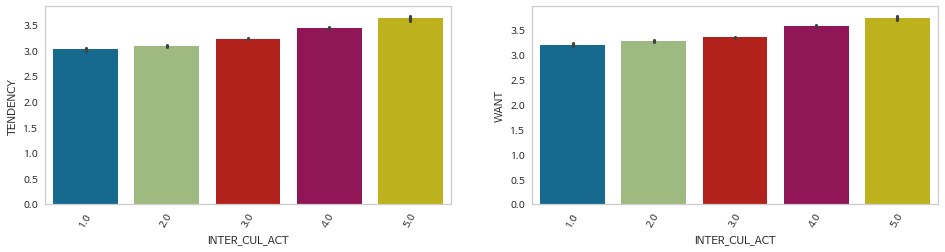

In [ ]:
# 문화예술활동관심정도값
plt.figure(figsize = (16, 8))
plt.subplot(2, 2, 1)
sns.barplot(x="INTER_CUL_ACT", y="TENDENCY", data=df2)
plt.xticks(rotation=60)
plt.grid(False)

plt.subplot(2, 2, 2)
sns.barplot(x="INTER_CUL_ACT", y="WANT", data=df2)
plt.xticks(rotation=60)
plt.grid(False)

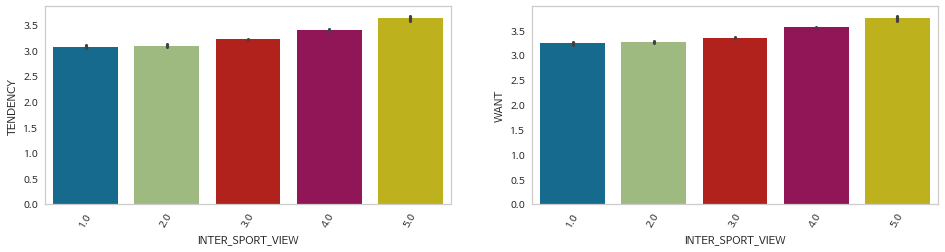

In [ ]:
# 스포츠관람관심정도값
plt.figure(figsize = (16, 8))
plt.subplot(2, 2, 1)
sns.barplot(x="INTER_SPORT_VIEW", y="TENDENCY", data=df2)
plt.xticks(rotation=60)
plt.grid(False)

plt.subplot(2, 2, 2)
sns.barplot(x="INTER_SPORT_VIEW", y="WANT", data=df2)
plt.xticks(rotation=60)
plt.grid(False)

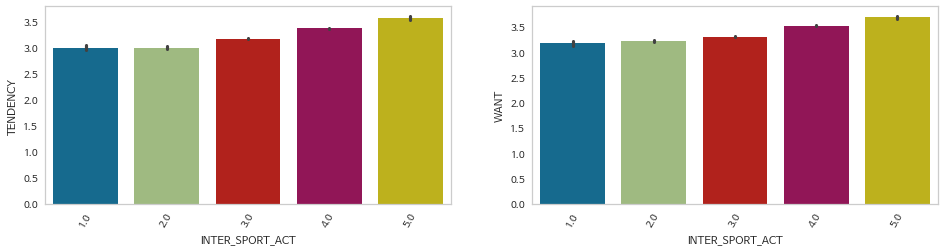

In [ ]:
# 스포츠활동관심정도값
plt.figure(figsize = (16, 8))
plt.subplot(2, 2, 1)
sns.barplot(x="INTER_SPORT_ACT", y="TENDENCY", data=df2)
plt.xticks(rotation=60)
plt.grid(False)

plt.subplot(2, 2, 2)
sns.barplot(x="INTER_SPORT_ACT", y="WANT", data=df2)
plt.xticks(rotation=60)
plt.grid(False)

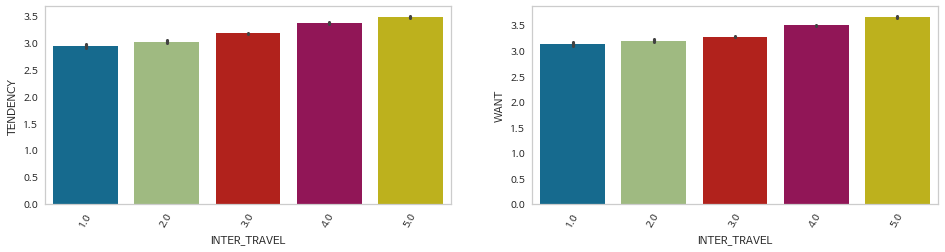

In [ ]:
# 관광여행관심정도값
plt.figure(figsize = (16, 8))
plt.subplot(2, 2, 1)
sns.barplot(x="INTER_TRAVEL", y="TENDENCY", data=df2)
plt.xticks(rotation=60)
plt.grid(False)

plt.subplot(2, 2, 2)
sns.barplot(x="INTER_TRAVEL", y="WANT", data=df2)
plt.xticks(rotation=60)
plt.grid(False)

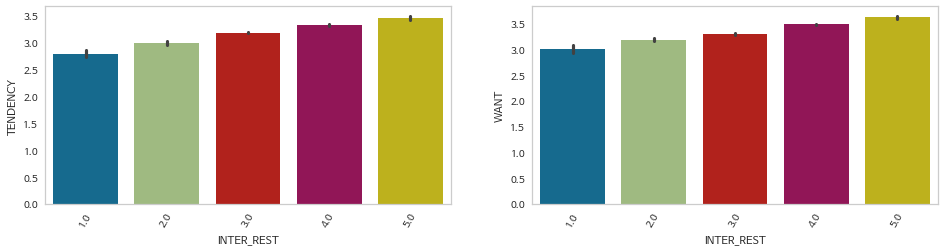

In [ ]:
# 오락휴식관심정도값
plt.figure(figsize = (16, 8))
plt.subplot(2, 2, 1)
sns.barplot(x="INTER_REST", y="TENDENCY", data=df2)
plt.xticks(rotation=60)
plt.grid(False)

plt.subplot(2, 2, 2)
sns.barplot(x="INTER_REST", y="WANT", data=df2)
plt.xticks(rotation=60)
plt.grid(False)

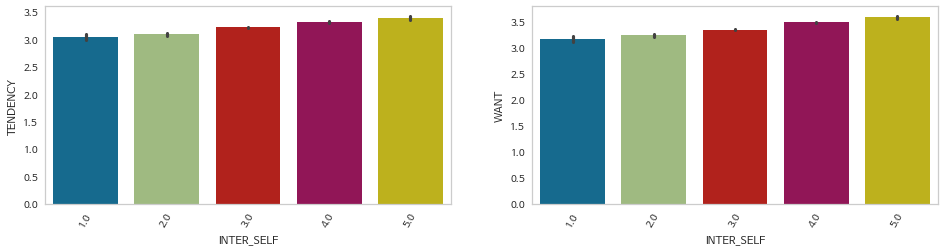

In [ ]:
# 본인계발본인관리관심정도값
plt.figure(figsize = (16, 8))
plt.subplot(2, 2, 1)
sns.barplot(x="INTER_SELF", y="TENDENCY", data=df2)
plt.xticks(rotation=60)
plt.grid(False)

plt.subplot(2, 2, 2)
sns.barplot(x="INTER_SELF", y="WANT", data=df2)
plt.xticks(rotation=60)
plt.grid(False)

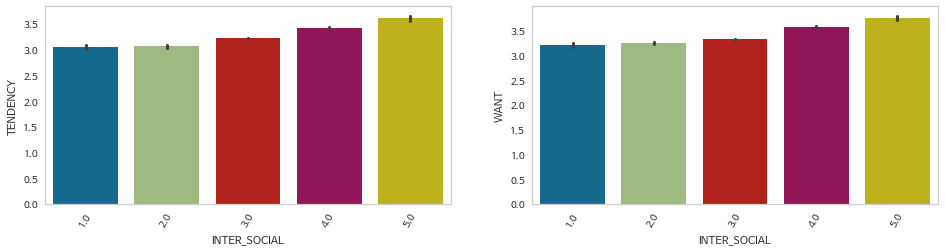

In [ ]:
# 사회교류관심정도값
plt.figure(figsize = (16, 8))
plt.subplot(2, 2, 1)
sns.barplot(x="INTER_SOCIAL", y="TENDENCY", data=df2)
plt.xticks(rotation=60)
plt.grid(False)

plt.subplot(2, 2, 2)
sns.barplot(x="INTER_SOCIAL", y="WANT", data=df2)
plt.xticks(rotation=60)
plt.grid(False)

해당 관심도는 각각 "관심 종류"별로 나눠 설문된 것이다. 따라서 "여가활동" 자체에 대한 평균 관심도를 구할 필요가 있어 새로운 변수를 만들고자 한다.

In [ ]:
df3 = df2.copy() #평균 여가 활동 관심도 변수 추가
df3['INTEREST'] = (df2['INTER_CUL_VIEW'] +df2['INTER_CUL_ACT']+df2['INTER_SPORT_VIEW']+df2['INTER_SPORT_ACT']+df2['INTER_TRAVEL']+df2['INTER_REST']+df2['INTER_SELF']+df2['INTER_SOCIAL'])/8

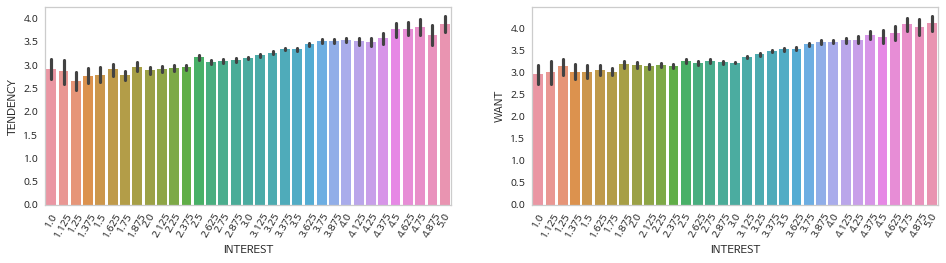

In [ ]:
plt.figure(figsize = (16, 8))
plt.subplot(2, 2, 1)
sns.barplot(x="INTEREST", y="TENDENCY", data=df3)
plt.xticks(rotation=60)
plt.grid(False)
plt.subplot(2, 2, 2)
sns.barplot(x="INTEREST", y="WANT", data=df3)
plt.xticks(rotation=60)
plt.grid(False)

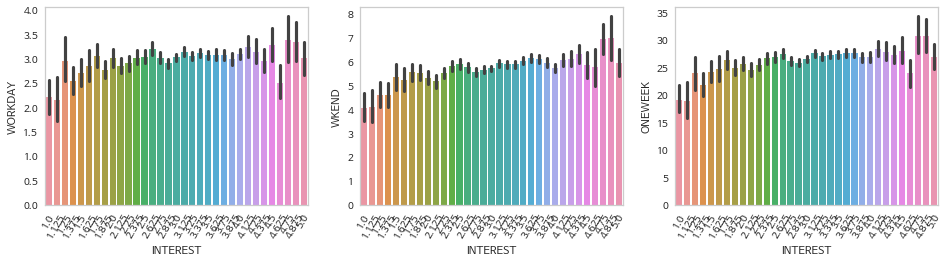

In [ ]:
plt.figure(figsize = (16, 8))
plt.subplot(2, 3, 1)
sns.barplot(x="INTEREST", y="WORKDAY", data=df3)
plt.xticks(rotation=60)
plt.grid(False)
plt.subplot(2, 3, 2)
sns.barplot(x="INTEREST", y="WKEND", data=df3)
plt.xticks(rotation=60)
plt.grid(False)
plt.subplot(2, 3, 3)
sns.barplot(x="INTEREST", y="ONEWEEK", data=df3)
plt.xticks(rotation=60)
plt.grid(False)

## [4] 데이터 분석

상관관계 분석
앞에서 중요하게 여겼던 TENDENCY & WANT와 상관관계가 높은 변수가 있는지 확인한다. (단 상관관계는 주로 상관계수 자체가 선형성의 강도가 얼마나 강한지를 보여주는 수치이기 때문에 직선 형태가 아닐 경우 정확도가 매우 떨어질 수 있음을 유의한다.)

In [ ]:
df_corr = df3.corr()
df_corr

,DATE,TENDENCY,WANT,WORKDAY,WKEND,ONEWEEK,REST,HOBBY,SELF,SOCIAL,ETC,INTER_CUL_VIEW,INTER_CUL_ACT,INTER_SPORT_VIEW,INTER_SPORT_ACT,INTER_TRAVEL,INTER_REST,INTER_SELF,INTER_SOCIAL,INTEREST
DATE,1.000000,0.110066,0.042420,-0.011998,-0.029234,-0.021666,-0.054903,0.036520,-0.002842,0.020318,0.030479,0.116489,0.075278,0.088391,0.079982,0.113211,0.008738,0.000444,0.128437,0.115198
TENDENCY,0.110066,1.000000,0.430579,0.030673,0.077927,0.057047,-0.075508,0.035974,-0.031540,0.079625,0.016678,0.190569,0.178561,0.153073,0.191582,0.207578,0.167961,0.107587,0.176632,0.252889
WANT,0.042420,0.430579,1.000000,-0.014878,0.040947,0.007811,-0.076569,0.023551,-0.002629,0.070452,0.016495,0.184652,0.175595,0.164082,0.190009,0.227114,0.184981,0.144246,0.187783,0.268192
WORKDAY,-0.011998,0.030673,-0.014878,1.000000,0.451156,0.916658,0.038048,-0.022858,0.006269,-0.019518,-0.022045,0.024914,0.023501,0.011364,0.017098,0.006168,0.044166,0.031830,0.008919,0.029616
WKEND,-0.029234,0.077927,0.040947,0.451156,1.000000,0.770241,0.052014,-0.044461,-0.057792,0.034913,-0.020462,0.043739,0.014782,0.023642,0.027864,0.084590,0.101128,0.049061,0.013514,0.065526
ONEWEEK,-0.021666,0.057047,0.007811,0.916658,0.770241,1.000000,0.050484,-0.036246,-0.021402,0.001688,-0.024917,0.037524,0.023466,0.018779,0.024782,0.042526,0.077149,0.044867,0.012467,0.050703
REST,-0.054903,-0.075508,-0.076569,0.038048,0.052014,0.050484,1.000000,-0.497004,-0.379972,-0.415675,-0.199488,-0.085816,-0.117029,-0.086609,-0.173008,-0.051847,0.110728,-0.121680,-0.159683,-0.127592
HOBBY,0.036520,0.035974,0.023551,-0.022858,-0.044461,-0.036246,-0.497004,1.000000,-0.071877,-0.202813,-0.136289,0.061252,0.078191,0.103145,0.229184,0.019598,-0.067056,0.010463,0.030685,0.086709
SELF,-0.002842,-0.031540,-0.002629,0.006269,-0.057792,-0.021402,-0.379972,-0.071877,1.000000,-0.164175,-0.096498,0.062860,0.102033,0.009020,0.019428,-0.024088,-0.051541,0.260771,0.014101,0.069081
SOCIAL,0.020318,0.079625,0.070452,-0.019518,0.034913,0.001688,-0.415675,-0.202813,-0.164175,1.000000,-0.144688,0.031079,0.021074,0.027325,0.001843,0.081498,0.002774,-0.024394,0.199588,0.065146


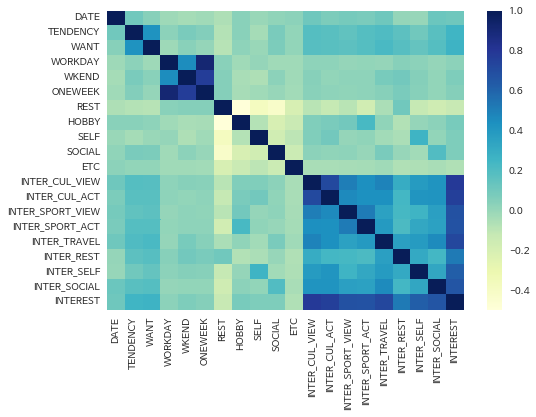

In [ ]:
sns.heatmap(df_corr, cmap="YlGnBu")
plt.show() 
#INTERST 변수는 INTER_ 변수로부터 만들어진 파생변수이므로, 해당 변수들과 상관 관계가 높다.
# WORKDAY, WKEND, ONEWEEK 또한 높은 상관 관계가 있다.
# WANT와 TENDENCY도 상관관계가 높다.

In [ ]:
df_corr["TENDENCY"].sort_values(ascending = False)
# 현재 여가에 얼마나 돈을 지출하는가에 가장 큰 영향을 미치는 것은 WANT이며, 그 뒤로 INTERST가 뒤따른다.

TENDENCY            1.000000
WANT                0.430579
INTEREST            0.252889
INTER_TRAVEL        0.207578
INTER_SPORT_ACT     0.191582
INTER_CUL_VIEW      0.190569
INTER_CUL_ACT       0.178561
INTER_SOCIAL        0.176632
INTER_REST          0.167961
INTER_SPORT_VIEW    0.153073
DATE                0.110066
INTER_SELF          0.107587
SOCIAL              0.079625
WKEND               0.077927
ONEWEEK             0.057047
HOBBY               0.035974
WORKDAY             0.030673
ETC                 0.016678
SELF               -0.031540
REST               -0.075508
Name: TENDENCY, dtype: float64

In [ ]:
df_corr["WANT"].sort_values(ascending = False) #

WANT                1.000000
TENDENCY            0.430579
INTEREST            0.268192
INTER_TRAVEL        0.227114
INTER_SPORT_ACT     0.190009
INTER_SOCIAL        0.187783
INTER_REST          0.184981
INTER_CUL_VIEW      0.184652
INTER_CUL_ACT       0.175595
INTER_SPORT_VIEW    0.164082
INTER_SELF          0.144246
SOCIAL              0.070452
DATE                0.042420
WKEND               0.040947
HOBBY               0.023551
ETC                 0.016495
ONEWEEK             0.007811
SELF               -0.002629
WORKDAY            -0.014878
REST               -0.076569
Name: WANT, dtype: float64

In [ ]:
df_corr["WORKDAY"].sort_values(ascending = False)

WORKDAY             1.000000
ONEWEEK             0.916658
WKEND               0.451156
INTER_REST          0.044166
REST                0.038048
INTER_SELF          0.031830
TENDENCY            0.030673
INTEREST            0.029616
INTER_CUL_VIEW      0.024914
INTER_CUL_ACT       0.023501
INTER_SPORT_ACT     0.017098
INTER_SPORT_VIEW    0.011364
INTER_SOCIAL        0.008919
SELF                0.006269
INTER_TRAVEL        0.006168
DATE               -0.011998
WANT               -0.014878
SOCIAL             -0.019518
ETC                -0.022045
HOBBY              -0.022858
Name: WORKDAY, dtype: float64

In [ ]:
df_corr["WKEND"].sort_values(ascending = False) #REST의 상관관계가 WORKDAY(3.8%)에서 5%로 증가했으나, 그 순위는 낮아졌다.
# 수치가 낮아 유의미하다고 할 수 없지만, WORKDAY에 비해 5~10% 상관계수를 갖고 있는 변수가 증가 했다.

WKEND               1.000000
ONEWEEK             0.770241
WORKDAY             0.451156
INTER_REST          0.101128
INTER_TRAVEL        0.084590
TENDENCY            0.077927
INTEREST            0.065526
REST                0.052014
INTER_SELF          0.049061
INTER_CUL_VIEW      0.043739
WANT                0.040947
SOCIAL              0.034913
INTER_SPORT_ACT     0.027864
INTER_SPORT_VIEW    0.023642
INTER_CUL_ACT       0.014782
INTER_SOCIAL        0.013514
ETC                -0.020462
DATE               -0.029234
HOBBY              -0.044461
SELF               -0.057792
Name: WKEND, dtype: float64

In [ ]:
df_corr["ONEWEEK"].sort_values(ascending = False)

ONEWEEK             1.000000
WORKDAY             0.916658
WKEND               0.770241
INTER_REST          0.077149
TENDENCY            0.057047
INTEREST            0.050703
REST                0.050484
INTER_SELF          0.044867
INTER_TRAVEL        0.042526
INTER_CUL_VIEW      0.037524
INTER_SPORT_ACT     0.024782
INTER_CUL_ACT       0.023466
INTER_SPORT_VIEW    0.018779
INTER_SOCIAL        0.012467
WANT                0.007811
SOCIAL              0.001688
SELF               -0.021402
DATE               -0.021666
ETC                -0.024917
HOBBY              -0.036246
Name: ONEWEEK, dtype: float64

In [ ]:
df_corr["INTEREST"].sort_values(ascending = False)
# INTEREST 변수는 파생변수라 INTER_로 시작하는 변수들의 상관계수가 매우 높다.
# 이 때 문화와 여행 관련 변수가 가장 상관계수가 높고 (70%대), 그 다음으로 SPORT와  SOCIAL (60%대), REST가 가장 낮은 상관계수를 갖고 있다. (50%대)

INTEREST            1.000000
INTER_CUL_VIEW      0.785525
INTER_CUL_ACT       0.760714
INTER_TRAVEL        0.730046
INTER_SPORT_VIEW    0.680360
INTER_SPORT_ACT     0.678278
INTER_SOCIAL        0.664914
INTER_SELF          0.621258
INTER_REST          0.522243
WANT                0.268192
TENDENCY            0.252889
DATE                0.115198
HOBBY               0.086709
SELF                0.069081
WKEND               0.065526
SOCIAL              0.065146
ONEWEEK             0.050703
WORKDAY             0.029616
ETC                -0.059606
REST               -0.127592
Name: INTEREST, dtype: float64

변수 TENDENCY와 WANT 변수에 있어서 INTEREST(여가시간 활동에 대해 관심을 갖는 정도)의 상관계수가 25%로, 약한 양의 상관관계가 있다고 볼 수 있다. 따라서 이후 3가지 변수를 중점적으로 다루고자 한다.

## [5] 모델링

TENDENCY와 WANT의 모델을 구해 어떤 변수가 가장 중요한지 알아낼 필요가 있다.

### (1) 데이터 분리

모델링을 위한 데이터(모델링 & 검증)와 모델을 통해 NAN값을 얻고자 하는 데이터(TENDENCY와 WANT가 NAN인 데이터) 로 분리한다.

In [ ]:
df4 = df3.copy() #문자를 숫자로 대체
df4 = df4.replace({'서울특별시':1, '경기도':2, '인천광역시':3, '대전광역시':4, '부산광역시':5, '경상북도':6, '충청북도':7, '대구광역시':8, '제주특별자치도':9, '강원도':10, '충청남도':11, '전라북도':12, '경상남도':13, '전라남도':14, '광주광역시':15, '울산광역시':16, '세종특별자치시' :17})
df4 = df4.replace({'20대':2, '30대':3, '40대':4, '50대':5,'60대':6})
df4 = df4.replace({'M':1, 'F':2})
df4 # 문자를 숫자로 대체한 데이터 프레임

,RESPOND_ID,DATE,SEX,AGE,DO,MONEY,TENDENCY,WANT,WORKDAY,WKEND,...,ETC,INTER_CUL_VIEW,INTER_CUL_ACT,INTER_SPORT_VIEW,INTER_SPORT_ACT,INTER_TRAVEL,INTER_REST,INTER_SELF,INTER_SOCIAL,INTEREST
0,53322236,20220907,2,4,1,4,2.0,3.0,3,2,...,0,3.0,2.0,3.0,2.0,2.0,4.0,4.0,2.0,2.750
1,53322261,20220907,1,6,1,2,4.0,4.0,3,8,...,25,3.0,3.0,3.0,4.0,3.0,3.0,3.0,2.0,3.000
2,53322315,20220907,2,2,1,4,4.0,3.0,3,6,...,0,2.0,3.0,1.0,3.0,4.0,5.0,2.0,1.0,2.625
3,53322372,20220907,1,3,2,2,3.0,3.0,1,3,...,0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.000
4,53322387,20220907,2,5,1,1,3.0,3.0,2,3,...,0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
38623,3242397,20211124,1,2,2,2,NaN,NaN,2,6,...,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
38624,3243457,20211124,2,3,10,2,NaN,NaN,1,2,...,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
38625,3243663,20211124,2,3,2,2,NaN,NaN,4,18,...,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
38626,3244279,20211124,1,4,12,4,NaN,NaN,3,8,...,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
df_miss = df4[df4['TENDENCY'].isnull()] #TENDENCY와 WANT모두 동일한 행에 동일하게 없기 때문에 변수 하나만 사용한다.
# 모두 7216개인 것을 확인
df_miss

,RESPOND_ID,DATE,SEX,AGE,DO,MONEY,TENDENCY,WANT,WORKDAY,WKEND,...,ETC,INTER_CUL_VIEW,INTER_CUL_ACT,INTER_SPORT_VIEW,INTER_SPORT_ACT,INTER_TRAVEL,INTER_REST,INTER_SELF,INTER_SOCIAL,INTEREST
31412,740,20211208,1,5,6,무응답,NaN,NaN,2,3,...,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
31413,1850,20211208,2,6,12,3,NaN,NaN,4,6,...,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
31414,2217,20211208,1,4,13,1,NaN,NaN,3,3,...,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
31415,2923,20211208,1,5,12,무응답,NaN,NaN,1,5,...,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
31416,3559,20211208,2,5,7,3,NaN,NaN,8,5,...,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
38623,3242397,20211124,1,2,2,2,NaN,NaN,2,6,...,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
38624,3243457,20211124,2,3,10,2,NaN,NaN,1,2,...,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
38625,3243663,20211124,2,3,2,2,NaN,NaN,4,18,...,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
38626,3244279,20211124,1,4,12,4,NaN,NaN,3,8,...,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
df_find = df4.copy() # 모델링을 위한 데이터
df_find['MONEY'] = df_find['MONEY'].replace('무응답', np.nan) #소득 값을 응답하지 않은 경우 약 5% 정도임. 이를 NAN값으로 바꾸어 제거
df_find = df_find.dropna(axis=0) #NAN값을 제거한 모델생성/테스트 프레임
df_find = df_find.drop(['RESPOND_ID', 'DATE'], axis=1) # 필요없는 변수 삭제

In [ ]:
# NAN값을 추측하고자 하는 데이터는 TENDENCY와 WANT 모두 존재 X
df_t = df_find.drop(['WANT'], axis =1) # TENDENCY 예측 위한
df_t = df_t[['TENDENCY', 'SEX', 'AGE', 'DO', 'MONEY', 'WORKDAY', 'WKEND', 'ONEWEEK', # 컬럼 순서 변경
       'REST', 'HOBBY', 'SELF', 'SOCIAL', 'ETC', 
       'INTER_CUL_VIEW','INTER_CUL_ACT', 'INTER_SPORT_VIEW', 'INTER_SPORT_ACT', 'INTER_TRAVEL','INTER_REST', 'INTER_SELF', 'INTER_SOCIAL']]

In [ ]:
df_w = df_find.drop(['TENDENCY'], axis = 1) # WANT 예측 위한
df_w = df_w[['WANT', 'SEX', 'AGE', 'DO', 'MONEY', 'WORKDAY', 'WKEND', 'ONEWEEK', # 컬럼 순서 변경
       'REST', 'HOBBY', 'SELF', 'SOCIAL', 'ETC', 
       'INTER_CUL_VIEW','INTER_CUL_ACT', 'INTER_SPORT_VIEW', 'INTER_SPORT_ACT', 'INTER_TRAVEL','INTER_REST', 'INTER_SELF', 'INTER_SOCIAL']]

### (2) TENDENCY 예측

TENDENCY는  현재 여가에 얼마나 지출을 하고 있는지를 5점 척도로 나타낸 값이다.

In [ ]:
df_t

,TENDENCY,SEX,AGE,DO,MONEY,WORKDAY,WKEND,ONEWEEK,REST,HOBBY,...,SOCIAL,ETC,INTER_CUL_VIEW,INTER_CUL_ACT,INTER_SPORT_VIEW,INTER_SPORT_ACT,INTER_TRAVEL,INTER_REST,INTER_SELF,INTER_SOCIAL
0,2.0,2,4,1,4.0,3,2,19,30,0,...,20,0,3.0,2.0,3.0,2.0,2.0,4.0,4.0,2.0
1,4.0,1,6,1,2.0,3,8,31,10,50,...,5,25,3.0,3.0,3.0,4.0,3.0,3.0,3.0,2.0
2,4.0,2,2,1,4.0,3,6,27,70,0,...,30,0,2.0,3.0,1.0,3.0,4.0,5.0,2.0,1.0
3,3.0,1,3,2,2.0,1,3,11,100,0,...,0,0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0
4,3.0,2,5,1,1.0,2,3,16,30,30,...,30,0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
31407,3.0,2,6,1,1.0,2,3,16,30,30,...,10,20,2.0,3.0,3.0,3.0,1.0,3.0,3.0,1.0
31408,2.0,2,6,1,2.0,3,3,21,30,30,...,20,10,2.0,3.0,2.0,3.0,2.0,3.0,3.0,2.0
31409,4.0,2,5,17,3.0,1,2,9,20,30,...,20,0,3.0,4.0,2.0,3.0,4.0,4.0,4.0,3.0
31410,4.0,2,4,6,1.0,5,5,35,40,0,...,60,0,1.0,1.0,3.0,2.0,1.0,3.0,3.0,1.0


#### [1] 의사결정나무 이용

현재 알고 싶은 것은 얼마나 "여가"에 관심을 갖고 있는가와 그렇지 않은가에 대한 여부이다. 따라서 기존의 TENDENCY(1~5점) 척도를 "관심 있음"과 "관심 없음"으로 나눈다. 그 기준점을 나누기 위해 데이터를 분석해본다.

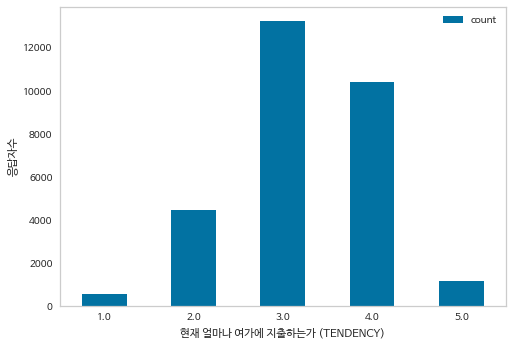

In [ ]:
df_tendency = df_t.groupby('TENDENCY', as_index = False).agg(count = ('TENDENCY', 'count'))
df_tendency.plot.bar(x = 'TENDENCY', y = 'count', rot = 0, xlabel = '현재 얼마나 여가에 지출하는가 (TENDENCY)', ylabel = '응답자수')
plt.grid(False)

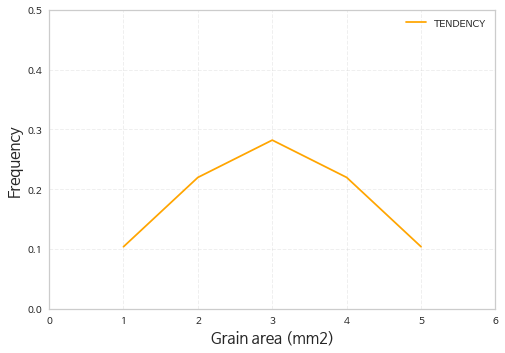

In [ ]:
from pylab import rcParams
import scipy.stats as stats
import numpy as np

t_mean = np.mean(df_tendency["TENDENCY"]) # 평균
t_std = np.std(df_tendency["TENDENCY"]) # 표준편차
t_pdf = stats.norm.pdf(df_tendency["TENDENCY"].sort_values(), t_mean, t_std)
plt.plot(df_tendency['TENDENCY'].sort_values(), t_pdf, color = 'Orange', label = 'TENDENCY')
plt.xlim([0,6])
plt.ylim([0,0.5])
plt.legend()
plt.xlabel("Grain area (mm2)", size=15)
plt.ylabel("Frequency", size=15)
plt.grid(True, alpha=0.3, linestyle="--")
plt.rcParams["figure.figsize"] = [7,5]  # 가로, 세로 인치 조정
plt.rcParams["figure.dpi"] = 100   # 해상도 조정
plt.show()

In [ ]:
# 여가에 관심이 높은 (4, 5) 집단을 "관심 높음(2)"으로, 관심이 낮은 (1, 2, 3) 집단을 "관심 낮음(1)" 집단으로 가정

In [ ]:
tendency={1:'현 지출 낮음',2:'현 지출 낮음',3:'현 지출 낮음',4:'현 지출 높음', 5:'현 지출 높음'}
df_t['TENDENCY2'] = df_t['TENDENCY'].map(tendency)
df_t = df_t.drop(['TENDENCY'], axis=1) # 필요없는 변수 삭제
df_t = df_t[['TENDENCY2', 'SEX', 'AGE', 'DO', 'MONEY', 'WORKDAY', 'WKEND', 'ONEWEEK', # 컬럼 순서 변경
       'REST', 'HOBBY', 'SELF', 'SOCIAL', 'ETC', 
       'INTER_CUL_VIEW','INTER_CUL_ACT', 'INTER_SPORT_VIEW', 'INTER_SPORT_ACT', 'INTER_TRAVEL','INTER_REST', 'INTER_SELF', 'INTER_SOCIAL']]

In [ ]:
df_t

,TENDENCY2,SEX,AGE,DO,MONEY,WORKDAY,WKEND,ONEWEEK,REST,HOBBY,...,SOCIAL,ETC,INTER_CUL_VIEW,INTER_CUL_ACT,INTER_SPORT_VIEW,INTER_SPORT_ACT,INTER_TRAVEL,INTER_REST,INTER_SELF,INTER_SOCIAL
0,현 지출 낮음,2,4,1,4.0,3,2,19,30,0,...,20,0,3.0,2.0,3.0,2.0,2.0,4.0,4.0,2.0
1,현 지출 높음,1,6,1,2.0,3,8,31,10,50,...,5,25,3.0,3.0,3.0,4.0,3.0,3.0,3.0,2.0
2,현 지출 높음,2,2,1,4.0,3,6,27,70,0,...,30,0,2.0,3.0,1.0,3.0,4.0,5.0,2.0,1.0
3,현 지출 낮음,1,3,2,2.0,1,3,11,100,0,...,0,0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0
4,현 지출 낮음,2,5,1,1.0,2,3,16,30,30,...,30,0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
31407,현 지출 낮음,2,6,1,1.0,2,3,16,30,30,...,10,20,2.0,3.0,3.0,3.0,1.0,3.0,3.0,1.0
31408,현 지출 낮음,2,6,1,2.0,3,3,21,30,30,...,20,10,2.0,3.0,2.0,3.0,2.0,3.0,3.0,2.0
31409,현 지출 높음,2,5,17,3.0,1,2,9,20,30,...,20,0,3.0,4.0,2.0,3.0,4.0,4.0,4.0,3.0
31410,현 지출 높음,2,4,6,1.0,5,5,35,40,0,...,60,0,1.0,1.0,3.0,2.0,1.0,3.0,3.0,1.0


In [ ]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split

In [ ]:
X = df_t.iloc[:, 1:]
y = df_t["TENDENCY2"]

# 데이터셋을 학습(train)과 테스트(test) 세트로 분할
# random_state : random 으로 분할시 사용되는 난수 seed 숫자
#X_train, X_test, y_train, y_test = train_test_split(x, y, test_size = 0.2, stratify=y, random_state=42)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state=42)

tree = DecisionTreeClassifier(random_state=0)  

tree.fit(X_train, y_train) #학습한다는 뜻
print("학습용 데이터 정확도: {:.3f}".format(tree.score(X_train, y_train)))
print("시험용 데이터 정확도: {:.3f}".format(tree.score(X_test, y_test)))

학습용 데이터 정확도: 1.000
시험용 데이터 정확도: 0.853


In [ ]:
# 의사결정나무의 깊이를 3로 제한
# 과적합(overfitting): 학습용 데이터에 대해서만 성능이 좋고 새로운 데이터에 적용했을 경우에는 성능이 좋지 않은 경우
tree = DecisionTreeClassifier(max_depth=3, random_state=0)
tree.fit(X_train, y_train)

print("학습용 데이터 정확도: {:.3f}".format(tree.score(X_train, y_train)))
print("시험용 데이터 정확도: {:.3f}".format(tree.score(X_test, y_test)))

학습용 데이터 정확도: 0.652
시험용 데이터 정확도: 0.645


In [ ]:
# 의사결정나무의 깊이를 10로 제한
# 과적합(overfitting): 학습용 데이터에 대해서만 성능이 좋고 새로운 데이터에 적용했을 경우에는 성능이 좋지 않은 경우
tree = DecisionTreeClassifier(max_depth=10, random_state=0)
tree.fit(X_train, y_train)

print("학습용 데이터 정확도: {:.3f}".format(tree.score(X_train, y_train)))
print("시험용 데이터 정확도: {:.3f}".format(tree.score(X_test, y_test)))

학습용 데이터 정확도: 0.733
시험용 데이터 정확도: 0.678


In [ ]:
# 의사결정나무의 깊이를 20로 제한하면 시험용 데이터에 대한 성능이 향상됨 (과적합을 줄임)
# 과적합(overfitting): 학습용 데이터에 대해서만 성능이 좋고 새로운 데이터에 적용했을 경우에는 성능이 좋지 않은 경우
tree = DecisionTreeClassifier(max_depth=20, random_state=0)
tree.fit(X_train, y_train)

print("학습용 데이터 정확도: {:.3f}".format(tree.score(X_train, y_train)))
print("시험용 데이터 정확도: {:.3f}".format(tree.score(X_test, y_test)))

학습용 데이터 정확도: 0.967
시험용 데이터 정확도: 0.830


In [ ]:
# 의사결정나무의 깊이를 30로 제한
# 과적합(overfitting): 학습용 데이터에 대해서만 성능이 좋고 새로운 데이터에 적용했을 경우에는 성능이 좋지 않은 경우
tree = DecisionTreeClassifier(max_depth=30, random_state=0)
tree.fit(X_train, y_train)

print("학습용 데이터 정확도: {:.3f}".format(tree.score(X_train, y_train)))
print("시험용 데이터 정확도: {:.3f}".format(tree.score(X_test, y_test)))

학습용 데이터 정확도: 1.000
시험용 데이터 정확도: 0.852


In [ ]:
#graphviz 라이브러리를 이용하여 의사결정나무 그리기 
from sklearn.tree import export_graphviz
import graphviz

In [ ]:
# filled = True: 색상의 진하기로 클래스를 나타냄, impurity: 불순도 계산값 보여주기 옵션
### export_graphviz(tree(tree 넣어야 함), out_file="tree.dot", class_names=[ (왼쪽)"양성", (오른쪽)"악성"],
###             feature_names=wisc.columns[1:], impurity=False, filled=True)

export_graphviz(tree, out_file="tree.dot", class_names=['현 지출 낮음', '현 지출 높음'],
                feature_names=df_t.columns[1:], impurity=False, filled=True)

with open("tree.dot") as f:
    dot_graph = f.read()

display(graphviz.Source(dot_graph))

In [ ]:
result = tree.feature_importances_
print("변수의 중요도:\n", result)

변수의 중요도:
 [0.02041661 0.04432678 0.08738082 0.04681516 0.04458925 0.07305233
 0.09583072 0.06735775 0.06581736 0.0521662  0.06436473 0.02207452
 0.0335949  0.03748941 0.03968937 0.03402715 0.06473886 0.0326552
 0.03720777 0.03640512]


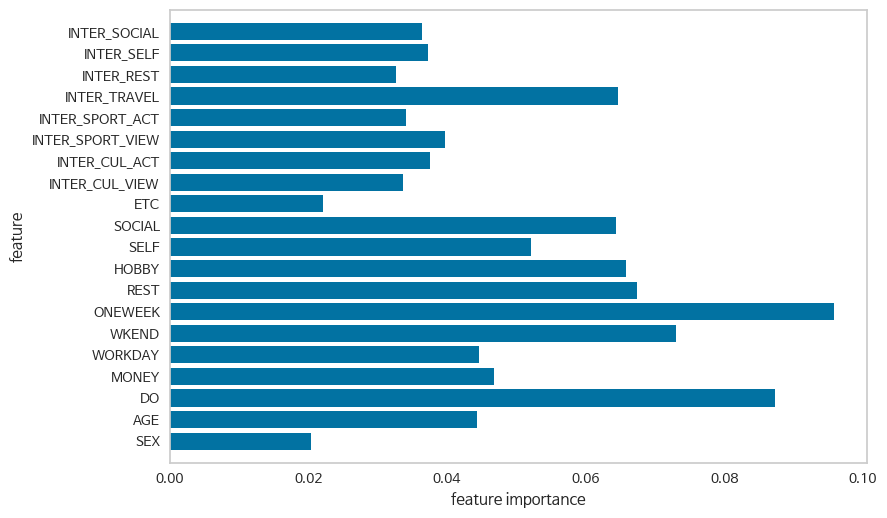

In [ ]:
import numpy as np

def plot_feature_importances_wisc(model):
    plt.rcParams["figure.figsize"] = (9,6)
    n_features = len(df_t.columns[1:])  # 'TENDENCY'를 제외한 나머지'
    plt.barh(np.arange(n_features), model.feature_importances_, align='center') 
    plt.yticks(np.arange(n_features), df_t.columns[1:])   # 눈금을 표시하고 눈금 레이블을 변수 이름으로 지정
    plt.xlabel("feature importance")
    plt.ylabel("feature")
    plt.ylim(-1, n_features) #Y 축 범위 지정
    plt.grid(False)

plot_feature_importances_wisc(tree)

In [ ]:
res = pd.DataFrame(result)
res["name"] = df_t.columns[1:]
display(res.info())

# perimeter_worst의 비중이 가장 큼, 루트 노드에서 이 값부터 사용 
display(res.sort_values(by=0, ascending = False))  

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20 entries, 0 to 19
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   0       20 non-null     float64
 1   name    20 non-null     object 
dtypes: float64(1), object(1)
memory usage: 448.0+ bytes


None

,0,name
6,0.095831,ONEWEEK
2,0.087381,DO
5,0.073052,WKEND
7,0.067358,REST
8,0.065817,HOBBY
16,0.064739,INTER_TRAVEL
10,0.064365,SOCIAL
9,0.052166,SELF
3,0.046815,MONEY
4,0.044589,WORKDAY


#### [2] 랜덤 포레스트 이용

- 의사결정나무를 '랜덤하게' 여러가지로 만들고 이들의 평균을 취하는 방법으로 과적합 문제를 완화시킬 수 있다. 
- 랜덤한 속성을 찾는 방법으로
 * 샘플을 임의로 취하거나 
 * 변수(feature)를 임의로 취한다.
- 평균을 구할 전체 나무의 숫자를 정해준다. (n_estimators) #중요
- 샘플 데이터를 랜덤하게 취하기 위해서 부트스트랩 (Bootstrapping) 샘플링을 한다. (같은 수의 샘플을 취하되 중복 샘플링을 허용하는 방법). 샘플수가 100개면 한번도 샘플링 되지 않는 샘플수가 약 36%정도 된다.
- 몇 개의 변수(feature)를 사용할지도 지정한다. (max_features)
- 변수를 선택하는 작업은 각 노드에서 반복되므로 노드마다 "랜덤하게" 다른 변수를 사용하게 된다.
- 분류의 경우는 확률을 고려한 약한 투표를 하고 (대표값 하나만 투표하지 않고 여러 가능성의 가중평균을 구함), 회귀분석의 경우에는 앙상블의 평균치를 구한다.  

/usr/local/lib/python3.8/dist-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


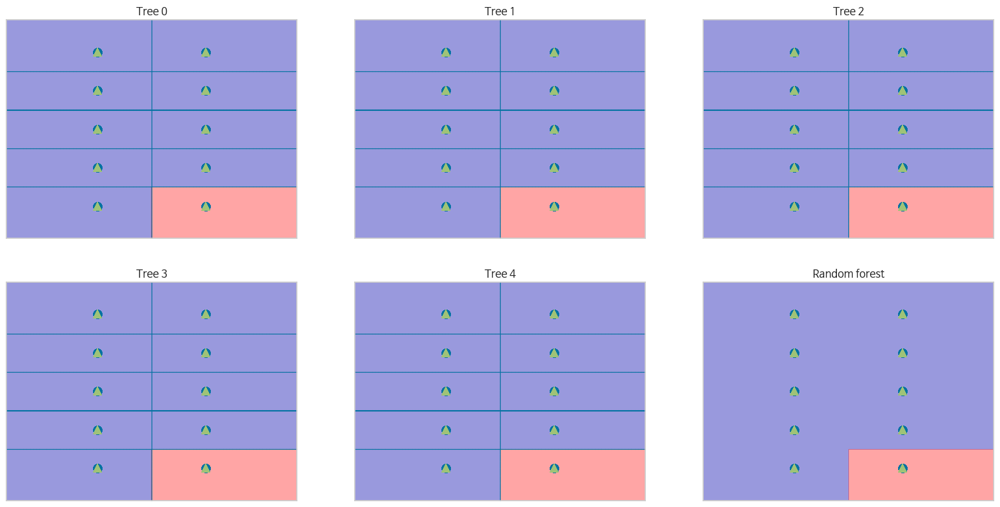

In [ ]:
from sklearn.ensemble import RandomForestClassifier
import mglearn

# radius_mean, texture_mean 변수만 이용하여 
# 5개의 나무를 만드는 예 (n_estimators = 5, 실제는 수백개의 트리를 만든다)
forest = RandomForestClassifier(n_estimators=5, random_state=2)
forest.fit(X_train.iloc[:, 0:2], y_train)

# 5개 나무 각각의 분류 경계를 그림 (서로 모양이 많이 다르다)
# 2차원으로 나무의 결과를 보여주기 위한 코드로 mglearn의 함수들을 이용 - 여기서는 설명 생략
fig, axes = plt.subplots(2, 3, figsize=(20, 10))
for i, (ax, tree) in enumerate(zip(axes.ravel(), forest.estimators_)):
    ax.set_title("Tree {}".format(i))
    mglearn.plots.plot_tree_partition(X.iloc[:, 0:2].values, y, tree, ax=ax)
    
mglearn.plots.plot_2d_separator(forest, X.iloc[:, 0:2].values, fill=True, ax=axes[-1, -1], alpha=.4)
axes[-1, -1].set_title("Random forest")
mglearn.discrete_scatter(X.iloc[:, 0], X.iloc[:, 1], y)
plt.show()

In [ ]:
# 30개 변수를 모두 이용하여 100개의 나무 생성 (정확도가 높아짐)

forest = RandomForestClassifier(n_estimators=100, random_state=0)
forest.fit(X_train, y_train)

print("학습용 데이터 세트 정확도: {:.3f}".format(forest.score(X_train, y_train)))
print("시험용 데이터 세트 정확도: {:.3f}".format(forest.score(X_test, y_test)))

학습용 데이터 세트 정확도: 1.000
시험용 데이터 세트 정확도: 0.877


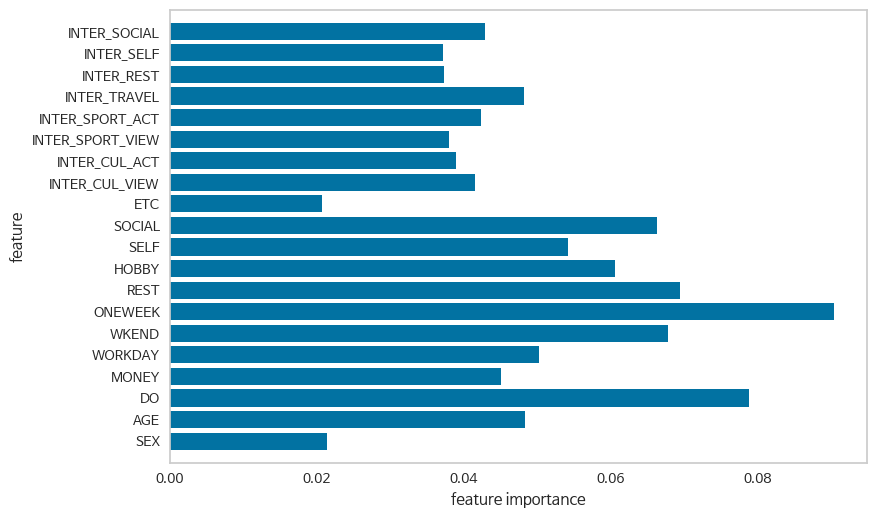

In [ ]:
# 단일 의사결정나무의 경우보다 많은 변수(feature)들이 사용됨
plot_feature_importances_wisc(forest)
plt.grid(False)

#### [3] 그래디언트 부스팅 이용

In [ ]:
from sklearn.ensemble import GradientBoostingClassifier
# 기본값은 max_depth= 3, n_estimators=100, learning_rate = 0.1

gbrt = GradientBoostingClassifier(random_state=0)
gbrt.fit(X_train, y_train)

GradientBoostingClassifier(random_state=0)

In [ ]:
print("학습용 데이터 세트 정확도: {:.3f}".format(gbrt.score(X_train, y_train)))
print("시험용 데이터 세트 정확도: {:.3f}".format(gbrt.score(X_test, y_test)))

학습용 데이터 세트 정확도: 0.693
시험용 데이터 세트 정확도: 0.675


In [ ]:
#학습률 증가
gbrt = GradientBoostingClassifier(random_state=0, learning_rate=0.5)
gbrt.fit(X_train, y_train)

print("학습 데이터 세트 정확도: {:.3f}".format(gbrt.score(X_train, y_train)))
print("시험용 데이터 세트 정확도: {:.3f}".format(gbrt.score(X_test, y_test)))

학습 데이터 세트 정확도: 0.719
시험용 데이터 세트 정확도: 0.677


In [ ]:
#나무 깊이 제한
gbrt = GradientBoostingClassifier(random_state=0, max_depth=10)
gbrt.fit(X_train, y_train)

print("학습 데이터 세트 정확도: {:.3f}".format(gbrt.score(X_train, y_train)))
print("시험용 데이터 세트 정확도: {:.3f}".format(gbrt.score(X_test, y_test)))

학습 데이터 세트 정확도: 0.985
시험용 데이터 세트 정확도: 0.855


#### [4] 검증

##### a. 교차검증

* 최적의 모델(파라미터 선택)을 찾기 위해서는 학습용 데이터(train dataset)를 모델 학습을 위한 데이터와 모델 검증을 위한 데이터로 나누어야 한다.  
* 데이터를 무작위로 한 번만 나누게 되면 분류하기 쉬운 데이터만 학습에 이용될 수도 있고, 반대로 분류하기 어려운 데이터로만 이용할 수도 있다. 학습용 데이터를 나누는 방법에 따라 모델의 정확도 결과가 달라지기 때문에 선택되는 최적의 모델 또한 달라지게 된다.  
* 따라서, 학습용 데이터를 k개 fold로 나눈 후, k-1 folds는 학습에 이용하고 1 fold는 모델 검증에 이용한다. 검증에 사용하는 데이터를 선택하는 방법이 k개 있으므로, k번 검증하고 k개 결과값의 평균을 사용하여 평가한다.   
* 교차 검증은 k가 클수록 연산비용은 늘어나지만, 특정 데이터에만 과적합되는 모델을 만들게 되는 문제를 해결할 있으며 모든 데이터에 일반화가 잘 되었는지 평가할 수 있다.  

In [ ]:
from sklearn.model_selection import cross_val_score

In [ ]:
# 교차 검증을 10번 수행하여 10번의 교차 검증 평균 정확도를 비교 (10-fold cross validation)
# default cv=5

dt_scores = cross_val_score(tree, X_train, y_train, cv=10, scoring='accuracy')  
rf_scores = cross_val_score(forest, X_train, y_train, cv=10, scoring='accuracy')
gbrt_scores = cross_val_score(gbrt, X_train, y_train, cv=10, scoring='accuracy')

print("Accuracy")
print("Decision tree: ", dt_scores) 
print("Random forest: ", rf_scores) 
print("Gradient boosting: ", gbrt_scores) 

print("Accuracy mean")
print("Decision tree :{:.3f}".format(dt_scores.mean())) 
print("Random forest :{:.3f}".format(rf_scores.mean())) 
print("Gradient boosting :{:.3f}".format(gbrt_scores.mean())) 

Accuracy
Decision tree:  [0.81066331 0.82661629 0.82150357 0.82360353 0.82696346 0.81268375
 0.82318354 0.82654347 0.81730365 0.83116338]
Random forest:  [0.83669186 0.86356003 0.85720286 0.86098278 0.85972281 0.85426291
 0.85174297 0.85636287 0.85972281 0.85258295]
Gradient boosting:  [0.83039463 0.84089001 0.84670307 0.84586308 0.82444351 0.83536329
 0.82738345 0.84208316 0.84922302 0.84376312]
Accuracy mean
Decision tree :0.822
Random forest :0.855
Gradient boosting :0.839


In [ ]:
# 교차 검증 상세 옵션 지정

# KFold :기본값 n_splits=5, shuffle=None (데이터를 임의로 섞지 않음) 
# LeaveOneOut :데이터 1개를 검증에 이용 
# ShuffleSplit :임의 분할, 전체 데이터를 모두 사용하지 않을 수도 있음
# GroupKFold :그룹을 지정해서 같은 그룹의 데이터는 학습용 또는 검증용으로 동일하게 분할
# StratifiedKFold :각 fold마다 클래스의 분포가 동일하도록 분할 (예. 악성:양성) 
# RepeatedStratifiedKFold: 교차검증을 반복, 기본값 n_repeats =10

from sklearn.model_selection import StratifiedKFold
kf = StratifiedKFold(n_splits=10)
#from sklearn.model_selection import RepeatedStratifiedKFold
#kf = RepeatedStratifiedKFold(n_splits=10)

print(kf)

dt_scores = cross_val_score(tree, X_train, y_train, cv=kf, scoring='accuracy')  
rf_scores = cross_val_score(forest, X_train, y_train, cv=kf, scoring='accuracy')
gbrt_scores = cross_val_score(gbrt, X_train, y_train, cv=kf, scoring='accuracy')

print("Accuracy mean -- StratifiedKFold 이용")
print("Decision tree :{:.3f}".format(dt_scores.mean())) 
print("Random forest :{:.3f}".format(rf_scores.mean())) 
print("Gradient boosting :{:.3f}".format(gbrt_scores.mean())) 

StratifiedKFold(n_splits=10, random_state=None, shuffle=False)
Accuracy mean -- StratifiedKFold 이용
Decision tree :0.822
Random forest :0.855
Gradient boosting :0.839


##### b. 그리드서치 (그래디언트)

* 최고의 성능을 가지는 모델을 찾기 위해서는 여러 파라미터들을 변경해 보면서 최적의 조합을 찾아야 한다. 
* GridSearchCV를 이용하여 그래디언트 부스팅 모델의 max_depth, learning_rate 값을 순차적으로 변경하면서 최적화를 수행할 수 있다. 

In [ ]:
from sklearn.model_selection import GridSearchCV

# 파라미터를 dictionary 형태로 설정
parameters = {'max_depth':[3, 5, 7, 10,15, 20, 30], 'learning_rate':[0.2, 0.1,0.08, 0.06, 0.04, 0.02]}

In [ ]:
# param_grid의 파라미터들을 3개의 fold 로 나누어 검증
# refit=True (기본값): 가장 좋은 파라미터 설정으로 재학습  
init_gbrt = GradientBoostingClassifier(random_state=0)
grid_gbrt = GridSearchCV(init_gbrt, param_grid=parameters, cv=3, refit=True)
print(grid_gbrt)
# 파라미터들을 순차적으로 학습, 검증
grid_gbrt.fit(X_train, y_train)

# GridSearchCV 결과 추출하여 DataFrame으로 변환
scores_df = pd.DataFrame(grid_gbrt.cv_results_)
scores_df[['params', 'mean_test_score', 'rank_test_score', 'split0_test_score', 'split1_test_score', 'split2_test_score']]

GridSearchCV(cv=3, estimator=GradientBoostingClassifier(random_state=0),
             param_grid={'learning_rate': [0.2, 0.1, 0.08, 0.06, 0.04, 0.02],
                         'max_depth': [3, 5, 7, 10, 15, 20, 30]})


,params,mean_test_score,rank_test_score,split0_test_score,split1_test_score,split2_test_score
0,"{'learning_rate': 0.2, 'max_depth': 3}",0.679615,36,0.678382,0.679602,0.680862
1,"{'learning_rate': 0.2, 'max_depth': 5}",0.703721,30,0.705467,0.701021,0.704674
2,"{'learning_rate': 0.2, 'max_depth': 7}",0.754956,24,0.751449,0.751543,0.761875
3,"{'learning_rate': 0.2, 'max_depth': 10}",0.795565,5,0.792013,0.800302,0.794381
4,"{'learning_rate': 0.2, 'max_depth': 15}",0.799597,2,0.798564,0.798035,0.802192
5,"{'learning_rate': 0.2, 'max_depth': 20}",0.781874,11,0.787226,0.776364,0.782034
6,"{'learning_rate': 0.2, 'max_depth': 30}",0.764027,18,0.764802,0.765403,0.761875
7,"{'learning_rate': 0.1, 'max_depth': 3}",0.676382,37,0.676745,0.678720,0.673680
8,"{'learning_rate': 0.1, 'max_depth': 5}",0.692886,32,0.691862,0.693965,0.692831
9,"{'learning_rate': 0.1, 'max_depth': 7}",0.732572,26,0.734820,0.727353,0.735542


In [ ]:
print('GridSearchCV 최적 파라미터:', grid_gbrt.best_params_) #하나만 알아도 된다.
print('GridSearchCV 최고 정확도: {0:.4f}'.format(grid_gbrt.best_score_))

GridSearchCV 최적 파라미터: {'learning_rate': 0.1, 'max_depth': 15}
GridSearchCV 최고 정확도: 0.8001


In [ ]:
# 최적 파라미터로 학습이 된 모델을 이용하여 시험용 데이터 세트 분류
print("시험용 데이터 세트 정확도: {:.3f}".format(grid_gbrt.score(X_test, y_test)))

시험용 데이터 세트 정확도: 0.874


##### c. 정오분류표

In [ ]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
from sklearn.metrics import confusion_matrix 

print(y_test.value_counts()) # y_test 의 B,M 분포

dt_pred = tree.predict(X_test)
rf_pred = forest.predict(X_test)
grid_gbrt_pred = grid_gbrt.predict(X_test)

# 예측 결과인 pred와 실제 결과인 y_test의 Confusion Matrix 출력
print('Decision tree 시험용 데이터 세트 정확도:{:.3f}'.format(accuracy_score(y_test, dt_pred)))
print(confusion_matrix(y_test, dt_pred))
print('Random forest 시험용 데이터 세트 정확도:{:.3f}'.format(accuracy_score(y_test, rf_pred)))
print(confusion_matrix(y_test, rf_pred))
print('Gradient boosting 시험용 데이터 세트 정확도:{:.3f}'.format(accuracy_score(y_test, grid_gbrt_pred)))
print(confusion_matrix(y_test, grid_gbrt_pred))

현 지출 낮음    3638
현 지출 높음    2315
Name: TENDENCY2, dtype: int64
Decision tree 시험용 데이터 세트 정확도:0.852
[[3185  453]
 [ 428 1887]]
Random forest 시험용 데이터 세트 정확도:0.877
[[3408  230]
 [ 501 1814]]
Gradient boosting 시험용 데이터 세트 정확도:0.874
[[3364  274]
 [ 477 1838]]


In [ ]:
print('gird의 정확도')
print('정밀도:{:.3f}'.format(precision_score (y_test, grid_gbrt_pred, average='binary', pos_label="현 지출 높음")))  # pos_label = 1 기본값
print('TP (49) / TP+FP (52) = {:.3f}'.format(49/52))
print('재현율:{:.3f}'.format(recall_score(y_test, grid_gbrt_pred, average='binary', pos_label="현 지출 높음")))
print('TP (49) / TP+FN (51) = {:.3f}'.format(49/51))
print('f1-measure:{:.3f}'.format(f1_score(y_test, grid_gbrt_pred, average='binary', pos_label="현 지출 높음")))
print('2*(정밀도*재현율)/(정밀도+재현율) = {:.3f}'.format(2*0.942*0.961/(0.942+0.961)))

gird의 정확도
정밀도:0.870
TP (49) / TP+FP (52) = 0.942
재현율:0.794
TP (49) / TP+FN (51) = 0.961
f1-measure:0.830
2*(정밀도*재현율)/(정밀도+재현율) = 0.951


In [ ]:
from sklearn.metrics import classification_report

# 각 클래스가 Positive일 때의 정밀도, 재현율, f1 값을 보여줌 ("관심 높음"이 Postivit인 경우가 기본값임)
# macro avg는 클래스별 점수의 평균을 계산
# weighted avg는 클래스의 샘플 수로 가중평균을 계산
print("Decision Tree:")
print(classification_report(y_test, dt_pred, target_names=["관심 낮음", "관심 높음"]))
print("Random Forest:")
print(classification_report(y_test, rf_pred, target_names=["관심 낮음", "관심 높음"]))
print("Gradient Boosting:")
print(classification_report(y_test, grid_gbrt_pred, target_names=["관심 낮음", "관심 높음"]))

Decision Tree:
              precision    recall  f1-score   support

       관심 낮음       0.88      0.88      0.88      3638
       관심 높음       0.81      0.82      0.81      2315

    accuracy                           0.85      5953
   macro avg       0.84      0.85      0.84      5953
weighted avg       0.85      0.85      0.85      5953

Random Forest:
              precision    recall  f1-score   support

       관심 낮음       0.87      0.94      0.90      3638
       관심 높음       0.89      0.78      0.83      2315

    accuracy                           0.88      5953
   macro avg       0.88      0.86      0.87      5953
weighted avg       0.88      0.88      0.88      5953

Gradient Boosting:
              precision    recall  f1-score   support

       관심 낮음       0.88      0.92      0.90      3638
       관심 높음       0.87      0.79      0.83      2315

    accuracy                           0.87      5953
   macro avg       0.87      0.86      0.86      5953
weighted avg       0.87  

##### d. ROC와 AUT

[[0. 1.]
 [0. 1.]
 [0. 1.]
 ...
 [1. 0.]
 [1. 0.]
 [1. 0.]]


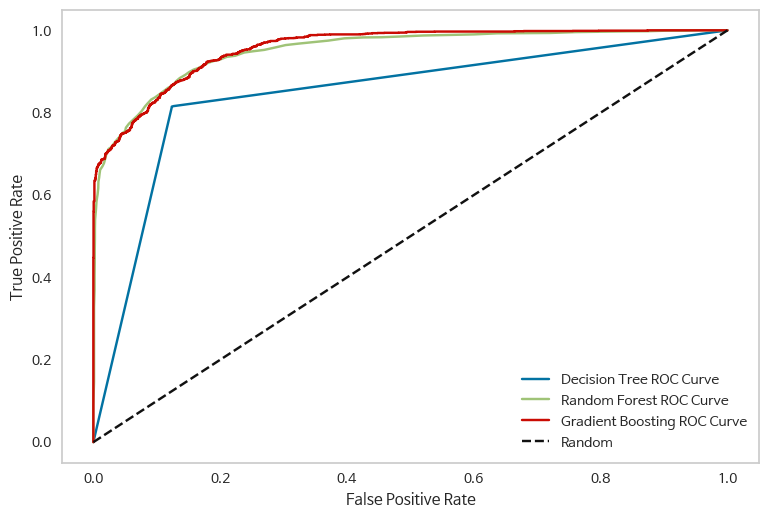

In [ ]:
from sklearn.metrics import roc_auc_score, roc_curve

print(tree.predict_proba(X_test))

fpr_dt, tpr_dt, cutoff_dt = roc_curve(y_test, tree.predict_proba(X_test)[:, 1], pos_label="현 지출 높음")
fpr_rf, tpr_rf, cutoff_rf = roc_curve(y_test, forest.predict_proba(X_test)[:, 1], pos_label="현 지출 높음")
fpr_gbrt, tpr_gbrt, cutoff_gbrt = roc_curve(y_test, grid_gbrt.predict_proba(X_test)[:, 1], pos_label="현 지출 높음")

plt.plot(fpr_dt, tpr_dt, label="Decision Tree ROC Curve")
plt.plot(fpr_rf, tpr_rf, label="Random Forest ROC Curve")
plt.plot(fpr_gbrt, tpr_gbrt, label="Gradient Boosting ROC Curve")
plt.plot([0,1], [0, 1], "k--", label ="Random")

plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")

plt.legend(loc=4)
plt.grid(False)
plt.show() 

In [ ]:
auc_dt = roc_auc_score(y_test, tree.predict_proba(X_test)[:, 1])
auc_rf = roc_auc_score(y_test, forest.predict_proba(X_test)[:, 1])
auc_gbrt = roc_auc_score(y_test, grid_gbrt.predict_proba(X_test)[:, 1])
print("Decision Tree의 AUC: {:.3f}".format(auc_dt))
print("Random Forest의 AUC: {:.3f}".format(auc_rf))
print("Gradient Boosting의 AUC: {:.3f}".format(auc_gbrt)) ## AUC 면적이 가장 큰 모델

Decision Tree의 AUC: 0.846
Random Forest의 AUC: 0.951
Gradient Boosting의 AUC: 0.956


### (3) WANT 예측

#### [1] 의사결정나무 이용

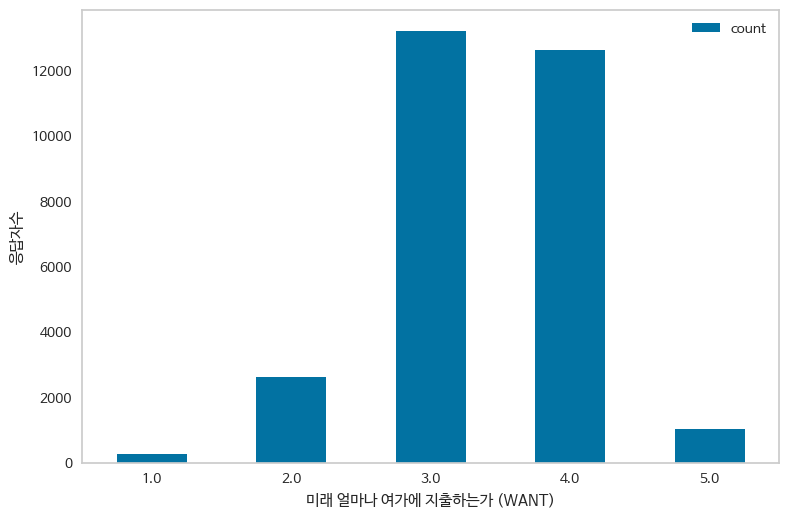

In [ ]:
df_want = df_w.groupby('WANT', as_index = False).agg(count = ('WANT', 'count'))
df_want.plot.bar(x = 'WANT', y = 'count', rot = 0, xlabel = '미래 얼마나 여가에 지출하는가 (WANT)', ylabel = '응답자수')
plt.grid(False)

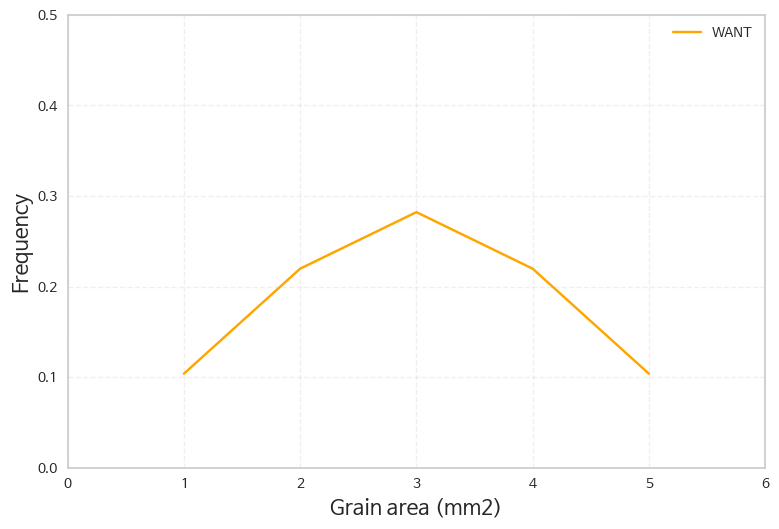

In [ ]:
from pylab import rcParams
import scipy.stats as stats
import numpy as np

t_mean = np.mean(df_want["WANT"]) # 평균
t_std = np.std(df_want["WANT"]) # 표준편차
t_pdf = stats.norm.pdf(df_want["WANT"].sort_values(), t_mean, t_std)
plt.plot(df_want['WANT'].sort_values(), t_pdf, color = 'Orange', label = 'WANT')
plt.xlim([0,6])
plt.ylim([0,0.5])
plt.legend()
plt.xlabel("Grain area (mm2)", size=15)
plt.ylabel("Frequency", size=15)
plt.grid(True, alpha=0.3, linestyle="--")
plt.rcParams["figure.figsize"] = [7,5]  # 가로, 세로 인치 조정
plt.rcParams["figure.dpi"] = 100   # 해상도 조정
plt.show()

In [ ]:
# 여가에 관심이 높은 (4, 5) 집단을 "관심 높음(2)"으로, 관심이 낮은 (1, 2, 3) 집단을 "관심 낮음(1)" 집단으로 가정

In [ ]:
want={1:'미래 지출 낮음',2:'미래 지출 낮음',3:'미래 지출 낮음',4:'미래 지출 높음', 5:'미래 지출 높음'}
df_w['WANT2'] = df_w['WANT'].map(want)
df_w = df_w.drop(['WANT'], axis=1) # 필요없는 변수 삭제
df_w = df_w[['WANT2', 'SEX', 'AGE', 'DO', 'MONEY', 'WORKDAY', 'WKEND', 'ONEWEEK', # 컬럼 순서 변경
       'REST', 'HOBBY', 'SELF', 'SOCIAL', 'ETC', 
       'INTER_CUL_VIEW','INTER_CUL_ACT', 'INTER_SPORT_VIEW', 'INTER_SPORT_ACT', 'INTER_TRAVEL','INTER_REST', 'INTER_SELF', 'INTER_SOCIAL']]

In [ ]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split

In [ ]:
X = df_w.iloc[:, 1:]
y = df_w["WANT2"]

# 데이터셋을 학습(train)과 테스트(test) 세트로 분할
# random_state : random 으로 분할시 사용되는 난수 seed 숫자
#X_train, X_test, y_train, y_test = train_test_split(x, y, test_size = 0.2, stratify=y, random_state=42)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state=42)

tree_w = DecisionTreeClassifier(random_state=0)  

tree_w.fit(X_train, y_train) #학습한다는 뜻
print("학습용 데이터 정확도: {:.3f}".format(tree_w.score(X_train, y_train)))
print("시험용 데이터 정확도: {:.3f}".format(tree_w.score(X_test, y_test)))

학습용 데이터 정확도: 1.000
시험용 데이터 정확도: 0.849


In [ ]:
# 의사결정나무의 깊이를 3로 제한
# 과적합(overfitting): 학습용 데이터에 대해서만 성능이 좋고 새로운 데이터에 적용했을 경우에는 성능이 좋지 않은 경우
tree_w = DecisionTreeClassifier(max_depth=3, random_state=0)
tree_w.fit(X_train, y_train)

print("학습용 데이터 정확도: {:.3f}".format(tree_w.score(X_train, y_train)))
print("시험용 데이터 정확도: {:.3f}".format(tree_w.score(X_test, y_test)))

학습용 데이터 정확도: 0.635
시험용 데이터 정확도: 0.628


In [ ]:
# 의사결정나무의 깊이를 5로 제한
# 과적합(overfitting): 학습용 데이터에 대해서만 성능이 좋고 새로운 데이터에 적용했을 경우에는 성능이 좋지 않은 경우
tree_w = DecisionTreeClassifier(max_depth=5, random_state=0)
tree_w.fit(X_train, y_train)

print("학습용 데이터 정확도: {:.3f}".format(tree_w.score(X_train, y_train)))
print("시험용 데이터 정확도: {:.3f}".format(tree_w.score(X_test, y_test)))

학습용 데이터 정확도: 0.647
시험용 데이터 정확도: 0.623


In [ ]:
# 의사결정나무의 깊이를 10로 제한
# 과적합(overfitting): 학습용 데이터에 대해서만 성능이 좋고 새로운 데이터에 적용했을 경우에는 성능이 좋지 않은 경우
tree_w = DecisionTreeClassifier(max_depth=10, random_state=0)
tree_w.fit(X_train, y_train)

print("학습용 데이터 정확도: {:.3f}".format(tree_w.score(X_train, y_train)))
print("시험용 데이터 정확도: {:.3f}".format(tree_w.score(X_test, y_test)))

학습용 데이터 정확도: 0.731
시험용 데이터 정확도: 0.665


In [ ]:
# 의사결정나무의 깊이를 20로 제한
# 과적합(overfitting): 학습용 데이터에 대해서만 성능이 좋고 새로운 데이터에 적용했을 경우에는 성능이 좋지 않은 경우
tree_w = DecisionTreeClassifier(max_depth=20, random_state=0)
tree_w.fit(X_train, y_train)

print("학습용 데이터 정확도: {:.3f}".format(tree_w.score(X_train, y_train)))
print("시험용 데이터 정확도: {:.3f}".format(tree_w.score(X_test, y_test)))

학습용 데이터 정확도: 0.970
시험용 데이터 정확도: 0.824


In [ ]:
# 의사결정나무의 깊이를 30로 제한
# 과적합(overfitting): 학습용 데이터에 대해서만 성능이 좋고 새로운 데이터에 적용했을 경우에는 성능이 좋지 않은 경우
tree_w = DecisionTreeClassifier(max_depth=30, random_state=0)
tree_w.fit(X_train, y_train)

print("학습용 데이터 정확도: {:.3f}".format(tree_w.score(X_train, y_train)))
print("시험용 데이터 정확도: {:.3f}".format(tree_w.score(X_test, y_test)))

학습용 데이터 정확도: 1.000
시험용 데이터 정확도: 0.849


In [ ]:
#graphviz 라이브러리를 이용하여 의사결정나무 그리기 
from sklearn.tree import export_graphviz
import graphviz

In [ ]:
# filled = True: 색상의 진하기로 클래스를 나타냄, impurity: 불순도 계산값 보여주기 옵션
### export_graphviz(tree(tree 넣어야 함), out_file="tree.dot", class_names=[ (왼쪽)"양성", (오른쪽)"악성"],
###             feature_names=wisc.columns[1:], impurity=False, filled=True)

export_graphviz(tree_w, out_file="tree.dot", class_names=['미래 지출 낮음', '미래 지출 높음'],
                feature_names=df_w.columns[1:], impurity=False, filled=True)

with open("tree.dot") as f:
    dot_graph = f.read()

display(graphviz.Source(dot_graph))

In [ ]:
result_w = tree_w.feature_importances_
print("변수의 중요도:\n", result_w)

변수의 중요도:
 [0.01920779 0.05020259 0.09402558 0.0434397  0.0408804  0.06676637
 0.09661828 0.06812752 0.0605472  0.0540796  0.06336291 0.01888758
 0.03321451 0.031196   0.03622609 0.03387783 0.07724336 0.02886252
 0.04136429 0.04186988]


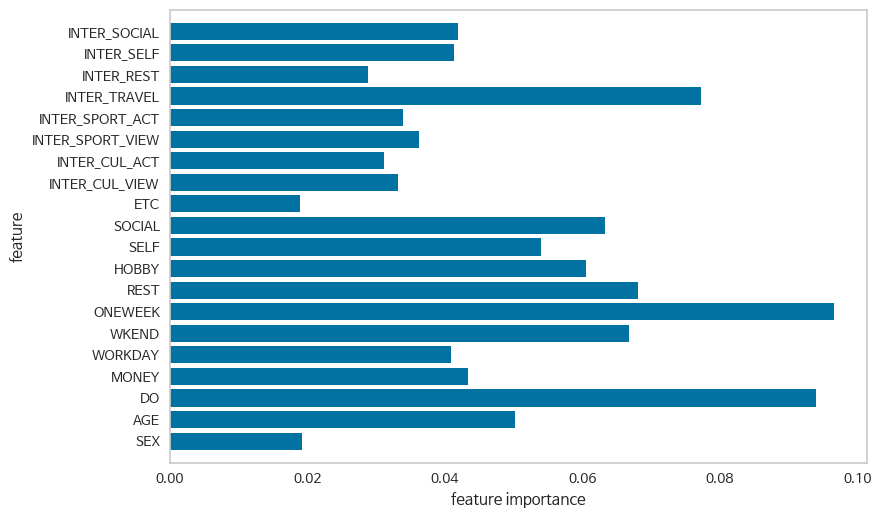

In [ ]:
import numpy as np

def plot_feature_importances_wisc(model):
    plt.rcParams["figure.figsize"] = (9,6)
    n_features = len(df_w.columns[1:])  # 'TENDENCY'를 제외한 나머지'
    plt.barh(np.arange(n_features), model.feature_importances_, align='center') 
    plt.yticks(np.arange(n_features), df_w.columns[1:])   # 눈금을 표시하고 눈금 레이블을 변수 이름으로 지정
    plt.xlabel("feature importance")
    plt.ylabel("feature")
    plt.ylim(-1, n_features) #Y 축 범위 지정
    plt.grid(False)

plot_feature_importances_wisc(tree_w)

In [ ]:
res_w = pd.DataFrame(result_w)
res_w["name"] = df_w.columns[1:]
display(res_w.info())

# perimeter_worst의 비중이 가장 큼, 루트 노드에서 이 값부터 사용 
display(res_w.sort_values(by=0, ascending = False))  

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20 entries, 0 to 19
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   0       20 non-null     float64
 1   name    20 non-null     object 
dtypes: float64(1), object(1)
memory usage: 448.0+ bytes


None

,0,name
6,0.096618,ONEWEEK
2,0.094026,DO
16,0.077243,INTER_TRAVEL
7,0.068128,REST
5,0.066766,WKEND
10,0.063363,SOCIAL
8,0.060547,HOBBY
9,0.054080,SELF
1,0.050203,AGE
3,0.043440,MONEY


#### [2] 랜덤 포레스트 이용

/usr/local/lib/python3.8/dist-packages/sklearn/base.py:450: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


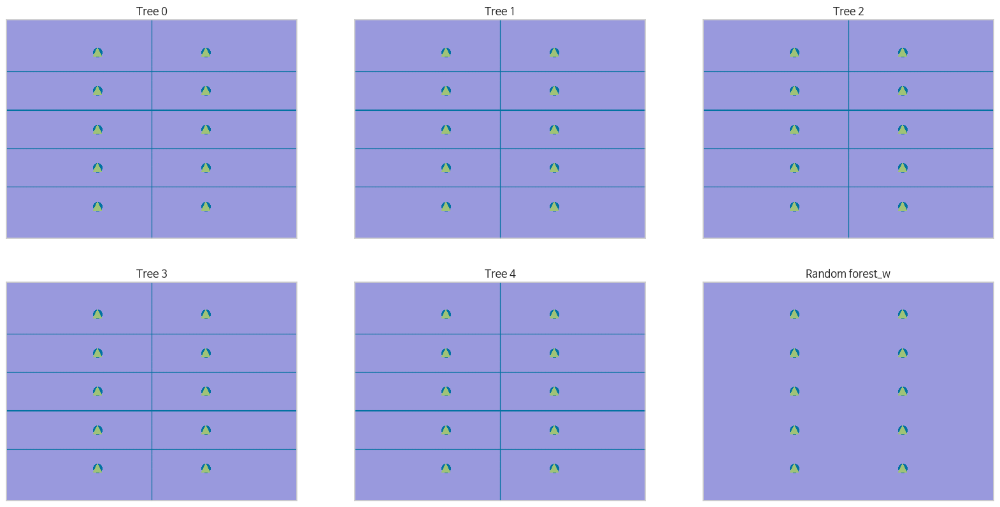

In [ ]:
from sklearn.ensemble import RandomForestClassifier

# radius_mean, texture_mean 변수만 이용하여 
# 5개의 나무를 만드는 예 (n_estimators = 5, 실제는 수백개의 트리를 만든다)
forest_w = RandomForestClassifier(n_estimators=5, random_state=2)
forest_w.fit(X_train.iloc[:, 0:2], y_train)

# 5개 나무 각각의 분류 경계를 그림 (서로 모양이 많이 다르다)
# 2차원으로 나무의 결과를 보여주기 위한 코드로 mglearn의 함수들을 이용 - 여기서는 설명 생략
fig, axes = plt.subplots(2, 3, figsize=(20, 10))
for i, (ax, tree) in enumerate(zip(axes.ravel(), forest_w.estimators_)):
    ax.set_title("Tree {}".format(i))
    mglearn.plots.plot_tree_partition(X.iloc[:, 0:2].values, y, tree, ax=ax)
    
mglearn.plots.plot_2d_separator(forest_w, X.iloc[:, 0:2].values, fill=True, ax=axes[-1, -1], alpha=.4)
axes[-1, -1].set_title("Random forest_w")
mglearn.discrete_scatter(X.iloc[:, 0], X.iloc[:, 1], y)
plt.show()

In [ ]:
# 30개 변수를 모두 이용하여 100개의 나무 생성 (정확도가 높아짐)

forest_w = RandomForestClassifier(n_estimators=100, random_state=0)
forest_w.fit(X_train, y_train)

print("학습용 데이터 세트 정확도: {:.3f}".format(forest_w.score(X_train, y_train)))
print("시험용 데이터 세트 정확도: {:.3f}".format(forest_w.score(X_test, y_test)))

학습용 데이터 세트 정확도: 1.000
시험용 데이터 세트 정확도: 0.867


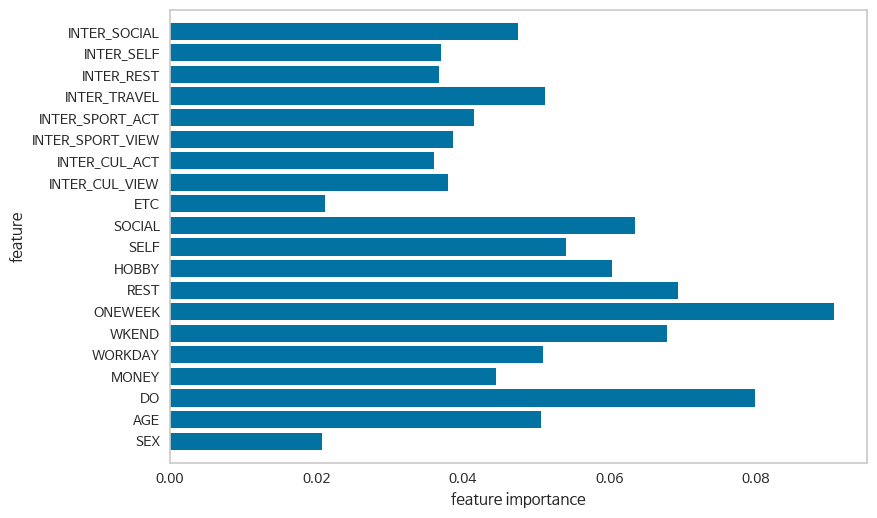

In [ ]:
# 단일 의사결정나무의 경우보다 많은 변수(feature)들이 사용됨
plot_feature_importances_wisc(forest_w)
plt.grid(False)

#### [3] 그래디언트 부스팅 이용

In [ ]:
from sklearn.ensemble import GradientBoostingClassifier
# 기본값은 max_depth= 3, n_estimators=100, learning_rate = 0.1

gbrt_w = GradientBoostingClassifier(random_state=0)
gbrt_w.fit(X_train, y_train)

GradientBoostingClassifier(random_state=0)

In [ ]:
print("학습용 데이터 세트 정확도: {:.3f}".format(gbrt_w.score(X_train, y_train)))
print("시험용 데이터 세트 정확도: {:.3f}".format(gbrt_w.score(X_test, y_test)))

학습용 데이터 세트 정확도: 0.665
시험용 데이터 세트 정확도: 0.642


In [ ]:
#학습률 증가
gbrt_w = GradientBoostingClassifier(random_state=0, learning_rate=0.5)
gbrt_w.fit(X_train, y_train)

print("학습 데이터 세트 정확도: {:.3f}".format(gbrt_w.score(X_train, y_train)))
print("시험용 데이터 세트 정확도: {:.3f}".format(gbrt_w.score(X_test, y_test)))

학습 데이터 세트 정확도: 0.701
시험용 데이터 세트 정확도: 0.656


In [ ]:
#나무 깊이 제한
gbrt_w = GradientBoostingClassifier(random_state=0, max_depth=10)
gbrt_w.fit(X_train, y_train)

print("학습 데이터 세트 정확도: {:.3f}".format(gbrt_w.score(X_train, y_train)))
print("시험용 데이터 세트 정확도: {:.3f}".format(gbrt_w.score(X_test, y_test)))

학습 데이터 세트 정확도: 0.984
시험용 데이터 세트 정확도: 0.846


#### [4] 검증

##### a. 교차검증

In [ ]:
from sklearn.model_selection import cross_val_score

In [ ]:
# 교차 검증을 10번 수행하여 10번의 교차 검증 평균 정확도를 비교 (10-fold cross validation)
# default cv=5

dt_scores_w = cross_val_score(tree_w, X_train, y_train, cv=10, scoring='accuracy')  
rf_scores_w = cross_val_score(forest_w, X_train, y_train, cv=10, scoring='accuracy')
gbrt_scores_w = cross_val_score(gbrt_w, X_train, y_train, cv=10, scoring='accuracy')

print("Accuracy")
print("Decision tree_w: ", dt_scores_w) 
print("Random forest_w: ", rf_scores_w) 
print("Gradient boosting: ", gbrt_scores_w) 

print("Accuracy mean")
print("Decision tree_w :{:.3f}".format(dt_scores_w.mean())) 
print("Random forest_w :{:.3f}".format(rf_scores_w.mean())) 
print("Gradient boosting :{:.3f}".format(gbrt_scores_w.mean())) 

Accuracy
Decision tree_w:  [0.81444165 0.80730479 0.82108358 0.8152037  0.82528349 0.80806384
 0.7950441  0.82108358 0.8202436  0.80428391]
Random forest_w:  [0.84970613 0.85138539 0.85174297 0.84460311 0.84124318 0.83242335
 0.84964301 0.84712306 0.83452331 0.8299034 ]
Gradient boosting:  [0.8240974  0.8240974  0.83200336 0.82780344 0.8248635  0.81814364
 0.8198236  0.82528349 0.82696346 0.82654347]
Accuracy mean
Decision tree_w :0.813
Random forest_w :0.843
Gradient boosting :0.825


In [ ]:
# 교차 검증 상세 옵션 지정

# KFold :기본값 n_splits=5, shuffle=None (데이터를 임의로 섞지 않음) 
# LeaveOneOut :데이터 1개를 검증에 이용 
# ShuffleSplit :임의 분할, 전체 데이터를 모두 사용하지 않을 수도 있음
# GroupKFold :그룹을 지정해서 같은 그룹의 데이터는 학습용 또는 검증용으로 동일하게 분할
# StratifiedKFold :각 fold마다 클래스의 분포가 동일하도록 분할 (예. 악성:양성) 
# RepeatedStratifiedKFold: 교차검증을 반복, 기본값 n_repeats =10

from sklearn.model_selection import StratifiedKFold
kf = StratifiedKFold(n_splits=10)
#from sklearn.model_selection import RepeatedStratifiedKFold
#kf = RepeatedStratifiedKFold(n_splits=10)

print(kf)

dt_scores_w = cross_val_score(tree_w, X_train, y_train, cv=kf, scoring='accuracy')  
rf_scores_w = cross_val_score(forest_w, X_train, y_train, cv=kf, scoring='accuracy')
gbrt_scores_w = cross_val_score(gbrt_w, X_train, y_train, cv=kf, scoring='accuracy')

print("Accuracy mean -- StratifiedKFold 이용")
print("Decision tree_w :{:.3f}".format(dt_scores_w.mean())) 
print("Random forest_w :{:.3f}".format(rf_scores_w.mean())) 
print("Gradient boosting :{:.3f}".format(gbrt_scores_w.mean())) 

StratifiedKFold(n_splits=10, random_state=None, shuffle=False)
Accuracy mean -- StratifiedKFold 이용
Decision tree_w :0.813
Random forest_w :0.843
Gradient boosting :0.825


##### b. 그리드서치 (그래디언트)

최고의 성능을 가지는 모델을 찾기 위해서는 여러 파라미터들을 변경해 보면서 최적의 조합을 찾아야 한다.
GridSearchCV를 이용하여 그래디언트 부스팅 모델의 max_depth, learning_rate 값을 순차적으로 변경하면서 최적화를 수행할 수 있다.

In [ ]:
from sklearn.model_selection import GridSearchCV

# 파라미터를 dictionary 형태로 설정
parameters = {'max_depth':[3, 5, 7, 10,15, 20, 30], 'learning_rate':[0.2, 0.1,0.08, 0.06, 0.04, 0.02]}

In [ ]:
# param_grid의 파라미터들을 3개의 fold 로 나누어 검증
# refit=True (기본값): 가장 좋은 파라미터 설정으로 재학습  
init_gbrt_w = GradientBoostingClassifier(random_state=0)
grid_gbrt_w = GridSearchCV(init_gbrt_w, param_grid=parameters, cv=3, refit=True)
print(grid_gbrt_w)
# 파라미터들을 순차적으로 학습, 검증
grid_gbrt_w.fit(X_train, y_train)

# GridSearchCV 결과 추출하여 DataFrame으로 변환
scores_df = pd.DataFrame(grid_gbrt_w.cv_results_)
scores_df[['params', 'mean_test_score', 'rank_test_score', 'split0_test_score', 'split1_test_score', 'split2_test_score']]

GridSearchCV(cv=3, estimator=GradientBoostingClassifier(random_state=0),
             param_grid={'learning_rate': [0.2, 0.1, 0.08, 0.06, 0.04, 0.02],
                         'max_depth': [3, 5, 7, 10, 15, 20, 30]})


,params,mean_test_score,rank_test_score,split0_test_score,split1_test_score,split2_test_score
0,"{'learning_rate': 0.2, 'max_depth': 3}",0.655384,36,0.658352,0.658057,0.649742
1,"{'learning_rate': 0.2, 'max_depth': 5}",0.685873,30,0.683170,0.688547,0.685901
2,"{'learning_rate': 0.2, 'max_depth': 7}",0.740257,24,0.743008,0.739952,0.737810
3,"{'learning_rate': 0.2, 'max_depth': 10}",0.781833,2,0.778786,0.788711,0.778002
4,"{'learning_rate': 0.2, 'max_depth': 15}",0.784142,1,0.787856,0.782663,0.781908
5,"{'learning_rate': 0.2, 'max_depth': 20}",0.767050,10,0.763165,0.765277,0.772710
6,"{'learning_rate': 0.2, 'max_depth': 30}",0.749622,18,0.750945,0.748394,0.749528
7,"{'learning_rate': 0.1, 'max_depth': 3}",0.652948,38,0.657848,0.654907,0.646088
8,"{'learning_rate': 0.1, 'max_depth': 5}",0.674492,31,0.680524,0.671286,0.671664
9,"{'learning_rate': 0.1, 'max_depth': 7}",0.712666,26,0.711388,0.711478,0.715132


In [ ]:
print('GridSearchCV 최적 파라미터:', grid_gbrt_w.best_params_) #하나만 알아도 된다.
print('GridSearchCV 최고 정확도: {0:.4f}'.format(grid_gbrt_w.best_score_))

GridSearchCV 최적 파라미터: {'learning_rate': 0.2, 'max_depth': 15}
GridSearchCV 최고 정확도: 0.7841


In [ ]:
# 최적 파라미터로 학습이 된 모델을 이용하여 시험용 데이터 세트 분류
print("시험용 데이터 세트 정확도: {:.3f}".format(grid_gbrt_w.score(X_test, y_test)))

시험용 데이터 세트 정확도: 0.865


##### c. 정오분류표

In [ ]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
from sklearn.metrics import confusion_matrix 

print(y_test.value_counts()) # y_test 의 B,M 분포

dt_pred_w = tree_w.predict(X_test)
rf_pred_w = forest_w.predict(X_test)
grid_gbrt_pred_w = grid_gbrt_w.predict(X_test)

# 예측 결과인 pred와 실제 결과인 y_test의 Confusion Matrix 출력
print('Decision tree_w 시험용 데이터 세트 정확도:{:.3f}'.format(accuracy_score(y_test, dt_pred_w)))
print(confusion_matrix(y_test, dt_pred_w))
print('Random forest_w 시험용 데이터 세트 정확도:{:.3f}'.format(accuracy_score(y_test, rf_pred_w)))
print(confusion_matrix(y_test, rf_pred_w))
print('Gradient boosting 시험용 데이터 세트 정확도:{:.3f}'.format(accuracy_score(y_test, grid_gbrt_pred_w)))
print(confusion_matrix(y_test, grid_gbrt_pred_w))

미래 지출 낮음    3208
미래 지출 높음    2745
Name: WANT2, dtype: int64
Decision tree_w 시험용 데이터 세트 정확도:0.849
[[2757  451]
 [ 448 2297]]
Random forest_w 시험용 데이터 세트 정확도:0.867
[[2859  349]
 [ 445 2300]]
Gradient boosting 시험용 데이터 세트 정확도:0.865
[[2830  378]
 [ 425 2320]]


In [ ]:
print('gird의 정확도')
print('정밀도:{:.3f}'.format(precision_score (y_test, grid_gbrt_pred_w, average='binary', pos_label="미래 지출 높음")))  # pos_label = 1 기본값
print('TP (49) / TP+FP (52) = {:.3f}'.format(49/52))
print('재현율:{:.3f}'.format(recall_score(y_test, grid_gbrt_pred_w, average='binary', pos_label="미래 지출 높음")))
print('TP (49) / TP+FN (51) = {:.3f}'.format(49/51))
print('f1-measure:{:.3f}'.format(f1_score(y_test, grid_gbrt_pred_w, average='binary', pos_label="미래 지출 높음")))
print('2*(정밀도*재현율)/(정밀도+재현율) = {:.3f}'.format(2*0.942*0.961/(0.942+0.961)))

gird의 정확도
정밀도:0.860
TP (49) / TP+FP (52) = 0.942
재현율:0.845
TP (49) / TP+FN (51) = 0.961
f1-measure:0.852
2*(정밀도*재현율)/(정밀도+재현율) = 0.951


In [ ]:
from sklearn.metrics import classification_report

# 각 클래스가 Positive일 때의 정밀도, 재현율, f1 값을 보여줌 ("미래 지출 높음"이 Postivit인 경우가 기본값임)
# macro avg는 클래스별 점수의 평균을 계산
# weighted avg는 클래스의 샘플 수로 가중평균을 계산
print("Decision Tree:")
print(classification_report(y_test, dt_pred_w, target_names=["미래 지출 낮음", "미래 지출 높음"]))
print("Random Forest:")
print(classification_report(y_test, rf_pred_w, target_names=["미래 지출 낮음", "미래 지출 높음"]))
print("Gradient Boosting:")
print(classification_report(y_test, grid_gbrt_pred_w, target_names=["미래 지출 낮음", "미래 지출 높음"]))

Decision Tree:
              precision    recall  f1-score   support

    미래 지출 낮음       0.86      0.86      0.86      3208
    미래 지출 높음       0.84      0.84      0.84      2745

    accuracy                           0.85      5953
   macro avg       0.85      0.85      0.85      5953
weighted avg       0.85      0.85      0.85      5953

Random Forest:
              precision    recall  f1-score   support

    미래 지출 낮음       0.87      0.89      0.88      3208
    미래 지출 높음       0.87      0.84      0.85      2745

    accuracy                           0.87      5953
   macro avg       0.87      0.86      0.87      5953
weighted avg       0.87      0.87      0.87      5953

Gradient Boosting:
              precision    recall  f1-score   support

    미래 지출 낮음       0.87      0.88      0.88      3208
    미래 지출 높음       0.86      0.85      0.85      2745

    accuracy                           0.87      5953
   macro avg       0.86      0.86      0.86      5953
weighted avg       0.87  

##### d. ROC와 AUT

[[0. 1.]
 [0. 1.]
 [0. 1.]
 ...
 [1. 0.]
 [1. 0.]
 [1. 0.]]


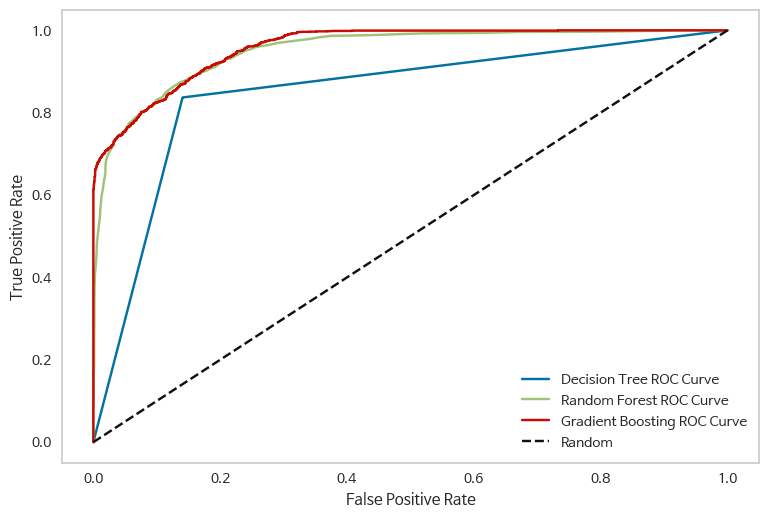

In [ ]:
from sklearn.metrics import roc_auc_score, roc_curve

print(tree_w.predict_proba(X_test))

fpr_dt_w, tpr_dt_w, cutoff_dt_w = roc_curve(y_test, tree_w.predict_proba(X_test)[:, 1], pos_label="미래 지출 높음")
fpr_rf_w, tpr_rf_w, cutoff_rf_w = roc_curve(y_test, forest_w.predict_proba(X_test)[:, 1], pos_label="미래 지출 높음")
fpr_gbrt_w, tpr_gbrt_w, cutoff_gbrt_w = roc_curve(y_test, grid_gbrt_w.predict_proba(X_test)[:, 1], pos_label="미래 지출 높음")

plt.plot(fpr_dt_w, tpr_dt_w, label="Decision Tree ROC Curve")
plt.plot(fpr_rf_w, tpr_rf_w, label="Random Forest ROC Curve")
plt.plot(fpr_gbrt_w, tpr_gbrt_w, label="Gradient Boosting ROC Curve")
plt.plot([0,1], [0, 1], "k--", label ="Random")

plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")

plt.legend(loc=4)
plt.grid(False)
plt.show() 

In [ ]:
auc_dt_w = roc_auc_score(y_test, tree_w.predict_proba(X_test)[:, 1])
auc_rf_w = roc_auc_score(y_test, forest_w.predict_proba(X_test)[:, 1])
auc_gbrt_w = roc_auc_score(y_test, grid_gbrt_w.predict_proba(X_test)[:, 1])
print("Decision Tree의 AUC: {:.3f}".format(auc_dt_w))
print("Random Forest의 AUC: {:.3f}".format(auc_rf_w))
print("Gradient Boosting의 AUC: {:.3f}".format(auc_gbrt_w)) ## AUC 면적이 가장 큰 모델

Decision Tree의 AUC: 0.848
Random Forest의 AUC: 0.950
Gradient Boosting의 AUC: 0.958


## 결론
TENDENCY와 WANT 모두 최종적으로 gradiant boosting 선택

- decision tree 모델의 경우 깊이가 너무 깊어진다는 단점
- confusion matrix에 있어서 random forest와 gradinat boosting이 큰 차이를 보이지 않음
- ROC 를 사용한 면적에 있어서 gradiant가 조금더 면적이 넓었음


변수 중요도가 10%로 낮다는 한계가 있지만 결론적으로 여가에 투자를 하도록 하는 방안은 여가의 시간을 늘리는 것이라고 확인할 수 있음.

##[6] 인사이트 도출##

###(1) 최종결론###





*   국민 체력 측정 데이터\
   : 체중이 높은 집단에게 운동 장려 필요

*   여가 생활 설문 데이터\
   : 여가에 있어서는 절대적인 시간의 양이 중요

\

---



\

**-> 체중이 높은 집단 중,상대적으로 여가에 시간을 더 투자할 가능성이 높은 20대를 타겟으로 마케팅을 진행하는 것이 가장 효과적일 것이라는 결론 도출**


###(2) 마케팅 방안###

**#운린이 탈출 챌린지**



-   운동\
· 평일-생활 속 운동 : 걷기, 자전거 타기, 계단 이용하기\
· 주말-사람들과 함께 하는 운동 : 등산


-   인증 챌린지\
· 생활 속 운동의 경우 웨어러블을 통해 측정된 걸음수, 자전거 이동거리, 층수와 운동하는 모습\
· 사람들과 함께하는 등산의 경우 함께 등반하는 모습\
· SNS에 해시태그 #운린이탈출챌린지 #걷기(운동명) #1일차를 사용하여 인증

- 보상\
·  7일차 : 온라인 운동 클래스 수강권 참여자 전원 제공\
·  14일차 : 설문을 통해 선정된 운동용품 추첨 증정\
·  21일차 : 챌린지 참여자 수 비례한 금액 기부

